## Exploration and data formatting

In [1]:
import numpy as np
import cv2
import os
import glob
import random
import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
from src import utils
from src import plots
from src import transforms

TRAIN_DIR = "/home/biswajit/Documents/bima/unet/data/train/"
TEST_DIR = "/home/biswajit/Documents/bima/unet/data/test/"

In [2]:
image_dirs, image_masks, image_ids = utils.image_mask_paths(TRAIN_DIR)

In [3]:
image_onemask_paths = utils.get_image_onemask_paths(TRAIN_DIR)

In [4]:
len(image_onemask_paths)

670

/home/biswajit/Documents/bima/unet/data/train/f6863b83d75e5927b30e2e326405b588293283c25aaef2251b30c343296b9cb1/images/f6863b83d75e5927b30e2e326405b588293283c25aaef2251b30c343296b9cb1.png


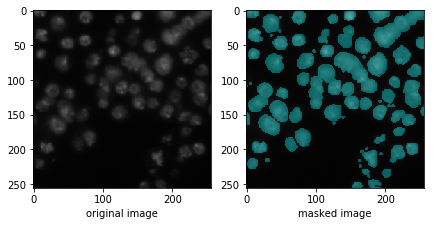

/home/biswajit/Documents/bima/unet/data/train/88d5a03f8ecd459f076a06e0d5035149193bfdd727c30905de19054dcb9018ae/images/88d5a03f8ecd459f076a06e0d5035149193bfdd727c30905de19054dcb9018ae.png


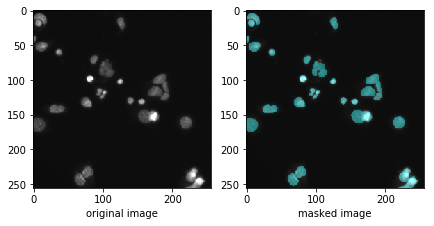

/home/biswajit/Documents/bima/unet/data/train/7f55678298adb736987d9fb5d1d2daefb08fe5bf4d81b2380bedf9449f79cc38/images/7f55678298adb736987d9fb5d1d2daefb08fe5bf4d81b2380bedf9449f79cc38.png


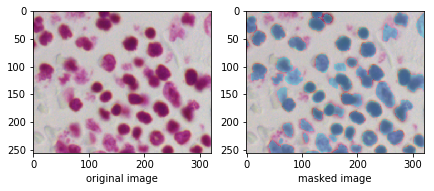

/home/biswajit/Documents/bima/unet/data/train/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d/images/091944f1d2611c916b98c020bd066667e33f4639159b2a92407fe5a40788856d.png


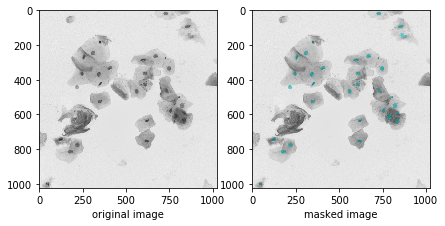

/home/biswajit/Documents/bima/unet/data/train/b4de1e3eec159d8af1bd5447696f8996c31709edaf33e26ba9613816705847db/images/b4de1e3eec159d8af1bd5447696f8996c31709edaf33e26ba9613816705847db.png


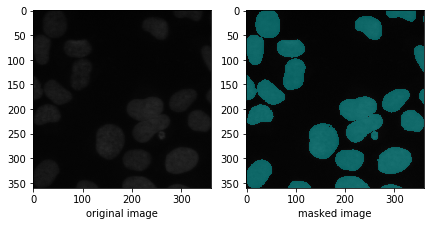

/home/biswajit/Documents/bima/unet/data/train/93cfd412c7de5210bbd262ec3a602cfea65072e9272e9fce9b5339a5b9436eb7/images/93cfd412c7de5210bbd262ec3a602cfea65072e9272e9fce9b5339a5b9436eb7.png


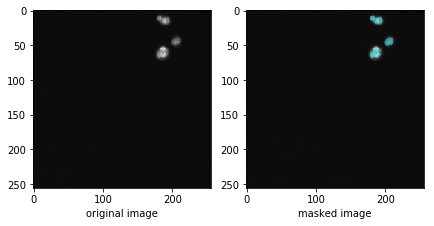

/home/biswajit/Documents/bima/unet/data/train/615985773f1469fbc00915b3e82d1d4942051c09ddea2667e37ad361ed2e9d59/images/615985773f1469fbc00915b3e82d1d4942051c09ddea2667e37ad361ed2e9d59.png


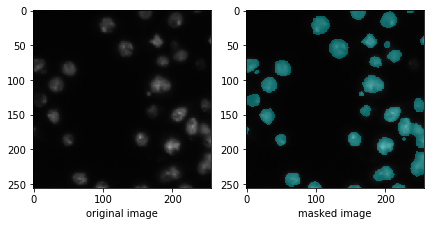

/home/biswajit/Documents/bima/unet/data/train/0acd2c223d300ea55d0546797713851e818e5c697d073b7f4091b96ce0f3d2fe/images/0acd2c223d300ea55d0546797713851e818e5c697d073b7f4091b96ce0f3d2fe.png


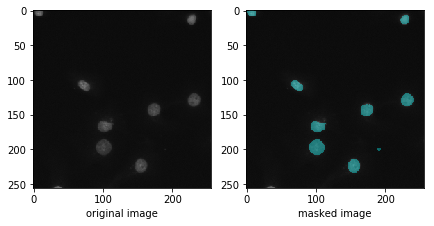

/home/biswajit/Documents/bima/unet/data/train/a6001531274f9ad16e0ced40380f9667b9149558dea7053f7a7db18f5cd028c0/images/a6001531274f9ad16e0ced40380f9667b9149558dea7053f7a7db18f5cd028c0.png


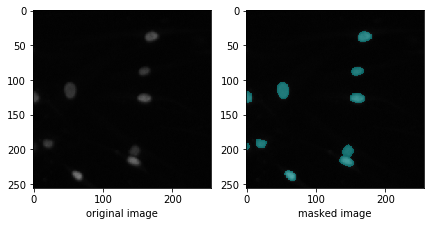

/home/biswajit/Documents/bima/unet/data/train/942d56861fc83e195e9c559a000bb86627d8682f8dcc2300818458e5b6850dd0/images/942d56861fc83e195e9c559a000bb86627d8682f8dcc2300818458e5b6850dd0.png


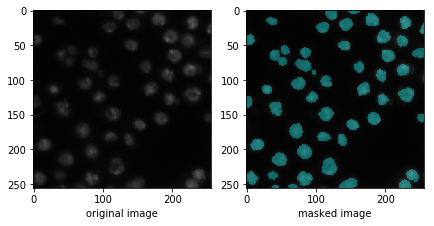

/home/biswajit/Documents/bima/unet/data/train/8d9b4205ddb10fa49a2973b4f3a2dc6923407ae015081e1a52c4b4c2fe8faa53/images/8d9b4205ddb10fa49a2973b4f3a2dc6923407ae015081e1a52c4b4c2fe8faa53.png


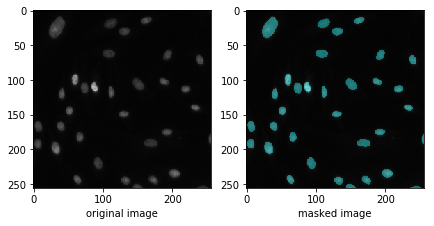

/home/biswajit/Documents/bima/unet/data/train/7af09f98ec299ba0658d759eebc4c34e1c98289ea6ce37f233e9f5e4e2fc84f4/images/7af09f98ec299ba0658d759eebc4c34e1c98289ea6ce37f233e9f5e4e2fc84f4.png


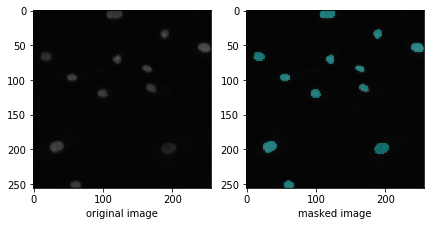

/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/images/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c.png


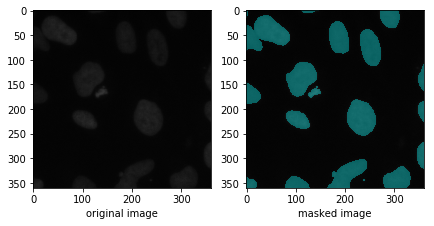

/home/biswajit/Documents/bima/unet/data/train/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607/images/4d14a3629b6af6de86d850be236b833a7bfcbf6d8665fd73c6dc339e06c14607.png


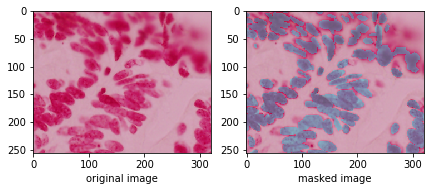

/home/biswajit/Documents/bima/unet/data/train/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6/images/aaa52100fafaa50877e777229cdf6cde7c422f145ff6719449b80631d9a3b0f6.png


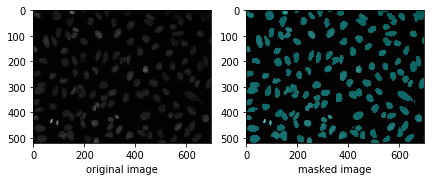

/home/biswajit/Documents/bima/unet/data/train/52a6b8ae4c8e0a8a07a31b8e3f401d8811bf1942969c198e51dfcbd98520aa60/images/52a6b8ae4c8e0a8a07a31b8e3f401d8811bf1942969c198e51dfcbd98520aa60.png


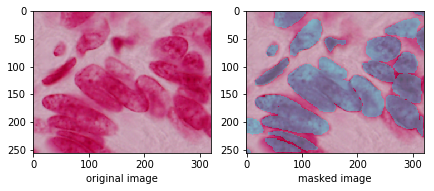

/home/biswajit/Documents/bima/unet/data/train/40946065f7e4b6038599fbfd419f2a67e7635b6f89db3ed6c0d67c8801521af1/images/40946065f7e4b6038599fbfd419f2a67e7635b6f89db3ed6c0d67c8801521af1.png


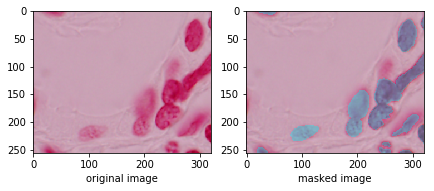

/home/biswajit/Documents/bima/unet/data/train/0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd/images/0402a81e75262469925ea893b6706183832e85324f7b1e08e634129f5d522cdd.png


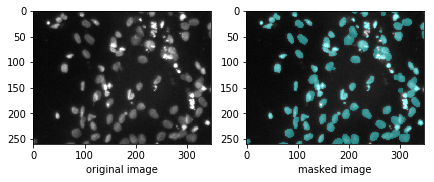

/home/biswajit/Documents/bima/unet/data/train/5c235b945b25b9905b9b0429ce59f1db51d0d0c7d48c2c21ab9f3ca54b0715e6/images/5c235b945b25b9905b9b0429ce59f1db51d0d0c7d48c2c21ab9f3ca54b0715e6.png


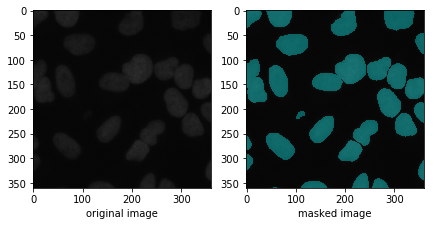

/home/biswajit/Documents/bima/unet/data/train/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5/images/eb1df8ed879d04b36980b0958a0e8fc446ad08c0bdcf3b5f42e3db023187c7e5.png


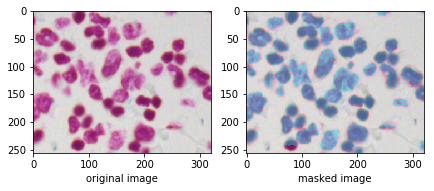

/home/biswajit/Documents/bima/unet/data/train/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e/images/cc88627344305b9a9b07f8bd042cb074c7a834c13de67ff4b24914ac68f07f6e.png


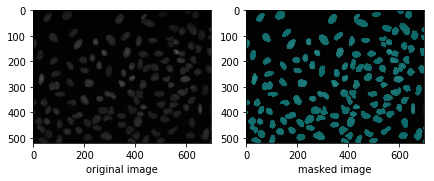

/home/biswajit/Documents/bima/unet/data/train/13f2bec0a24c70345372febb14c4352877b1b6c1b01896246048e83c345c0914/images/13f2bec0a24c70345372febb14c4352877b1b6c1b01896246048e83c345c0914.png


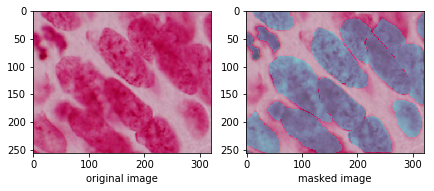

/home/biswajit/Documents/bima/unet/data/train/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e/images/61dc249314d7b965eb4561ec739eab9b0f60af55c97b25ced8cb2a42a0be128e.png


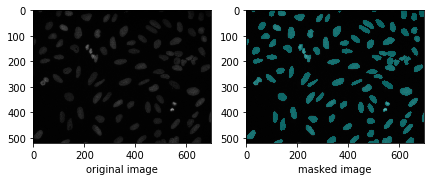

/home/biswajit/Documents/bima/unet/data/train/094afe36759e7daffe12188ab5987581d405b06720f1d5acf3f2614f404df380/images/094afe36759e7daffe12188ab5987581d405b06720f1d5acf3f2614f404df380.png


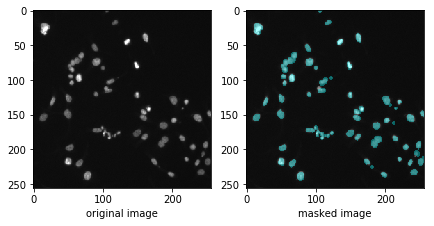

/home/biswajit/Documents/bima/unet/data/train/6c85029f850d392791e13f74963391054ff54e508967bbd091ee510e9e58e011/images/6c85029f850d392791e13f74963391054ff54e508967bbd091ee510e9e58e011.png


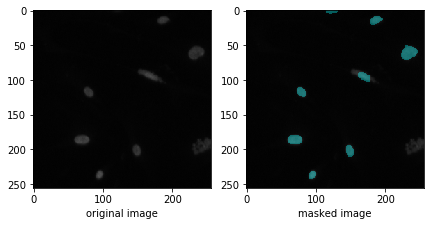

/home/biswajit/Documents/bima/unet/data/train/2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d/images/2f929b067a59f88530b6bfa6f6889bc3a38adf88d594895973d1c8b2549fd93d.png


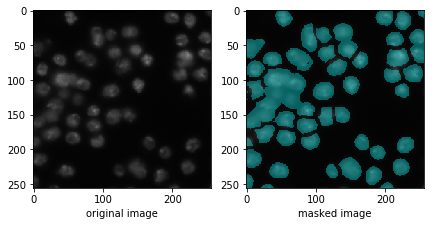

/home/biswajit/Documents/bima/unet/data/train/8a65e41c630d85c0004ce1772ff66fbc87aca34cb165f695255b39343fcfc832/images/8a65e41c630d85c0004ce1772ff66fbc87aca34cb165f695255b39343fcfc832.png


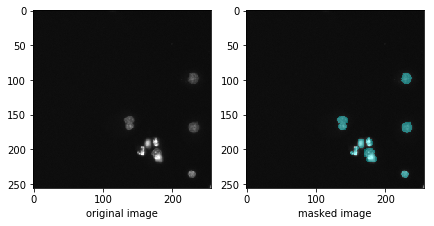

/home/biswajit/Documents/bima/unet/data/train/7b38c9173ebe69b4c6ba7e703c0c27f39305d9b2910f46405993d2ea7a963b80/images/7b38c9173ebe69b4c6ba7e703c0c27f39305d9b2910f46405993d2ea7a963b80.png


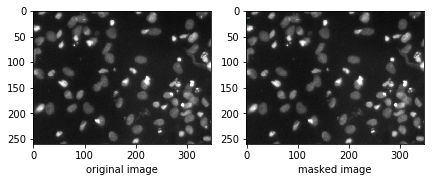

/home/biswajit/Documents/bima/unet/data/train/df9a4212ecb67bb4e58eba62f293b91f9d6f1dde73e38fa891c75661d419fc97/images/df9a4212ecb67bb4e58eba62f293b91f9d6f1dde73e38fa891c75661d419fc97.png


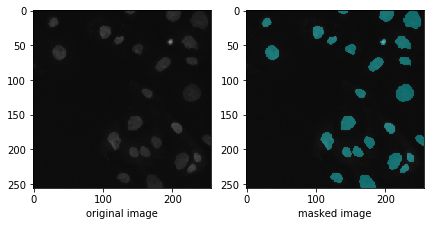

/home/biswajit/Documents/bima/unet/data/train/6aa7dd0c88bec4f96cdd497f9c37779733033d9ec6513307461302d36bd32ac7/images/6aa7dd0c88bec4f96cdd497f9c37779733033d9ec6513307461302d36bd32ac7.png


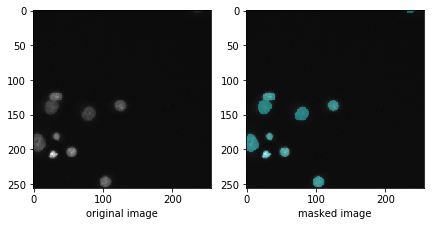

/home/biswajit/Documents/bima/unet/data/train/70827e40a7155391984e56703c6df3392fb4a94bbd6c7008da6a6ca3244965d9/images/70827e40a7155391984e56703c6df3392fb4a94bbd6c7008da6a6ca3244965d9.png


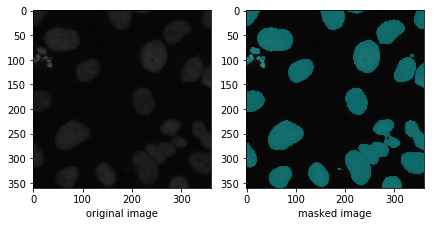

/home/biswajit/Documents/bima/unet/data/train/1a75de9e11303142864efed27e69ea1960dbd82ca910de221a777ed2caf35a6b/images/1a75de9e11303142864efed27e69ea1960dbd82ca910de221a777ed2caf35a6b.png


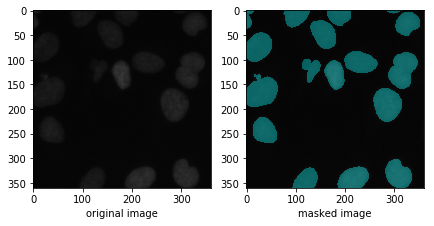

/home/biswajit/Documents/bima/unet/data/train/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e/images/1a11552569160f0b1ea10bedbd628ce6c14f29edec5092034c2309c556df833e.png


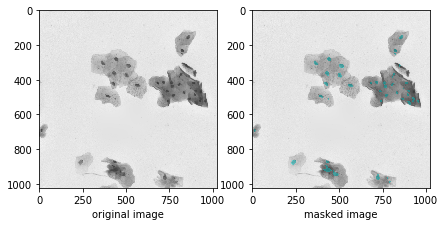

/home/biswajit/Documents/bima/unet/data/train/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28/images/10ba6cbee4873b32d5626a118a339832ba2b15d8643f66dddcd7cb2ec80fbc28.png


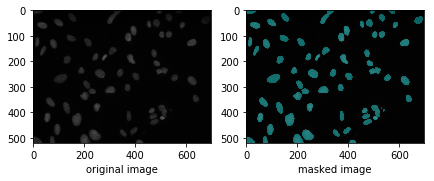

/home/biswajit/Documents/bima/unet/data/train/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed/images/0121d6759c5adb290c8e828fc882f37dfaf3663ec885c663859948c154a443ed.png


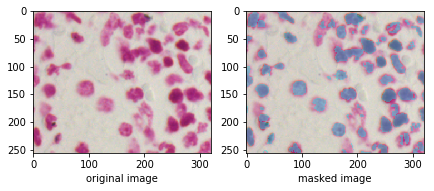

/home/biswajit/Documents/bima/unet/data/train/ae9f76b5360df3f60f3cdd389652b96e823080bb830dd8c79e7f1e597d51bc1c/images/ae9f76b5360df3f60f3cdd389652b96e823080bb830dd8c79e7f1e597d51bc1c.png


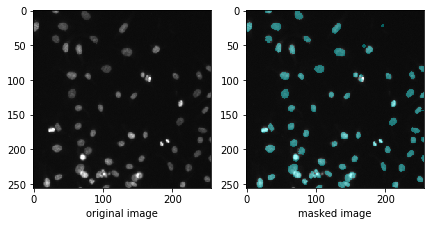

/home/biswajit/Documents/bima/unet/data/train/68f833de9f8c631cedd7031b8ed9b908c42cbbc1e14254722728a8b7d596fd4c/images/68f833de9f8c631cedd7031b8ed9b908c42cbbc1e14254722728a8b7d596fd4c.png


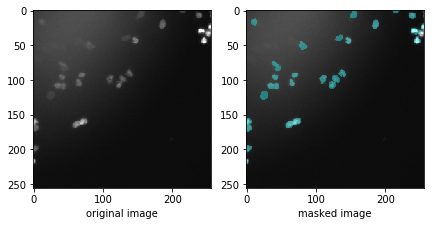

/home/biswajit/Documents/bima/unet/data/train/aa83f5b4fca02ae43a6b9456ab42707b0beabc6e7c5c4e66c0d2572fb80f3615/images/aa83f5b4fca02ae43a6b9456ab42707b0beabc6e7c5c4e66c0d2572fb80f3615.png


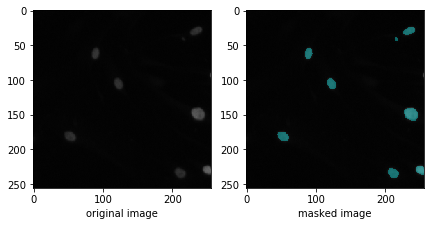

/home/biswajit/Documents/bima/unet/data/train/d8607b21411c9c8ab532faaeba15f8818a92025897950f94ee4da4f74f53660a/images/d8607b21411c9c8ab532faaeba15f8818a92025897950f94ee4da4f74f53660a.png


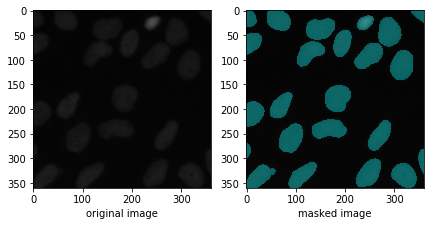

/home/biswajit/Documents/bima/unet/data/train/dec1764c00e8b3c4bf1fc7a2fda341279218ff894186b0c2664128348683c757/images/dec1764c00e8b3c4bf1fc7a2fda341279218ff894186b0c2664128348683c757.png


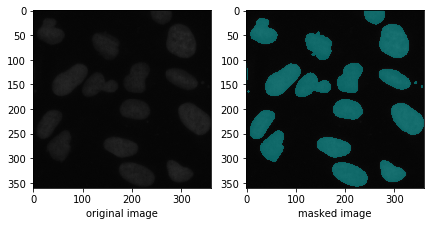

/home/biswajit/Documents/bima/unet/data/train/c0c4a829c8d33d16a02f5dc0411597329f4b4d726ed6a22b5530cf6c8e106c4e/images/c0c4a829c8d33d16a02f5dc0411597329f4b4d726ed6a22b5530cf6c8e106c4e.png


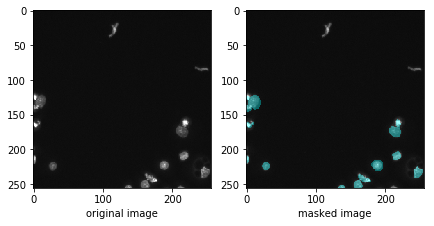

/home/biswajit/Documents/bima/unet/data/train/abbfff07379bceb69dba41dad8b0db5eb80cc8baf3d4af87b7ee20b0dac32215/images/abbfff07379bceb69dba41dad8b0db5eb80cc8baf3d4af87b7ee20b0dac32215.png


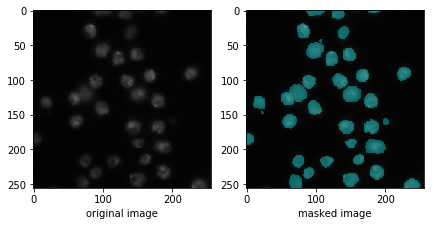

/home/biswajit/Documents/bima/unet/data/train/c0152b1a260e71f9823d17f4fbb4bf7020d5dce62b4a12b3099c1c8e52a1c43a/images/c0152b1a260e71f9823d17f4fbb4bf7020d5dce62b4a12b3099c1c8e52a1c43a.png


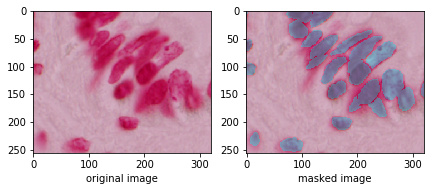

/home/biswajit/Documents/bima/unet/data/train/d3ce382f190ee24729bd2e80684c11bef72bc9c733cdbbc19a17d2c1b2e775f7/images/d3ce382f190ee24729bd2e80684c11bef72bc9c733cdbbc19a17d2c1b2e775f7.png


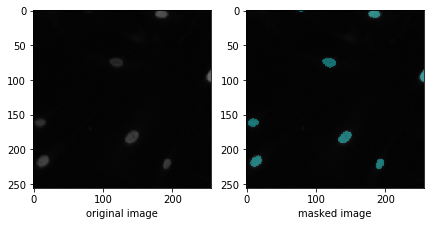

/home/biswajit/Documents/bima/unet/data/train/7798ca1ddb3133563e290c36228bc8f8f3c9f224e096f442ef0653856662d121/images/7798ca1ddb3133563e290c36228bc8f8f3c9f224e096f442ef0653856662d121.png


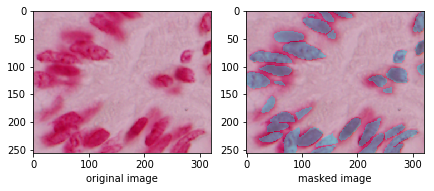

/home/biswajit/Documents/bima/unet/data/train/03f583ec5018739f4abb9b3b4a580ac43bd933c4337ad8877aa18b1dfb59fc9a/images/03f583ec5018739f4abb9b3b4a580ac43bd933c4337ad8877aa18b1dfb59fc9a.png


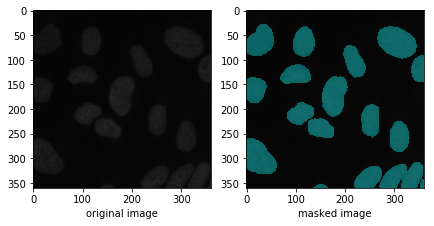

/home/biswajit/Documents/bima/unet/data/train/f7eaaf420b5204c4a42577428b7cd897a53ef07b759ccbba3ed30a3548ca5605/images/f7eaaf420b5204c4a42577428b7cd897a53ef07b759ccbba3ed30a3548ca5605.png


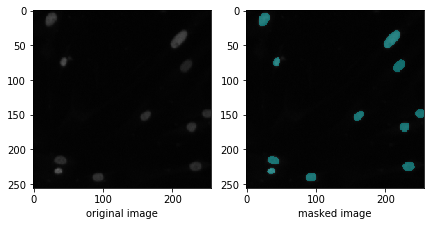

/home/biswajit/Documents/bima/unet/data/train/d910b2b1be8406caecfe31a503d412ffc4e3d488286242ebc7381836121dd4ef/images/d910b2b1be8406caecfe31a503d412ffc4e3d488286242ebc7381836121dd4ef.png


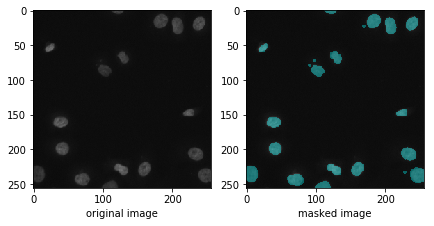

/home/biswajit/Documents/bima/unet/data/train/1bd0f2b3000b7c7723f25335fabfcdddcdf4595dd7de1b142d52bb7a186885f0/images/1bd0f2b3000b7c7723f25335fabfcdddcdf4595dd7de1b142d52bb7a186885f0.png


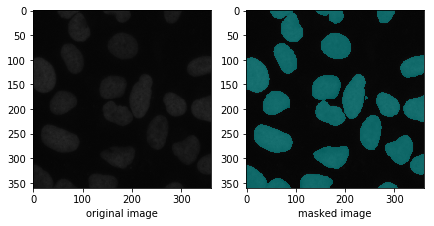

/home/biswajit/Documents/bima/unet/data/train/ff3e512b5fb860e5855d0c05b6cf5a6bcc7792e4be1f0bdab5a00af0e18435c0/images/ff3e512b5fb860e5855d0c05b6cf5a6bcc7792e4be1f0bdab5a00af0e18435c0.png


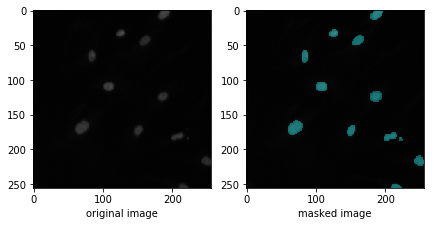

/home/biswajit/Documents/bima/unet/data/train/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629/images/a486f6ed4b8781e7883e433d06a83dd66db3e8b36d45b9976c4214820ee22629.png


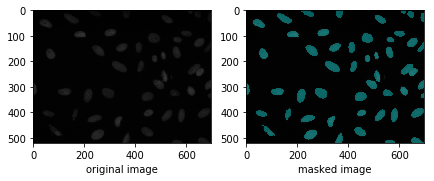

/home/biswajit/Documents/bima/unet/data/train/f26f4c2c70c38fe12e00d5a814d5116691f2ca548908126923fd76ddd665ed24/images/f26f4c2c70c38fe12e00d5a814d5116691f2ca548908126923fd76ddd665ed24.png


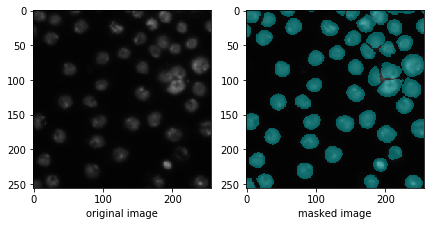

/home/biswajit/Documents/bima/unet/data/train/04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e/images/04acab7636c4cf61d288a5962f15fa456b7bde31a021e5deedfbf51288e4001e.png


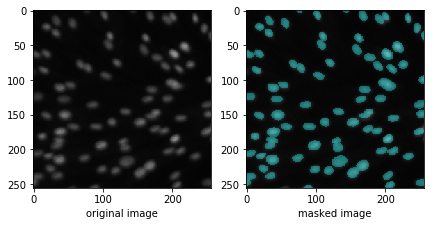

/home/biswajit/Documents/bima/unet/data/train/1023509cf8d4c155467800f89508690be9513431992f470594281cd37dbd020d/images/1023509cf8d4c155467800f89508690be9513431992f470594281cd37dbd020d.png


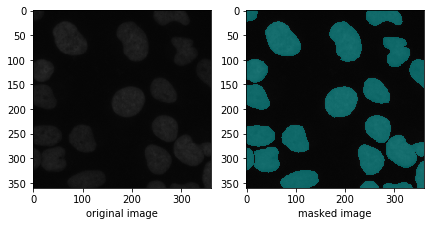

/home/biswajit/Documents/bima/unet/data/train/353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606/images/353ab00e964f71aa720385223a9078b770b7e3efaf5be0f66e670981f68fe606.png


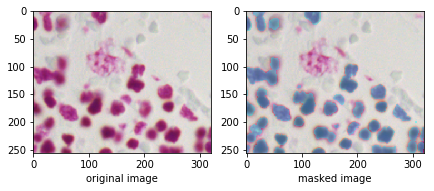

/home/biswajit/Documents/bima/unet/data/train/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066/images/193ffaa5272d5c421ae02130a64d98ad120ec70e4ed97a72cdcd4801ce93b066.png


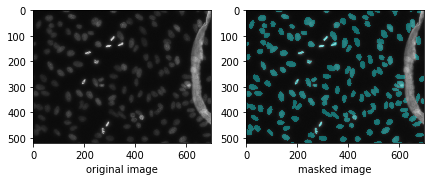

/home/biswajit/Documents/bima/unet/data/train/9facc652efe19f634639585d692a53dd6c2a8e2f0c9baebdfd85b9b41ec58851/images/9facc652efe19f634639585d692a53dd6c2a8e2f0c9baebdfd85b9b41ec58851.png


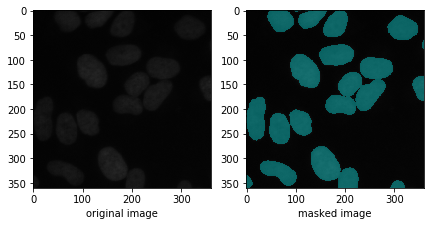

/home/biswajit/Documents/bima/unet/data/train/74a7785530687a11ecd073e772f90912d9967d02407a192bfab282c35f55ab94/images/74a7785530687a11ecd073e772f90912d9967d02407a192bfab282c35f55ab94.png


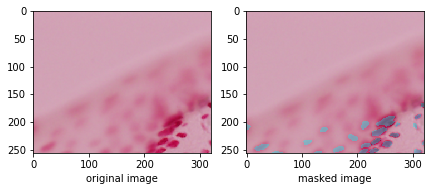

/home/biswajit/Documents/bima/unet/data/train/29780b28e6a75fac7b96f164a1580666513199794f1b19a5df8587fe0cb59b67/images/29780b28e6a75fac7b96f164a1580666513199794f1b19a5df8587fe0cb59b67.png


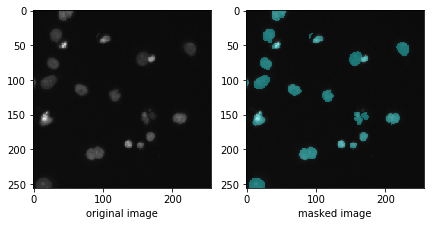

/home/biswajit/Documents/bima/unet/data/train/4829177d0b36abdd92c4ef0c7834cbc49f95232076bdd7e828f1f7cbb5ed80ec/images/4829177d0b36abdd92c4ef0c7834cbc49f95232076bdd7e828f1f7cbb5ed80ec.png


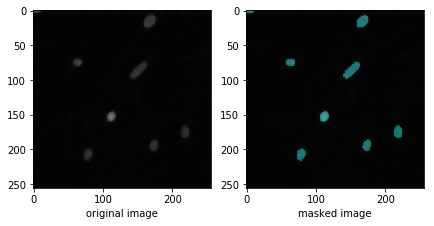

/home/biswajit/Documents/bima/unet/data/train/77ceeb87f560775ac150b8b9b09684ed3e806d0af6f26cce8f10c5fc280f5df2/images/77ceeb87f560775ac150b8b9b09684ed3e806d0af6f26cce8f10c5fc280f5df2.png


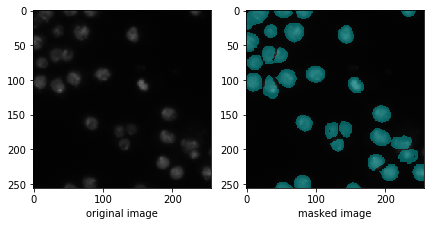

/home/biswajit/Documents/bima/unet/data/train/a101a00fea63f0c43abe5323f4f890bec881eb0caa3bc8498991ff5fd207ed91/images/a101a00fea63f0c43abe5323f4f890bec881eb0caa3bc8498991ff5fd207ed91.png


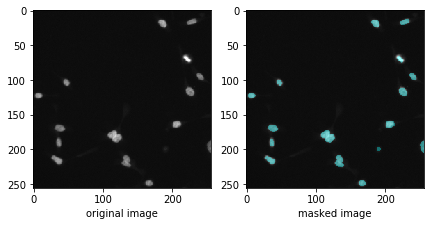

/home/biswajit/Documents/bima/unet/data/train/be1916d0e5592c17f971315b5de720ef6894173087399daed94a52ef109c1572/images/be1916d0e5592c17f971315b5de720ef6894173087399daed94a52ef109c1572.png


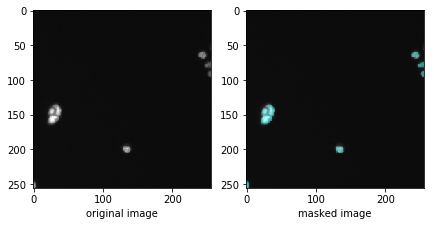

/home/biswajit/Documents/bima/unet/data/train/5419302571113e9aa74c7c0a9575333ca539b871a16c86ee92b35170b4ddc52e/images/5419302571113e9aa74c7c0a9575333ca539b871a16c86ee92b35170b4ddc52e.png


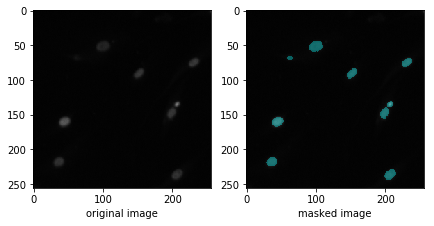

/home/biswajit/Documents/bima/unet/data/train/7ba20aa731cc21af74a8d940254176cbad1bdc44f240b550341c6d9c27509daa/images/7ba20aa731cc21af74a8d940254176cbad1bdc44f240b550341c6d9c27509daa.png


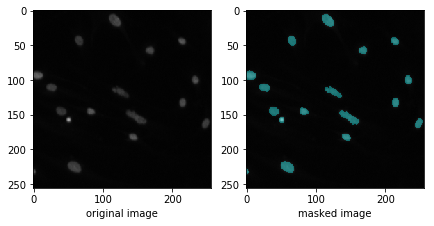

/home/biswajit/Documents/bima/unet/data/train/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40/images/4e07a653352b30bb95b60ebc6c57afbc7215716224af731c51ff8d430788cd40.png


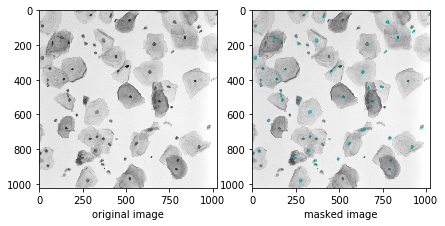

/home/biswajit/Documents/bima/unet/data/train/573e1480b500c395f8d3f1800e1998bf553af0d3d43039333d33cf37d08f64e5/images/573e1480b500c395f8d3f1800e1998bf553af0d3d43039333d33cf37d08f64e5.png


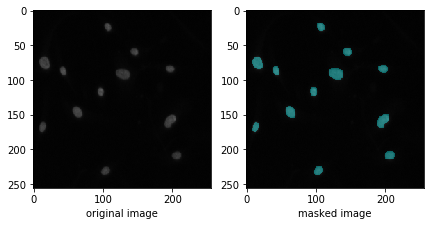

/home/biswajit/Documents/bima/unet/data/train/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2/images/0c2550a23b8a0f29a7575de8c61690d3c31bc897dd5ba66caec201d201a278c2.png


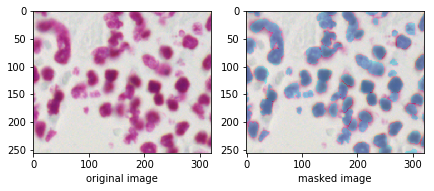

/home/biswajit/Documents/bima/unet/data/train/03398329ced0c23b9ac3fac84dd53a87d9ffe4d9d10f1b5fe8df8fac12380776/images/03398329ced0c23b9ac3fac84dd53a87d9ffe4d9d10f1b5fe8df8fac12380776.png


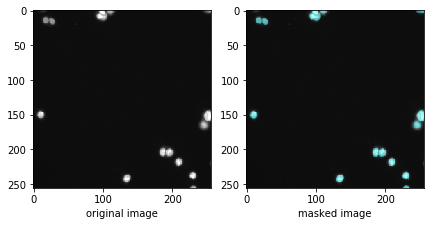

/home/biswajit/Documents/bima/unet/data/train/b3a9f4c9035a0df7e033b18c63bfb0f0d87ff5a4d9aa8bdf417159bb733abb80/images/b3a9f4c9035a0df7e033b18c63bfb0f0d87ff5a4d9aa8bdf417159bb733abb80.png


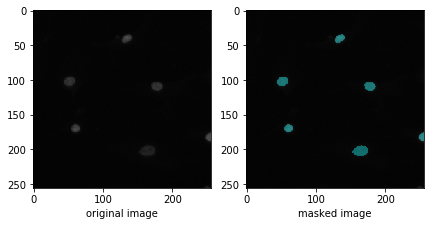

/home/biswajit/Documents/bima/unet/data/train/f7e5dcfc9c93183c668c5a4ab028d5faad54fb54298711f2caae0508aa978300/images/f7e5dcfc9c93183c668c5a4ab028d5faad54fb54298711f2caae0508aa978300.png


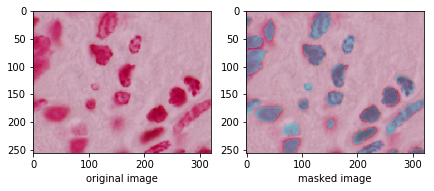

/home/biswajit/Documents/bima/unet/data/train/8e8a7a14749d0b2e48de3d10e2e80063f17b165ad921c8afc0623f08500f3259/images/8e8a7a14749d0b2e48de3d10e2e80063f17b165ad921c8afc0623f08500f3259.png


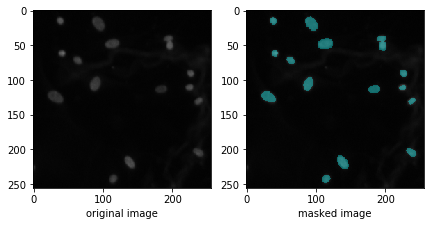

/home/biswajit/Documents/bima/unet/data/train/f0a75e0322f11cead4219aa530673fe5eef67580fb6fccc254963c9fc6b58aa1/images/f0a75e0322f11cead4219aa530673fe5eef67580fb6fccc254963c9fc6b58aa1.png


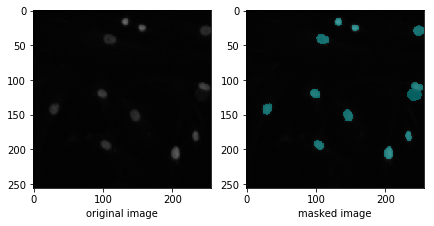

/home/biswajit/Documents/bima/unet/data/train/a1f50f101bc471e2d6967ebdb8ba81150588609e769f3b960f0801e4da5fdc6f/images/a1f50f101bc471e2d6967ebdb8ba81150588609e769f3b960f0801e4da5fdc6f.png


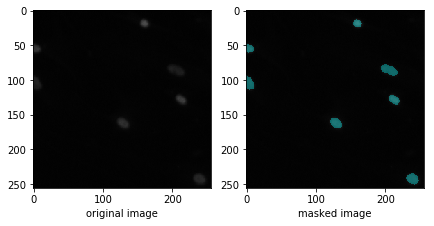

/home/biswajit/Documents/bima/unet/data/train/f6cb37ebf29c225284c8415962f7287abe7007fae8fe3d8a3899b608b832d7d5/images/f6cb37ebf29c225284c8415962f7287abe7007fae8fe3d8a3899b608b832d7d5.png


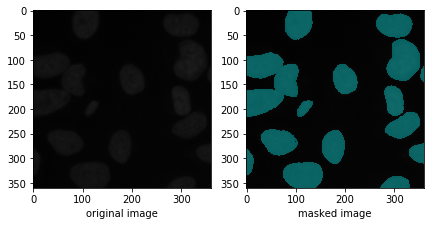

/home/biswajit/Documents/bima/unet/data/train/c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f/images/c04fa1a74a980d790ba6f3e595fd9851f14370bb71c7cbb7846c33ca9d72687f.png


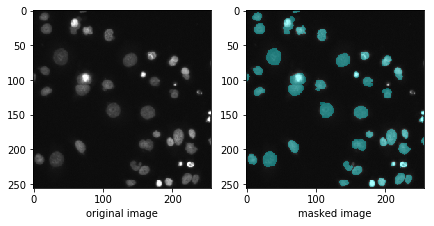

/home/biswajit/Documents/bima/unet/data/train/e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c/images/e414b54f2036bcab61b9c0a966f65adf4b169097c13c740e03d6292ac076258c.png


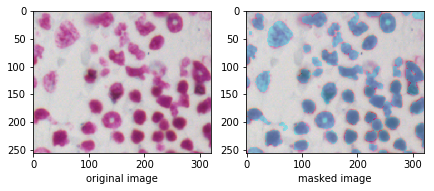

/home/biswajit/Documents/bima/unet/data/train/2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25/images/2c83c86dd4e5dacc024b55629375567fb8e320a82ef86f541cfe54764040fc25.png


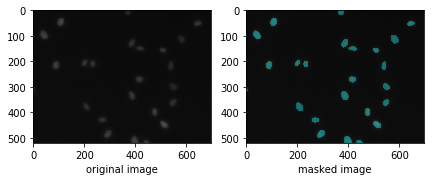

/home/biswajit/Documents/bima/unet/data/train/f9ac03b0344ce8c48bc058448541f9211a1e5f4c94fdaf633dd534328d8610ab/images/f9ac03b0344ce8c48bc058448541f9211a1e5f4c94fdaf633dd534328d8610ab.png


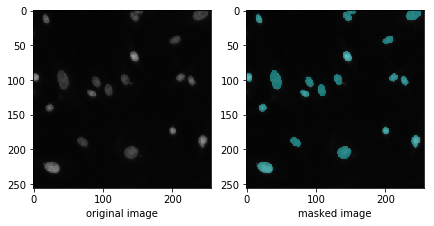

/home/biswajit/Documents/bima/unet/data/train/8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1/images/8f6e49e474ebb649a1e99662243d51a46cc9ba0c9c8f1efe2e2b662a81b48de1.png


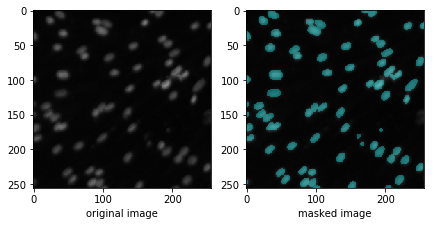

/home/biswajit/Documents/bima/unet/data/train/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895/images/b61d3fb0d0ebbee018346e0adeff9e9178f33aa95262779b3c196f93b4ace895.png


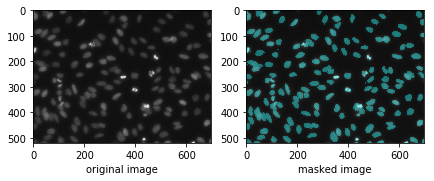

/home/biswajit/Documents/bima/unet/data/train/449fe932622db3b49366a260ddd20077219f96fb2dc0f912ad4f60b087876f3b/images/449fe932622db3b49366a260ddd20077219f96fb2dc0f912ad4f60b087876f3b.png


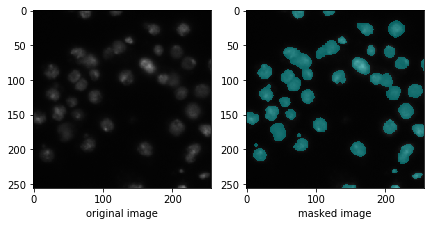

/home/biswajit/Documents/bima/unet/data/train/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d/images/a31deaf0ac279d5f34fb2eca80cc2abce6ef30bd64e7aca40efe4b2ba8e9ad3d.png


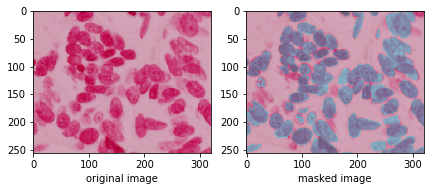

/home/biswajit/Documents/bima/unet/data/train/8f6597cd978c060378177df76e554d0578b97eab471e237dbe0adc0dd0d93d63/images/8f6597cd978c060378177df76e554d0578b97eab471e237dbe0adc0dd0d93d63.png


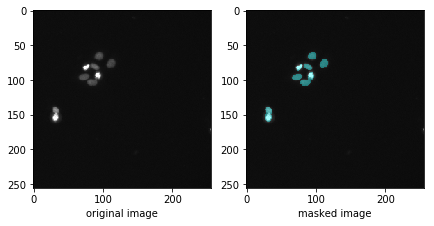

/home/biswajit/Documents/bima/unet/data/train/fa751ff3a6332c95cb5cb1d28563553914295e9e7d35c4b6bd267241e8a0787c/images/fa751ff3a6332c95cb5cb1d28563553914295e9e7d35c4b6bd267241e8a0787c.png


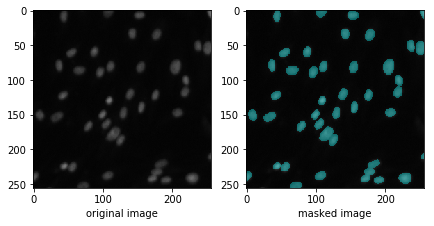

/home/biswajit/Documents/bima/unet/data/train/4327d27591871e9c8d317071a390d1b3dcedad05a9746175b005c41ea0d797b2/images/4327d27591871e9c8d317071a390d1b3dcedad05a9746175b005c41ea0d797b2.png


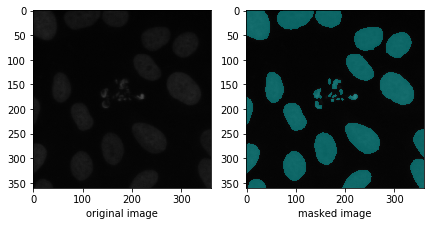

/home/biswajit/Documents/bima/unet/data/train/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5/images/07fb37aafa6626608af90c1e18f6a743f29b6b233d2e427dcd1102df6a916cf5.png


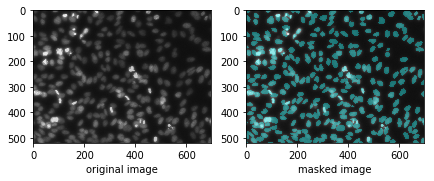

/home/biswajit/Documents/bima/unet/data/train/3b0709483b1e86449cc355bb797e841117ba178c6ae1ed955384f4da6486aa20/images/3b0709483b1e86449cc355bb797e841117ba178c6ae1ed955384f4da6486aa20.png


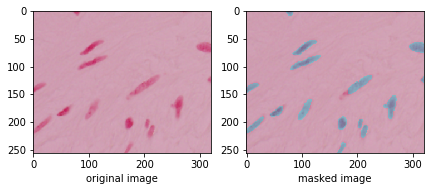

/home/biswajit/Documents/bima/unet/data/train/fa73f24532b3667718ede7ac5c2e24ad7d3cae17b0a42ed17bbb81b15c28f4ae/images/fa73f24532b3667718ede7ac5c2e24ad7d3cae17b0a42ed17bbb81b15c28f4ae.png


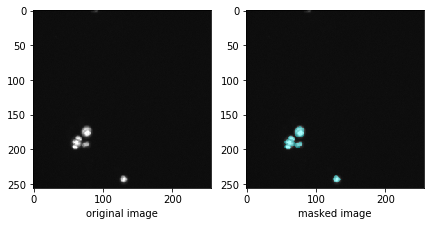

/home/biswajit/Documents/bima/unet/data/train/37ed50eea5a1e0bade3e6753793b6caeb061cd4c2f365658c257f69cab1f6288/images/37ed50eea5a1e0bade3e6753793b6caeb061cd4c2f365658c257f69cab1f6288.png


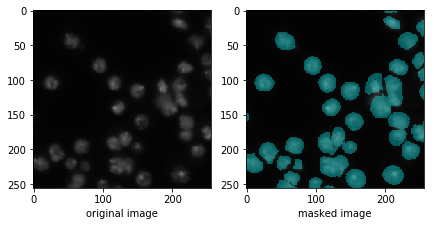

/home/biswajit/Documents/bima/unet/data/train/d7fc0d0a7339211f2433829c6553b762e2b9ef82cfe218d58ecae6643fa8e9c7/images/d7fc0d0a7339211f2433829c6553b762e2b9ef82cfe218d58ecae6643fa8e9c7.png


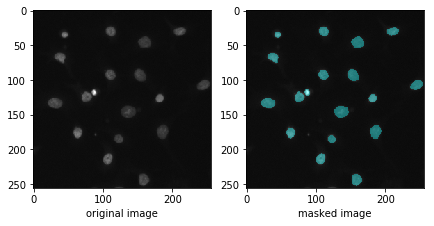

/home/biswajit/Documents/bima/unet/data/train/f8e74d4006dd68c1dbe68df7be905835e00d8ba4916f3b18884509a15fdc0b55/images/f8e74d4006dd68c1dbe68df7be905835e00d8ba4916f3b18884509a15fdc0b55.png


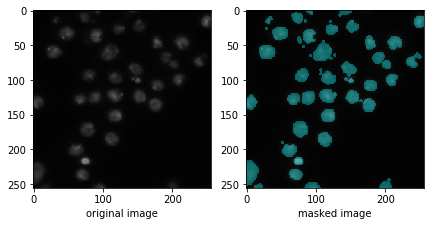

/home/biswajit/Documents/bima/unet/data/train/a7f767ca9770b160f234780e172aeb35a50830ba10dc49c526f4712451abe1d2/images/a7f767ca9770b160f234780e172aeb35a50830ba10dc49c526f4712451abe1d2.png


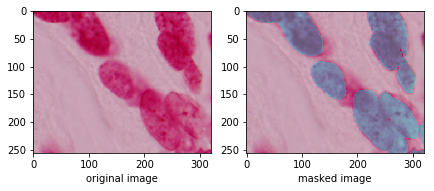

/home/biswajit/Documents/bima/unet/data/train/57d88f45e479ce3821839b2706d667758c63ac769d76800d815c73d2507c1e42/images/57d88f45e479ce3821839b2706d667758c63ac769d76800d815c73d2507c1e42.png


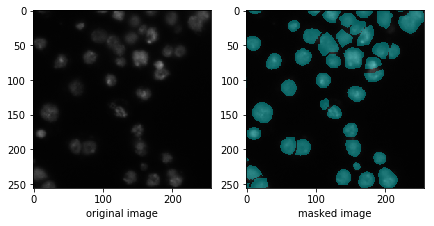

/home/biswajit/Documents/bima/unet/data/train/b6c9b58de0388891221b8f7a83cbf0b8f8379b51b5c9a127bf43a4fc49f1cc48/images/b6c9b58de0388891221b8f7a83cbf0b8f8379b51b5c9a127bf43a4fc49f1cc48.png


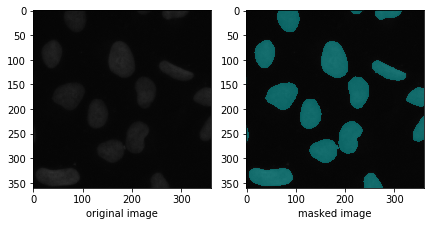

/home/biswajit/Documents/bima/unet/data/train/28d33efef218392e79e385906deb88055d94b65ad217de78c07e85476f80f45a/images/28d33efef218392e79e385906deb88055d94b65ad217de78c07e85476f80f45a.png


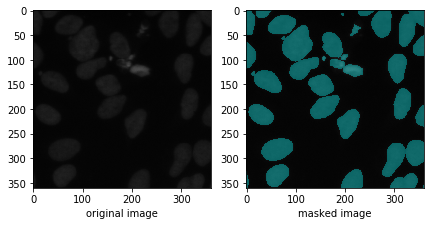

/home/biswajit/Documents/bima/unet/data/train/8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570/images/8fdc34509a0c3721f7b5e235c8a93e1f553343aa17ad103a1e89e3509a3e1570.png


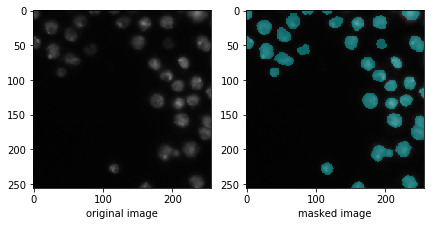

/home/biswajit/Documents/bima/unet/data/train/93c5638e7e6433b5c9cc87c152bcbe28873d2f9d6a392cca0642520807542a77/images/93c5638e7e6433b5c9cc87c152bcbe28873d2f9d6a392cca0642520807542a77.png


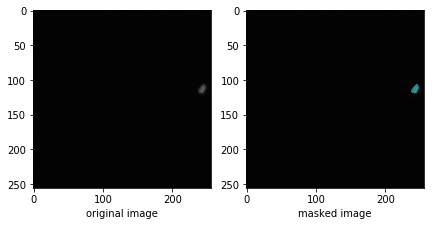

/home/biswajit/Documents/bima/unet/data/train/66612c188d73e931e1863af2c99d2af782c32f65fd97d224abb40bbadb87263f/images/66612c188d73e931e1863af2c99d2af782c32f65fd97d224abb40bbadb87263f.png


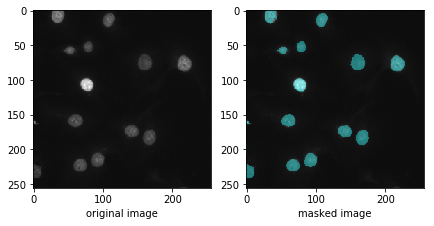

/home/biswajit/Documents/bima/unet/data/train/3ab9cab6212fabd723a2c5a1949c2ded19980398b56e6080978e796f45cbbc90/images/3ab9cab6212fabd723a2c5a1949c2ded19980398b56e6080978e796f45cbbc90.png


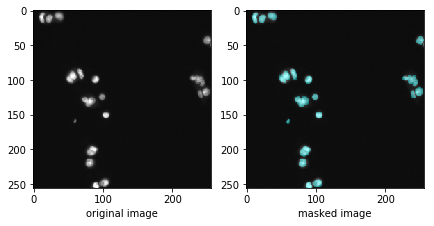

/home/biswajit/Documents/bima/unet/data/train/2c840a94d216f5ef4e499b53ae885e9b022cbf639e004ec788436093837823b2/images/2c840a94d216f5ef4e499b53ae885e9b022cbf639e004ec788436093837823b2.png


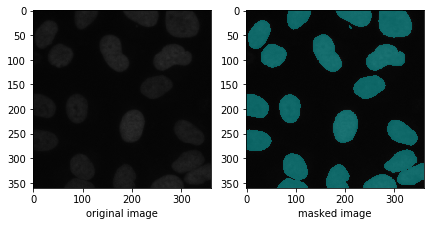

/home/biswajit/Documents/bima/unet/data/train/319b6cb8b0d24b38db5e3c6fbb13b062e2766d9af5ff9bccb8f439ac0d870e52/images/319b6cb8b0d24b38db5e3c6fbb13b062e2766d9af5ff9bccb8f439ac0d870e52.png


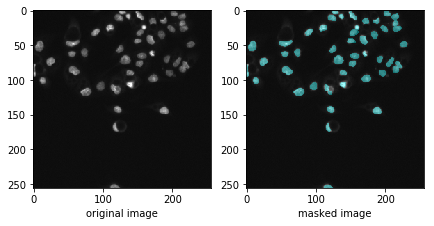

/home/biswajit/Documents/bima/unet/data/train/afa272dc01825d4b929b3bfc79a10f68dd3c163c450d858b964d1ce0bc93e131/images/afa272dc01825d4b929b3bfc79a10f68dd3c163c450d858b964d1ce0bc93e131.png


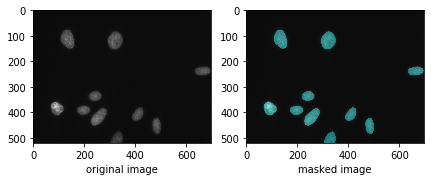

/home/biswajit/Documents/bima/unet/data/train/02903040e19ddf92f452907644ad3822918f54af41dd85e5a3fe3e1b6d6f9339/images/02903040e19ddf92f452907644ad3822918f54af41dd85e5a3fe3e1b6d6f9339.png


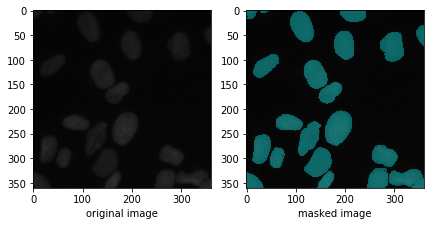

/home/biswajit/Documents/bima/unet/data/train/5b12df18e4ae4df5af06052584cf0e6bef58ee2a220653890636eef88a944e14/images/5b12df18e4ae4df5af06052584cf0e6bef58ee2a220653890636eef88a944e14.png


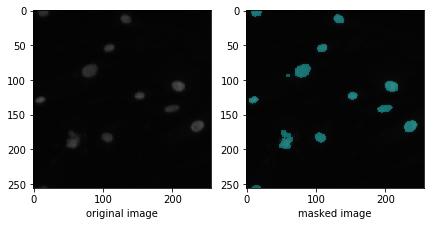

/home/biswajit/Documents/bima/unet/data/train/9cdac2870cfe65b6cb61bd151020068a3b427118a27343767b07ea39483fee32/images/9cdac2870cfe65b6cb61bd151020068a3b427118a27343767b07ea39483fee32.png


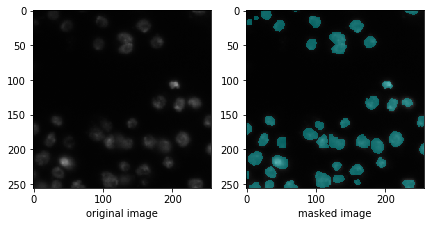

/home/biswajit/Documents/bima/unet/data/train/4a424e0cb845cf6fd4d9fe62875552c7b89a4e0276cf16ebf46babe4656a794e/images/4a424e0cb845cf6fd4d9fe62875552c7b89a4e0276cf16ebf46babe4656a794e.png


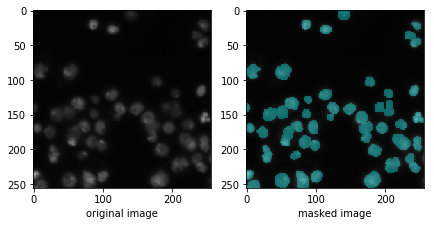

/home/biswajit/Documents/bima/unet/data/train/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb/images/a02ec007ae8feddb758078b1dfb8010c26886fd3c8babdc308ead8b4a63acbdb.png


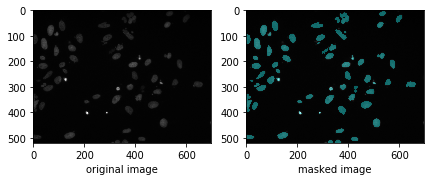

/home/biswajit/Documents/bima/unet/data/train/0287e7ee5b007c91ae2bd7628d09735e70496bc6127ecb7f3dd043e04ce37426/images/0287e7ee5b007c91ae2bd7628d09735e70496bc6127ecb7f3dd043e04ce37426.png


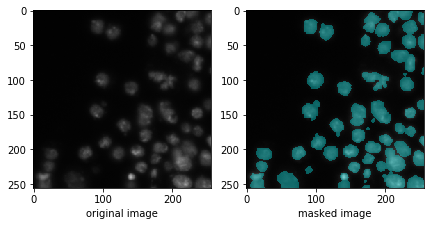

/home/biswajit/Documents/bima/unet/data/train/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339/images/c901794d1a421d52e5734500c0a2a8ca84651fb93b19cec2f411855e70cae339.png


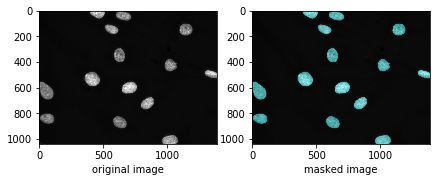

/home/biswajit/Documents/bima/unet/data/train/5b2ccfb94dedf2ec8797c0404fc324888e35ab903c41bb26f070552033ca8e6c/images/5b2ccfb94dedf2ec8797c0404fc324888e35ab903c41bb26f070552033ca8e6c.png


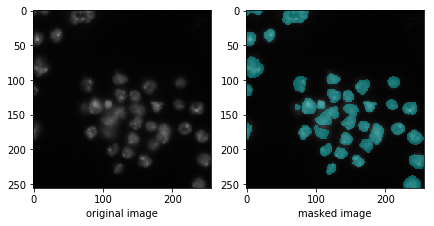

/home/biswajit/Documents/bima/unet/data/train/43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6/images/43cf6b2ec0b0745ac2b87b4d8780f62e9050d3f5d50a1fcefa42d166191e84c6.png


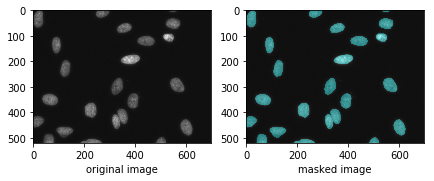

/home/biswajit/Documents/bima/unet/data/train/57b49733c5a3c268b013553635a826e6a1b10e699bbd19c3b842375fe0adf344/images/57b49733c5a3c268b013553635a826e6a1b10e699bbd19c3b842375fe0adf344.png


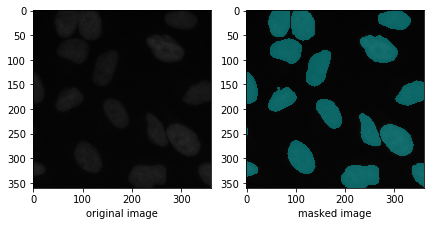

/home/biswajit/Documents/bima/unet/data/train/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77/images/a7f6194ddbeaefb1da571226a97785d09ccafc5893ce3c77078d2040bccfcb77.png


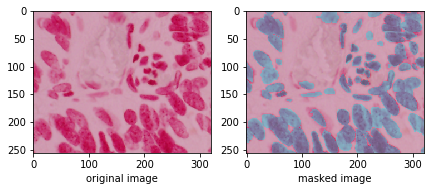

/home/biswajit/Documents/bima/unet/data/train/3d0ca3498d97edebd28dbc7035eced40baa4af199af09cbb7251792accaa69fe/images/3d0ca3498d97edebd28dbc7035eced40baa4af199af09cbb7251792accaa69fe.png


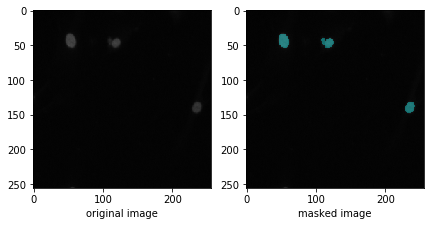

/home/biswajit/Documents/bima/unet/data/train/ebc18868864ad075548cc1784f4f9a237bb98335f9645ee727dac8332a3e3716/images/ebc18868864ad075548cc1784f4f9a237bb98335f9645ee727dac8332a3e3716.png


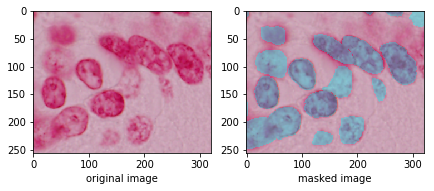

/home/biswajit/Documents/bima/unet/data/train/8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d/images/8d29c5a03e0560c8f9338e8eb7bccf47930149c8173f9ba4b9279fb87d86cf6d.png


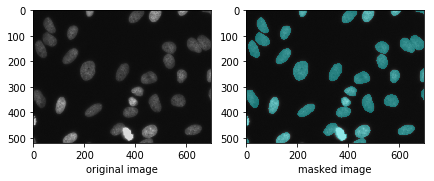

/home/biswajit/Documents/bima/unet/data/train/ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d19659189951f540f48/images/ff599c7301daa1f783924ac8cbe3ce7b42878f15a39c2d19659189951f540f48.png


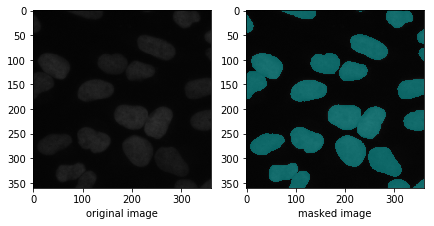

/home/biswajit/Documents/bima/unet/data/train/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40/images/12aeefb1b522b283819b12e4cfaf6b13c1264c0aadac3412b4edd2ace304cb40.png


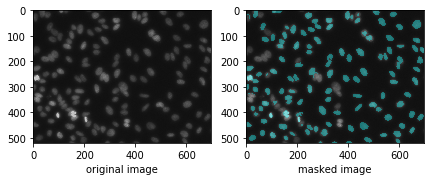

/home/biswajit/Documents/bima/unet/data/train/c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3/images/c75139ef0546d2240b37afb3219eb74a06b7977818697d5c3138796472483af3.png


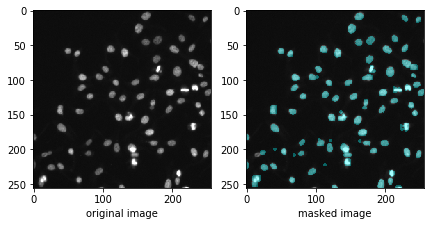

/home/biswajit/Documents/bima/unet/data/train/ce88df7356d9d4a8d5944a93768f4c4b593de2d35616f7448c2b37b9fd60dd1f/images/ce88df7356d9d4a8d5944a93768f4c4b593de2d35616f7448c2b37b9fd60dd1f.png


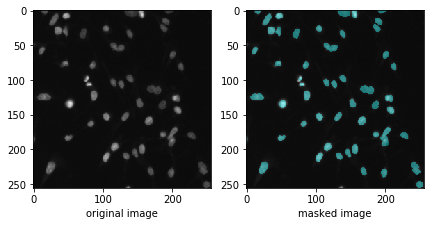

/home/biswajit/Documents/bima/unet/data/train/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3/images/5afb7932e9c7328f4fb1d7a8166a3699d6cdc5192b93758a75e9956f1513c5a3.png


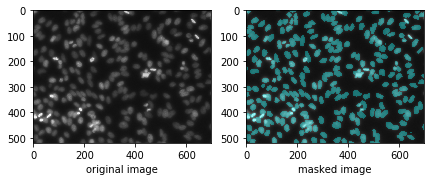

/home/biswajit/Documents/bima/unet/data/train/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548/images/ef3ef194e5657fda708ecbd3eb6530286ed2ba23c88efb9f1715298975c73548.png


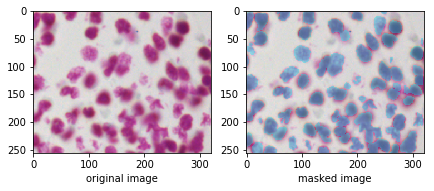

/home/biswajit/Documents/bima/unet/data/train/a4c44fc5f5bf213e2be6091ccaed49d8bf039d78f6fbd9c4d7b7428cfcb2eda4/images/a4c44fc5f5bf213e2be6091ccaed49d8bf039d78f6fbd9c4d7b7428cfcb2eda4.png


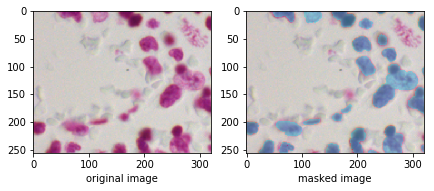

/home/biswajit/Documents/bima/unet/data/train/e5384c905e9879cb6e8ff5250fb03155bc1db035d8dde458eece9078b7de8ff1/images/e5384c905e9879cb6e8ff5250fb03155bc1db035d8dde458eece9078b7de8ff1.png


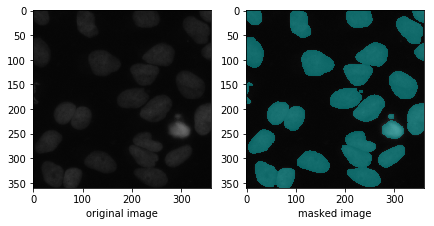

/home/biswajit/Documents/bima/unet/data/train/ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c/images/ed4b8e0d756836be7acb2e2b7799c473b52424e3092a71d3c6d23558e500dc4c.png


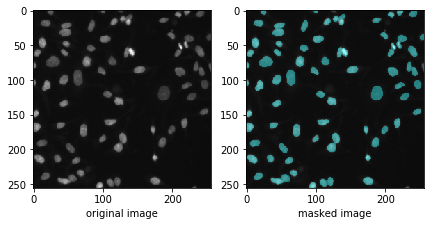

/home/biswajit/Documents/bima/unet/data/train/24a20f2a529cede5695df2422a3986505b5826bb10b10781d6db2074cf3de7b3/images/24a20f2a529cede5695df2422a3986505b5826bb10b10781d6db2074cf3de7b3.png


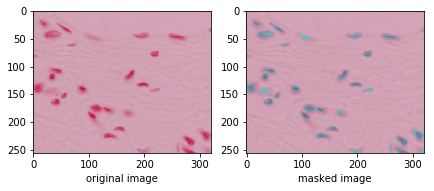

/home/biswajit/Documents/bima/unet/data/train/4d4ebfcae4374165ea6ae7c7e18fd0ba5014c3c860ee2489c59e25ddd45e7a32/images/4d4ebfcae4374165ea6ae7c7e18fd0ba5014c3c860ee2489c59e25ddd45e7a32.png


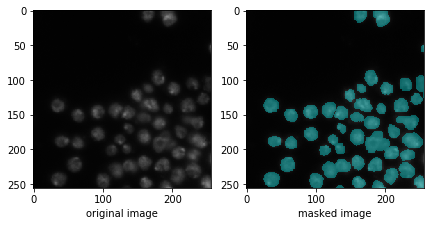

/home/biswajit/Documents/bima/unet/data/train/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa/images/6b6d4e6ff52de473a4b6f8bd0f11ae22242d508cc4117ff38ec39cbb88088aaa.png


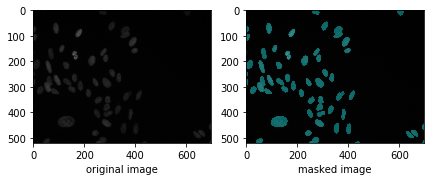

/home/biswajit/Documents/bima/unet/data/train/797945873ca2a95f028671714b71eb3f883efe9dae7fcd3fc0ea1521efb73aaa/images/797945873ca2a95f028671714b71eb3f883efe9dae7fcd3fc0ea1521efb73aaa.png


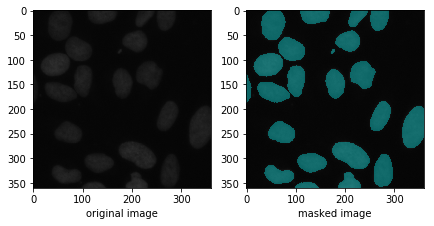

/home/biswajit/Documents/bima/unet/data/train/55f98f43c152aa0dc8bea513f8ba558cc57494b81ae4ee816977816e79629c50/images/55f98f43c152aa0dc8bea513f8ba558cc57494b81ae4ee816977816e79629c50.png


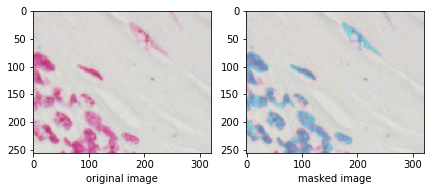

/home/biswajit/Documents/bima/unet/data/train/ec031f176dafe0b36547068ce42eab39428ec7995dac1b3ea52d1db79b61fdeb/images/ec031f176dafe0b36547068ce42eab39428ec7995dac1b3ea52d1db79b61fdeb.png


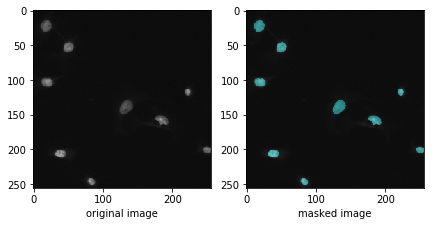

/home/biswajit/Documents/bima/unet/data/train/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461/images/62057502c387145ed4f8f7f0d5e5bedcb72d3bcec15fa71cb0310dee32871461.png


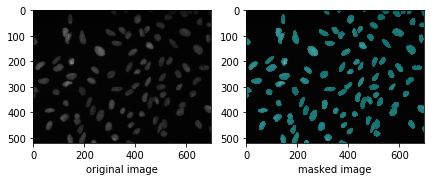

/home/biswajit/Documents/bima/unet/data/train/bb481eae02085bbae08742f702b9ab7d8b2ff9df2fbefeee9fac51f7c77dd01f/images/bb481eae02085bbae08742f702b9ab7d8b2ff9df2fbefeee9fac51f7c77dd01f.png


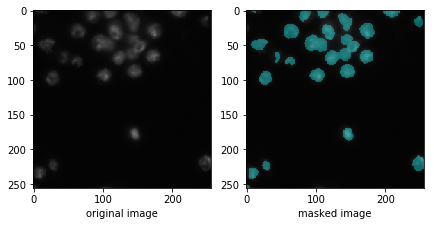

/home/biswajit/Documents/bima/unet/data/train/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d/images/2cfa61bef6542dd359717e9131ce6f076c415a3bd7f48cb093b0d7f3b2ca785d.png


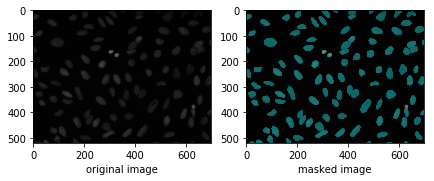

/home/biswajit/Documents/bima/unet/data/train/88678981648b184b23b6c04999f29210cbe351f85b61d2bf99e306fd67a2998a/images/88678981648b184b23b6c04999f29210cbe351f85b61d2bf99e306fd67a2998a.png


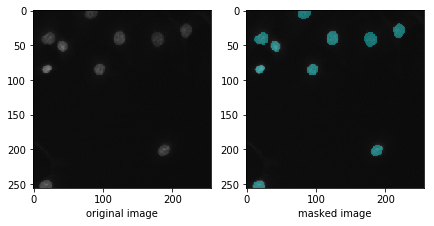

/home/biswajit/Documents/bima/unet/data/train/d32ea6d318626ca14a967d0c1ad3218aebfe636624a8d1173f5150dde8ff38cf/images/d32ea6d318626ca14a967d0c1ad3218aebfe636624a8d1173f5150dde8ff38cf.png


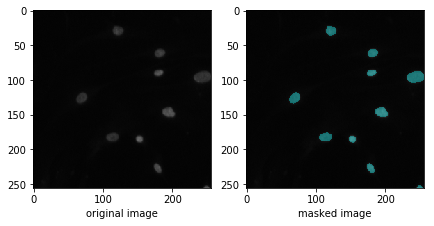

/home/biswajit/Documents/bima/unet/data/train/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288/images/a102535b0e88374bea4a1cfd9ee7cb3822ff54f4ab2a9845d428ec22f9ee2288.png


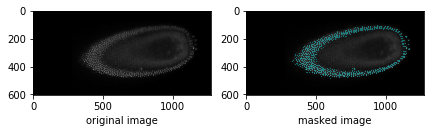

/home/biswajit/Documents/bima/unet/data/train/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed/images/5f9d29d6388c700f35a3c29fa1b1ce0c1cba6667d05fdb70bd1e89004dcf71ed.png


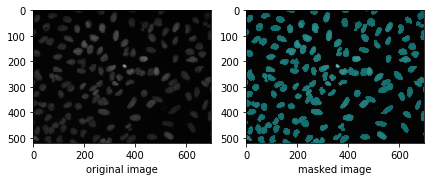

/home/biswajit/Documents/bima/unet/data/train/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992/images/08275a5b1c2dfcd739e8c4888a5ee2d29f83eccfa75185404ced1dc0866ea992.png


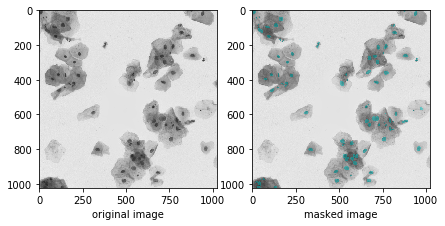

/home/biswajit/Documents/bima/unet/data/train/305a8baaf726d7c9e695bff31d3a6a61445999a4732f0a3e6174dc9dcbe43931/images/305a8baaf726d7c9e695bff31d3a6a61445999a4732f0a3e6174dc9dcbe43931.png


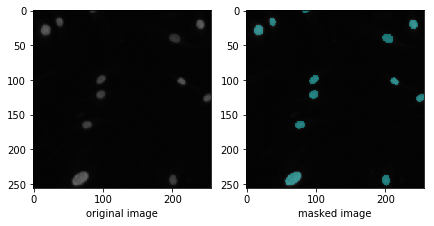

/home/biswajit/Documents/bima/unet/data/train/b560dba92fbf2af785739efced50d5866c86dc4dada9be3832138bef4c3524d2/images/b560dba92fbf2af785739efced50d5866c86dc4dada9be3832138bef4c3524d2.png


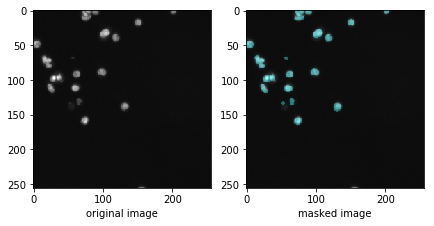

/home/biswajit/Documents/bima/unet/data/train/420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f/images/420f43d21dbaba42bf8c0995b3a2c85537876d594433770c6c6f3d6b779ec15f.png


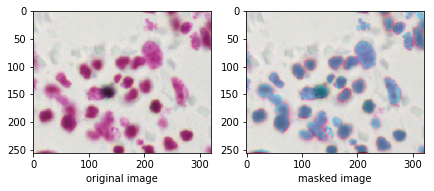

/home/biswajit/Documents/bima/unet/data/train/7b5987a24dd57325e82812371b3f4df7edc528e0526754ba94cf3a1ea4df25d2/images/7b5987a24dd57325e82812371b3f4df7edc528e0526754ba94cf3a1ea4df25d2.png


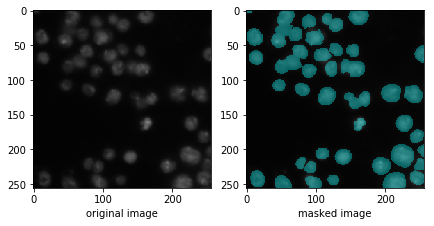

/home/biswajit/Documents/bima/unet/data/train/3a3fee427e6ef7dfd0d82681e2bcee2d054f80287aea7dfa3fa4447666f929b9/images/3a3fee427e6ef7dfd0d82681e2bcee2d054f80287aea7dfa3fa4447666f929b9.png


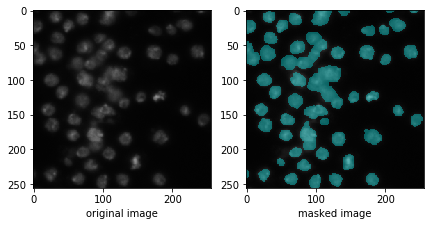

/home/biswajit/Documents/bima/unet/data/train/54fe2d3416951cbc48f8718624c86a7ae58b6022a7fa75591b13f625cf53658b/images/54fe2d3416951cbc48f8718624c86a7ae58b6022a7fa75591b13f625cf53658b.png


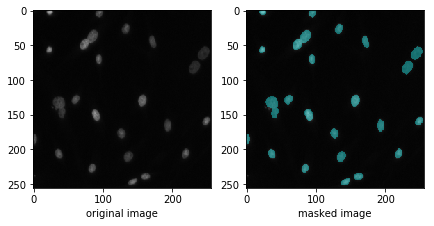

/home/biswajit/Documents/bima/unet/data/train/3b3f516ebc9a16cff287a5ffd3a1861a345a6d38bedbba74f1c0b0e0eac62afd/images/3b3f516ebc9a16cff287a5ffd3a1861a345a6d38bedbba74f1c0b0e0eac62afd.png


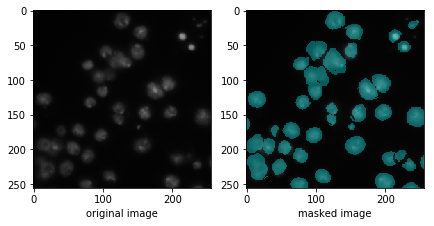

/home/biswajit/Documents/bima/unet/data/train/8bef203fce625e4d8c89dca728158be4662dfdfdcd4dc73a6aa39a908c1631bc/images/8bef203fce625e4d8c89dca728158be4662dfdfdcd4dc73a6aa39a908c1631bc.png


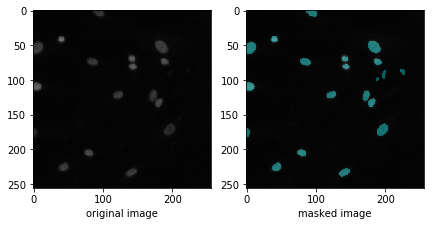

/home/biswajit/Documents/bima/unet/data/train/7d40ea6ead1bec903f26d9046d291aedcb12a584b4d3b337ea252b34c7d86072/images/7d40ea6ead1bec903f26d9046d291aedcb12a584b4d3b337ea252b34c7d86072.png


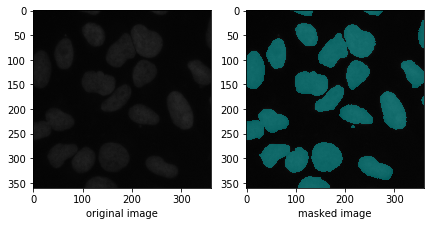

/home/biswajit/Documents/bima/unet/data/train/bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2/images/bbfc4aab5645637680fa0ef00925eea733b93099f1944c0aea09b78af1d4eef2.png


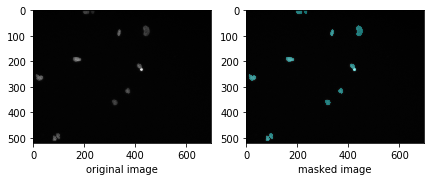

/home/biswajit/Documents/bima/unet/data/train/e5f8ad0f0a43af8ca57e31e16800108abdfb44a7e962a71d246f72d2dbde42bf/images/e5f8ad0f0a43af8ca57e31e16800108abdfb44a7e962a71d246f72d2dbde42bf.png


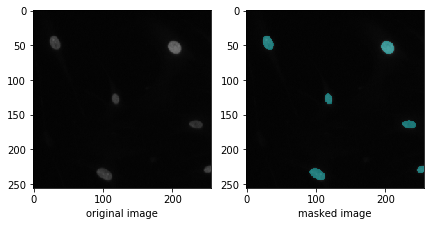

/home/biswajit/Documents/bima/unet/data/train/a0afead3b4fe393f6a6159de040ecb2e66f8a89090abf0d0bf5b8e1d38ae667c/images/a0afead3b4fe393f6a6159de040ecb2e66f8a89090abf0d0bf5b8e1d38ae667c.png


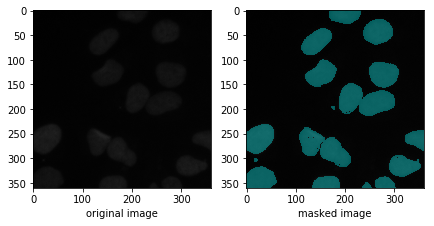

/home/biswajit/Documents/bima/unet/data/train/dad607a203483439fcbc2acecd0a39fb5e5a94a32a94348f5c802c79cfeb6e7c/images/dad607a203483439fcbc2acecd0a39fb5e5a94a32a94348f5c802c79cfeb6e7c.png


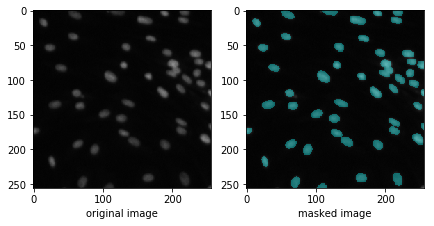

/home/biswajit/Documents/bima/unet/data/train/84e642d75ae6ece8147272418b6fe13d04db8d076fe306c4acedc329fceab564/images/84e642d75ae6ece8147272418b6fe13d04db8d076fe306c4acedc329fceab564.png


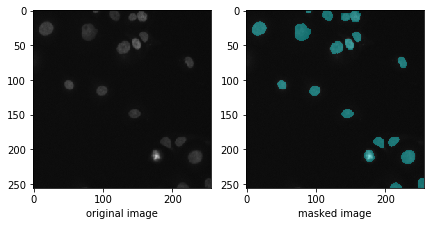

/home/biswajit/Documents/bima/unet/data/train/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842/images/8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177ef25a9dee25ffe8842.png


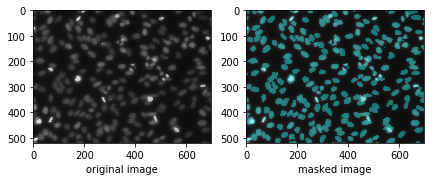

/home/biswajit/Documents/bima/unet/data/train/1a75e9f15481d11084fe66bc2a5afac6dc5bec20ed56a7351a6d65ef0fe8762b/images/1a75e9f15481d11084fe66bc2a5afac6dc5bec20ed56a7351a6d65ef0fe8762b.png


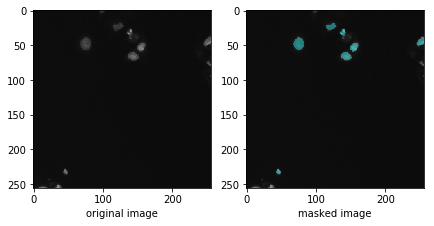

/home/biswajit/Documents/bima/unet/data/train/0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21/images/0280fa8f60f6bcae0f97d93c28f60be194f9309ff610dc5845e60455b0f87c21.png


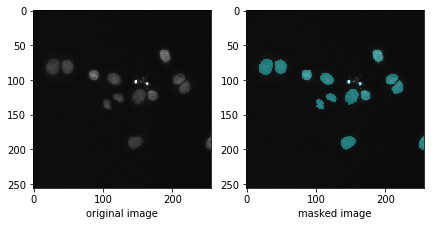

/home/biswajit/Documents/bima/unet/data/train/55ff2b0ec48b76e10c7ee18add5794005cd551697f96af865c763d50da78dd9c/images/55ff2b0ec48b76e10c7ee18add5794005cd551697f96af865c763d50da78dd9c.png


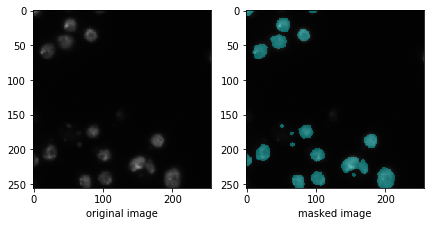

/home/biswajit/Documents/bima/unet/data/train/1db1cddf28e305c9478519cfac144eee2242183fe59061f1f15487e925e8f5b5/images/1db1cddf28e305c9478519cfac144eee2242183fe59061f1f15487e925e8f5b5.png


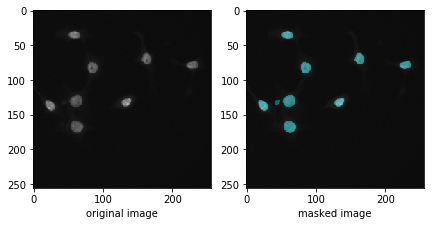

/home/biswajit/Documents/bima/unet/data/train/b0e35e06b85da49bfe3ea737711a72b551a6add446e30eabb01aa683a79873c5/images/b0e35e06b85da49bfe3ea737711a72b551a6add446e30eabb01aa683a79873c5.png


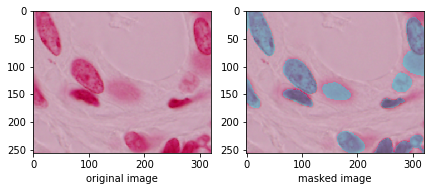

/home/biswajit/Documents/bima/unet/data/train/136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261/images/136000dc18fa6def2d6c98d4d0b2084d13c22eaffe82e26c665bcaa2a9e51261.png


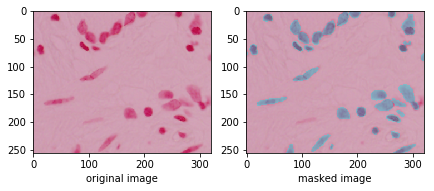

/home/biswajit/Documents/bima/unet/data/train/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38/images/b76ff33ae9da28f9cd8bdce465d45f1eca399db3ffa83847535708e0d511fe38.png


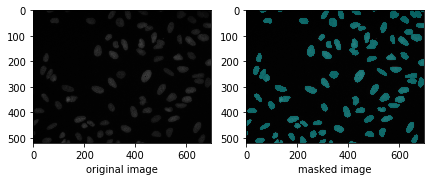

/home/biswajit/Documents/bima/unet/data/train/be26966900aa0e5b41d5a8ecafe04281b37deb05c5cd027968d7b74143398174/images/be26966900aa0e5b41d5a8ecafe04281b37deb05c5cd027968d7b74143398174.png


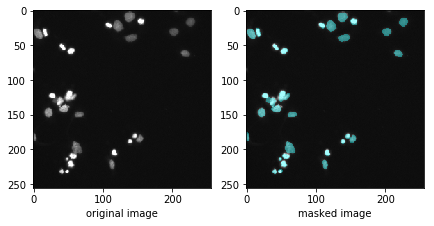

/home/biswajit/Documents/bima/unet/data/train/1e488c42eb1a54a3e8412b1f12cde530f950f238d71078f2ede6a85a02168e1f/images/1e488c42eb1a54a3e8412b1f12cde530f950f238d71078f2ede6a85a02168e1f.png


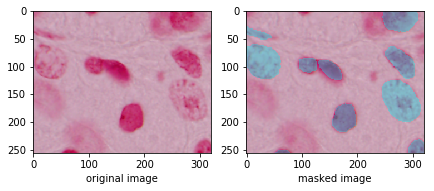

/home/biswajit/Documents/bima/unet/data/train/4bf6a5ec42032bb8dbbb10d25fdc5211b2fe1ce44b6e577ef89dbda17697d819/images/4bf6a5ec42032bb8dbbb10d25fdc5211b2fe1ce44b6e577ef89dbda17697d819.png


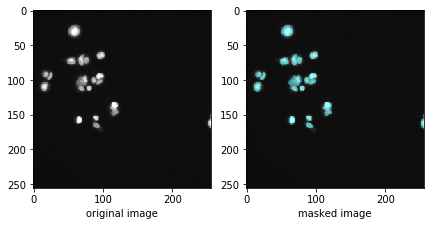

/home/biswajit/Documents/bima/unet/data/train/2ad489c11ed8b77a9d8a2339ac64ffc38e79281c03a2507db4688fd3186c0fe5/images/2ad489c11ed8b77a9d8a2339ac64ffc38e79281c03a2507db4688fd3186c0fe5.png


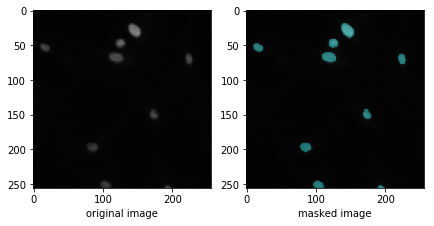

/home/biswajit/Documents/bima/unet/data/train/0b2e702f90aee4fff2bc6e4326308d50cf04701082e718d4f831c8959fbcda93/images/0b2e702f90aee4fff2bc6e4326308d50cf04701082e718d4f831c8959fbcda93.png


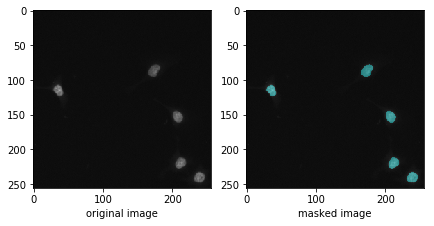

/home/biswajit/Documents/bima/unet/data/train/a3a65623e079af7988b0c1cf1e54041003c6d730c91ecf200b71c47b93a67ed6/images/a3a65623e079af7988b0c1cf1e54041003c6d730c91ecf200b71c47b93a67ed6.png


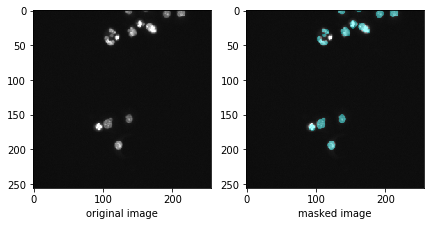

/home/biswajit/Documents/bima/unet/data/train/309ba76b12ecb5ce28b99f3445b2b5dc54c0564c3c0e24c17e4c89a94a5d0535/images/309ba76b12ecb5ce28b99f3445b2b5dc54c0564c3c0e24c17e4c89a94a5d0535.png


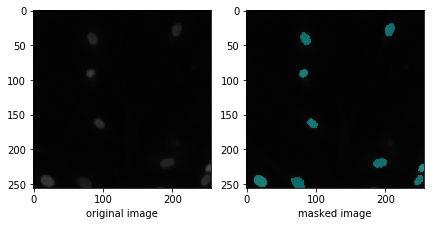

/home/biswajit/Documents/bima/unet/data/train/00071198d059ba7f5914a526d124d28e6d010c92466da21d4a04cd5413362552/images/00071198d059ba7f5914a526d124d28e6d010c92466da21d4a04cd5413362552.png


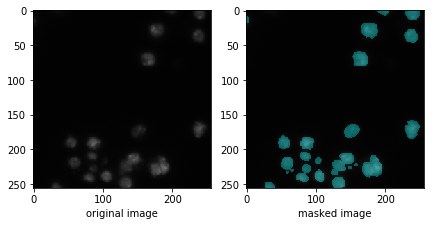

/home/biswajit/Documents/bima/unet/data/train/5ddbfba2519484316e4b7ccabfa605e6e6fd96c3d87ac8cdfd2c134571a15311/images/5ddbfba2519484316e4b7ccabfa605e6e6fd96c3d87ac8cdfd2c134571a15311.png


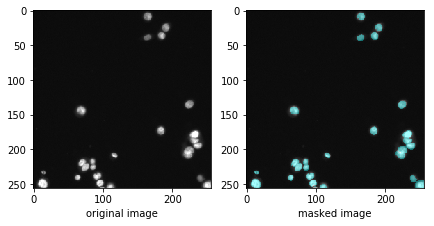

/home/biswajit/Documents/bima/unet/data/train/7c318172e976ae5a962c9c7a4e9fe46d7fb985765ddd3a3e2108e893a90b92b2/images/7c318172e976ae5a962c9c7a4e9fe46d7fb985765ddd3a3e2108e893a90b92b2.png


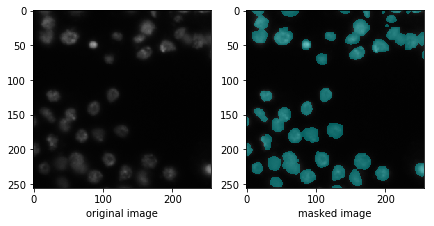

/home/biswajit/Documents/bima/unet/data/train/1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c42164b223110c09168/images/1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c42164b223110c09168.png


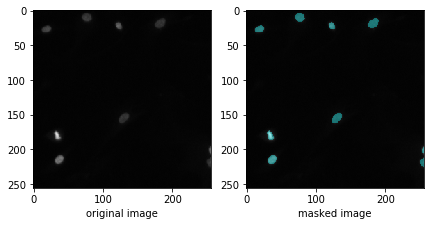

/home/biswajit/Documents/bima/unet/data/train/29dd28df98ee51b4ab1a87f5509538ecc3e4697fc57c40c6165658f61b0d8e3a/images/29dd28df98ee51b4ab1a87f5509538ecc3e4697fc57c40c6165658f61b0d8e3a.png


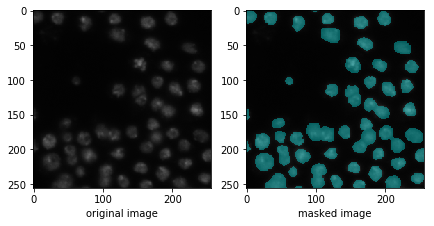

/home/biswajit/Documents/bima/unet/data/train/94a5a37c3b1153d5c5aef2eca53c960b9f21f2ef1758209d7ec502ec324b03a3/images/94a5a37c3b1153d5c5aef2eca53c960b9f21f2ef1758209d7ec502ec324b03a3.png


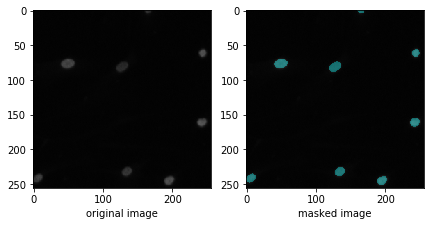

/home/biswajit/Documents/bima/unet/data/train/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8/images/1f6b7cead15344593b32d5f2345fc26713dc74d9b31306c824209d67da401fd8.png


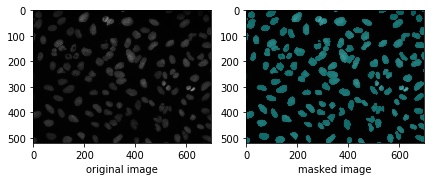

/home/biswajit/Documents/bima/unet/data/train/60cb718759bff13f81c4055a7679e81326f78b6a193a2d856546097c949b20ff/images/60cb718759bff13f81c4055a7679e81326f78b6a193a2d856546097c949b20ff.png


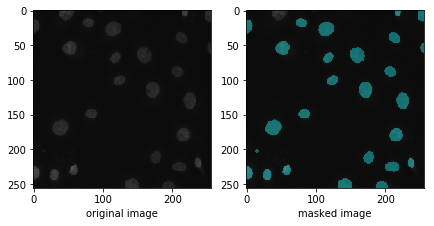

/home/biswajit/Documents/bima/unet/data/train/ead9464a50a17f74bf1b6471d94ecce8d887cf518c8fedc6c6048eb948bc4e49/images/ead9464a50a17f74bf1b6471d94ecce8d887cf518c8fedc6c6048eb948bc4e49.png


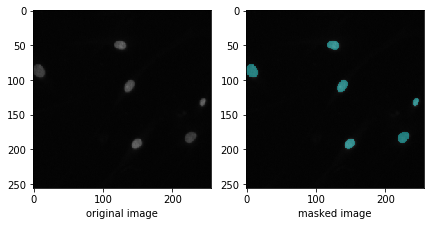

/home/biswajit/Documents/bima/unet/data/train/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e/images/4d09672bcf5a2661eea00891bbb8191225a06619a849aece37ad10d9dedbde3e.png


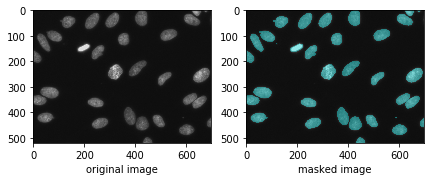

/home/biswajit/Documents/bima/unet/data/train/a5fe0b7412dd152c41f7afc34ffdf276d4261b6942fa6d36803648e90f2cfc06/images/a5fe0b7412dd152c41f7afc34ffdf276d4261b6942fa6d36803648e90f2cfc06.png


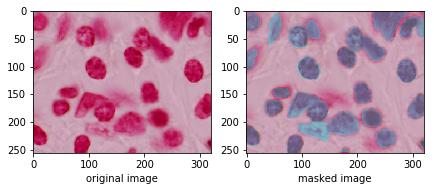

/home/biswajit/Documents/bima/unet/data/train/5b0bde771bc67c505d1b59405cbcad0a2766ec3ee4e35852e959552c1b454233/images/5b0bde771bc67c505d1b59405cbcad0a2766ec3ee4e35852e959552c1b454233.png


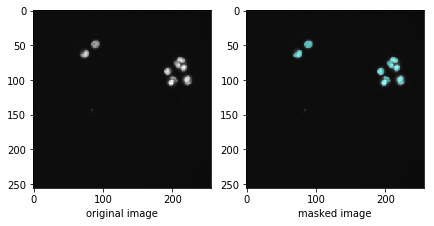

/home/biswajit/Documents/bima/unet/data/train/e216ec5063d3562b793e434c491051bd8867f6c2e571e41137c7c560cc0e6a03/images/e216ec5063d3562b793e434c491051bd8867f6c2e571e41137c7c560cc0e6a03.png


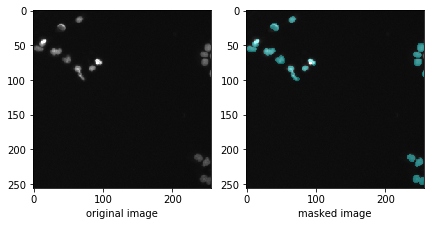

/home/biswajit/Documents/bima/unet/data/train/4d4f254f3b8b4408d661df3735591554b2f6587ce1952928d619b48010d55467/images/4d4f254f3b8b4408d661df3735591554b2f6587ce1952928d619b48010d55467.png


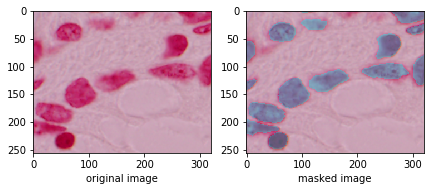

/home/biswajit/Documents/bima/unet/data/train/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710/images/a7a581e6760df4701941670e73d72533e3b0fbd7563488ad92772b41f7709710.png


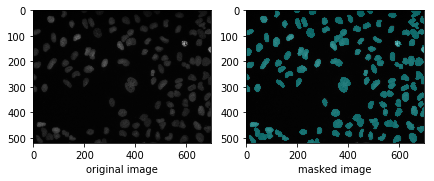

/home/biswajit/Documents/bima/unet/data/train/f4faa3a409014db1865074c5f66a0255f71ae3faba03265da0b3b91f68e8a8f0/images/f4faa3a409014db1865074c5f66a0255f71ae3faba03265da0b3b91f68e8a8f0.png


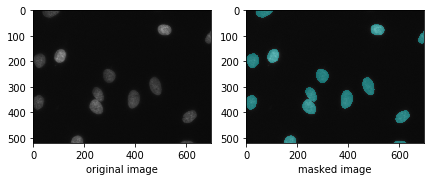

/home/biswajit/Documents/bima/unet/data/train/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c/images/cbff60361ded0570e5d50429a1aa51d81471819bc9b38359f03cfef76de0038c.png


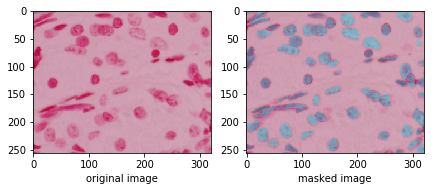

/home/biswajit/Documents/bima/unet/data/train/f6b16c885c0b2bc0d0eb2bb2eeb0a2753ebafb5a7a91da10e89b0b0478984637/images/f6b16c885c0b2bc0d0eb2bb2eeb0a2753ebafb5a7a91da10e89b0b0478984637.png


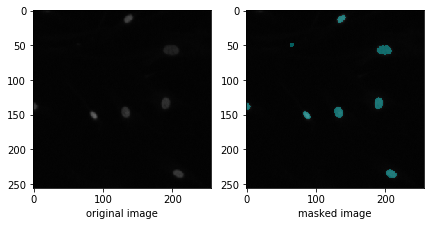

/home/biswajit/Documents/bima/unet/data/train/bf7691b0a79811fa068b7408cbce636a73f01ef9e971a95da1a2d96df73782b6/images/bf7691b0a79811fa068b7408cbce636a73f01ef9e971a95da1a2d96df73782b6.png


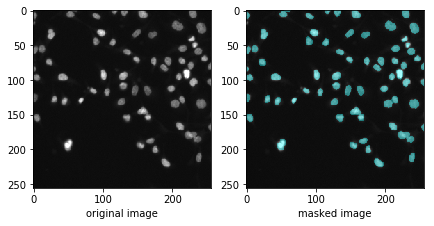

/home/biswajit/Documents/bima/unet/data/train/58406ed8ef944831c413c3424dc2b07e59aef13eb1ff16acbb3402b38b5de0bd/images/58406ed8ef944831c413c3424dc2b07e59aef13eb1ff16acbb3402b38b5de0bd.png


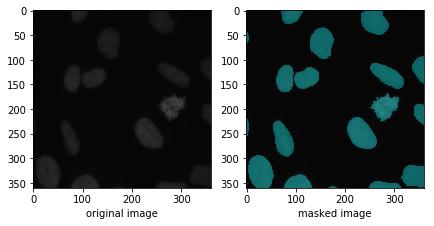

/home/biswajit/Documents/bima/unet/data/train/08ae2741df2f5ac815c0f272a8c532b5167ee853be9b939b9b8b7fa93560868a/images/08ae2741df2f5ac815c0f272a8c532b5167ee853be9b939b9b8b7fa93560868a.png


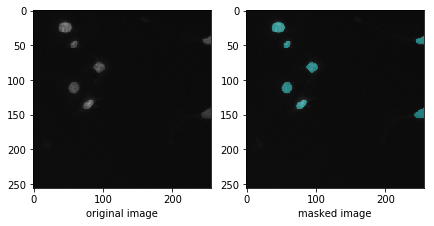

/home/biswajit/Documents/bima/unet/data/train/bc115ff727e997a88f7cfe4ce817745731a6c753cb9fab6a36e7e66b415a1d3d/images/bc115ff727e997a88f7cfe4ce817745731a6c753cb9fab6a36e7e66b415a1d3d.png


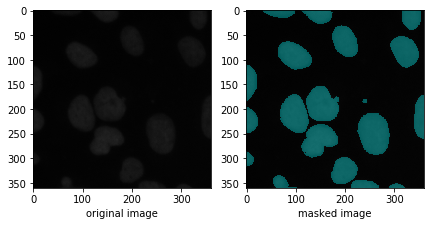

/home/biswajit/Documents/bima/unet/data/train/8de0b1a2e8f614af29fe5fafeaa5bdf55e6b3e65edf36355f19b707f7649ce2b/images/8de0b1a2e8f614af29fe5fafeaa5bdf55e6b3e65edf36355f19b707f7649ce2b.png


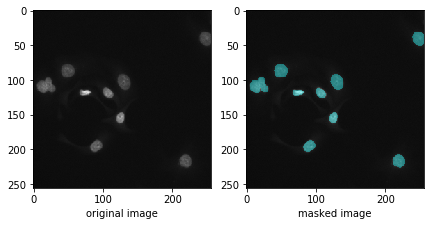

/home/biswajit/Documents/bima/unet/data/train/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c/images/351771edfc5db5665ded8aa4940257276b6526663c76e3b60b92a52584d8943c.png


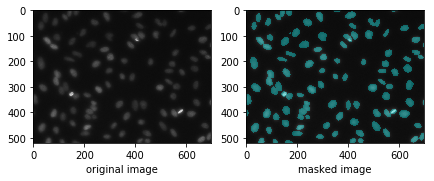

/home/biswajit/Documents/bima/unet/data/train/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3/images/0e4c2e2780de7ec4312f0efcd86b07c3738d21df30bb4643659962b4da5505a3.png


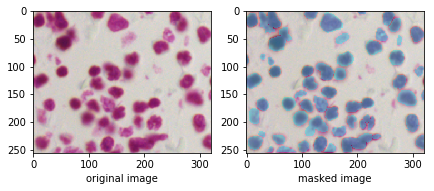

/home/biswajit/Documents/bima/unet/data/train/92e7e86e765e05ce331c07a6d14f0a696eac7ee40058699243900f40b696d7aa/images/92e7e86e765e05ce331c07a6d14f0a696eac7ee40058699243900f40b696d7aa.png


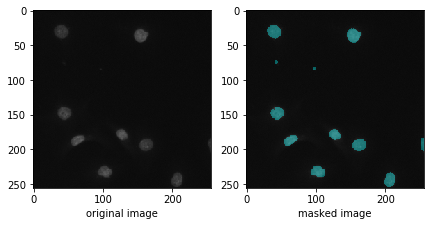

/home/biswajit/Documents/bima/unet/data/train/da8ca06ccbb4e2a8718f7c2939ef6cc3a4088981f660842ad885a8273e740d55/images/da8ca06ccbb4e2a8718f7c2939ef6cc3a4088981f660842ad885a8273e740d55.png


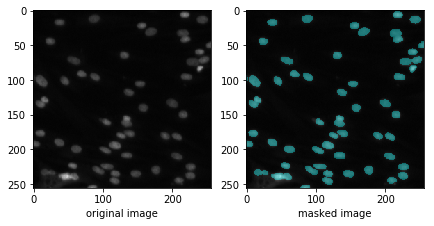

/home/biswajit/Documents/bima/unet/data/train/c8ca945abc29d262a5525e4c2585541bba33fa77c86a47c94575d8e5b54c83fb/images/c8ca945abc29d262a5525e4c2585541bba33fa77c86a47c94575d8e5b54c83fb.png


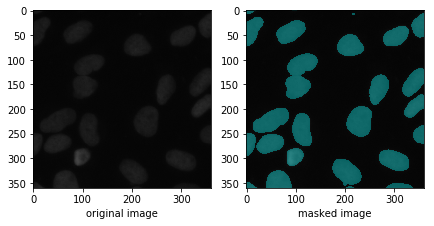

/home/biswajit/Documents/bima/unet/data/train/b6edad733399c83c8eb7a59c0d37b54e10cc0d59894e39ff843884d84f61dee1/images/b6edad733399c83c8eb7a59c0d37b54e10cc0d59894e39ff843884d84f61dee1.png


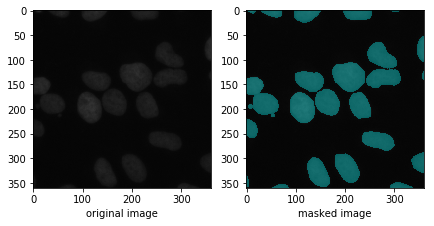

/home/biswajit/Documents/bima/unet/data/train/dbbfe08a52688d0ac8de9161cbb17cb201e3991aacab8ab8a77fe0e203a69481/images/dbbfe08a52688d0ac8de9161cbb17cb201e3991aacab8ab8a77fe0e203a69481.png


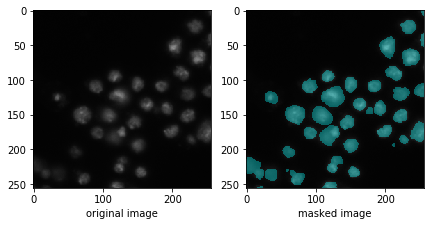

/home/biswajit/Documents/bima/unet/data/train/9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a/images/9586e48a9a4353f11898a6a4b7475a91574e8af82e99c4b7a5e1f1b18f345f7a.png


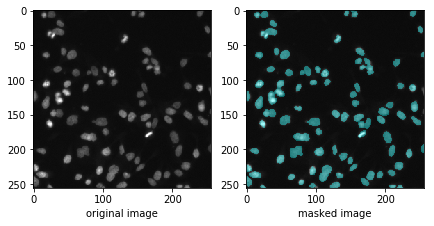

/home/biswajit/Documents/bima/unet/data/train/13c8ff1f49886e91c98ce795c93648ad8634c782ff57eb928ce29496b0425057/images/13c8ff1f49886e91c98ce795c93648ad8634c782ff57eb928ce29496b0425057.png


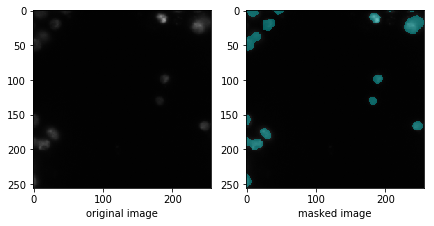

/home/biswajit/Documents/bima/unet/data/train/20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423/images/20e209f6ffa120a72712e1b4c1d3e24d1339227e2936abd4bbd49a636fada423.png


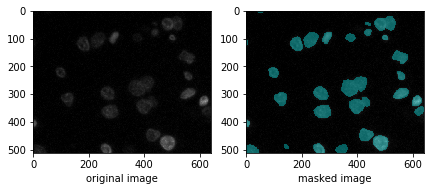

/home/biswajit/Documents/bima/unet/data/train/1d4a5e729bb96b08370789cad0791f6e52ce0ffe1fcc97a04046420b43c851dd/images/1d4a5e729bb96b08370789cad0791f6e52ce0ffe1fcc97a04046420b43c851dd.png


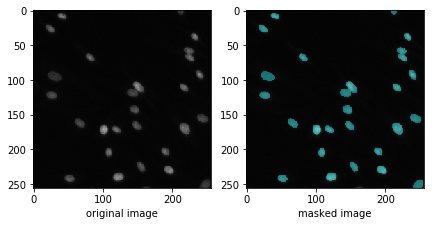

/home/biswajit/Documents/bima/unet/data/train/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932/images/c304a1fdf3bca2f4b4580d2cac59942e2224a7678001bf5ed9d9852f57708932.png


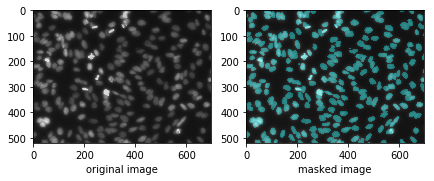

/home/biswajit/Documents/bima/unet/data/train/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0/images/449f41710769584b5e4eca8ecb4c76d5272605f27da2949e6285de0860d2cbc0.png


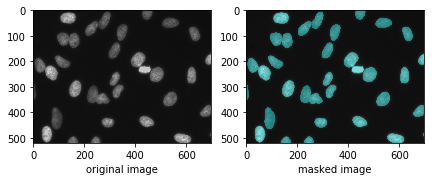

/home/biswajit/Documents/bima/unet/data/train/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa/images/8f94a80b95a881d0efdec36affc915dca9609f4cba8134c4a91b219d418778aa.png


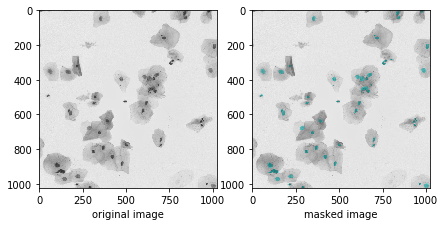

/home/biswajit/Documents/bima/unet/data/train/ed5be4b63e9506ad64660dd92a098ffcc0325195298c13c815a73773f1efc279/images/ed5be4b63e9506ad64660dd92a098ffcc0325195298c13c815a73773f1efc279.png


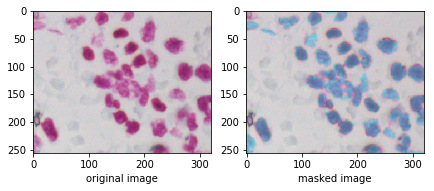

/home/biswajit/Documents/bima/unet/data/train/b1e3aeb0c56261c17eb71c747d116057b8da7e8c8a6845bdc01b2b3ee2299229/images/b1e3aeb0c56261c17eb71c747d116057b8da7e8c8a6845bdc01b2b3ee2299229.png


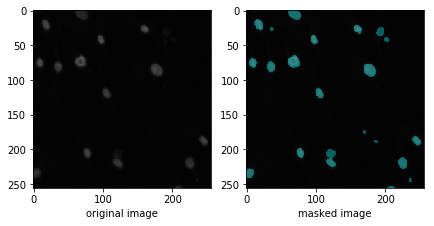

/home/biswajit/Documents/bima/unet/data/train/bf4a61bb81589c9a67e3343408befd3e135af5e88b50c17f998f2131d24bc271/images/bf4a61bb81589c9a67e3343408befd3e135af5e88b50c17f998f2131d24bc271.png


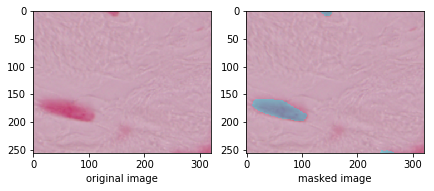

/home/biswajit/Documents/bima/unet/data/train/3a22fe593d9606d4f137461dd6802fd3918f9fbf36f4a65292be69670365e2ca/images/3a22fe593d9606d4f137461dd6802fd3918f9fbf36f4a65292be69670365e2ca.png


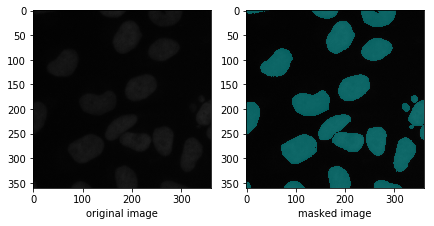

/home/biswajit/Documents/bima/unet/data/train/bf566e75d5cb0196de4139573f8bbbda0fa38d5048edf7267fe8793dcc094a66/images/bf566e75d5cb0196de4139573f8bbbda0fa38d5048edf7267fe8793dcc094a66.png


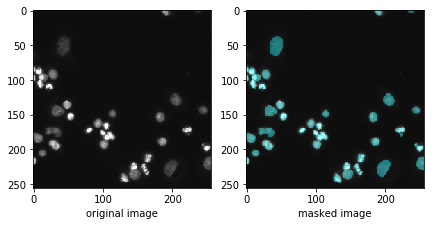

/home/biswajit/Documents/bima/unet/data/train/76c44d1addac92a65f1331f2d93f4e3b130bd4e538a6e5239c3ac1f4c403608a/images/76c44d1addac92a65f1331f2d93f4e3b130bd4e538a6e5239c3ac1f4c403608a.png


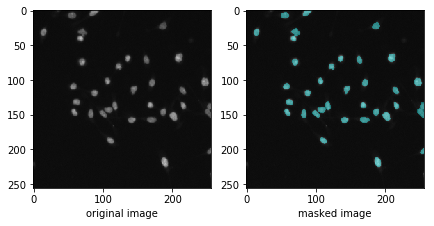

/home/biswajit/Documents/bima/unet/data/train/b67a6e5da8b1cfa5319d94a7d3f8b706725753346c37a4636bf7382e98b3c5df/images/b67a6e5da8b1cfa5319d94a7d3f8b706725753346c37a4636bf7382e98b3c5df.png


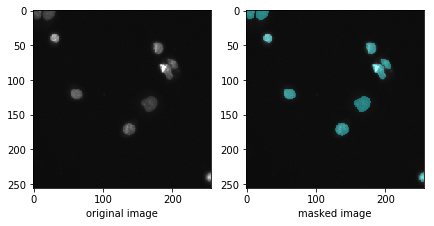

/home/biswajit/Documents/bima/unet/data/train/7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04/images/7aa1aaa5e032a980f434c8ed63efb57ab0d338d6154c47f7bb75afdc89f43c04.png


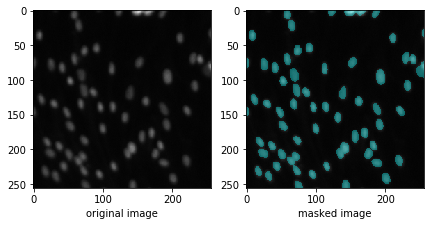

/home/biswajit/Documents/bima/unet/data/train/cdab367b30db47061df837c1ae9fa875d6057614f797332d37d3513517d6c694/images/cdab367b30db47061df837c1ae9fa875d6057614f797332d37d3513517d6c694.png


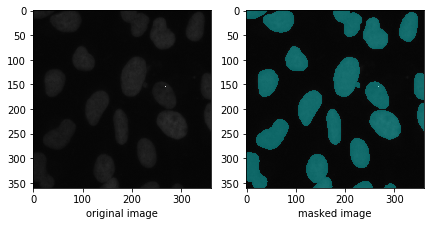

/home/biswajit/Documents/bima/unet/data/train/a3a1b8f9794ef589b71faa9f35fd97ad6761c4488718fbcf766e95e31afa8606/images/a3a1b8f9794ef589b71faa9f35fd97ad6761c4488718fbcf766e95e31afa8606.png


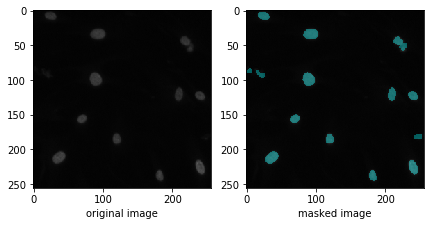

/home/biswajit/Documents/bima/unet/data/train/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8/images/5bb8508ff8ec8683fc6a8aa6bd470f6feb3af4eccdca07f51a1ebc9dad67cfb8.png


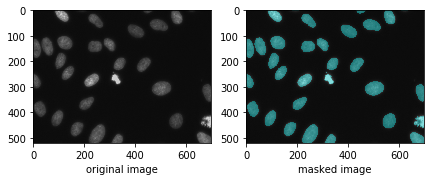

/home/biswajit/Documents/bima/unet/data/train/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51/images/5d75a63972ef643efd7c42f20668b167f2af43635d6263962d84e62e7609ab51.png


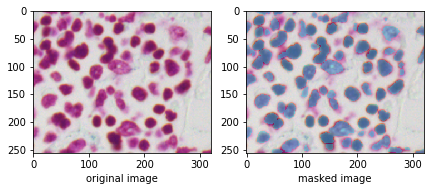

/home/biswajit/Documents/bima/unet/data/train/308084bdd358e0bd3dc7f2b409d6f34cc119bce30216f44667fc2be43ff31722/images/308084bdd358e0bd3dc7f2b409d6f34cc119bce30216f44667fc2be43ff31722.png


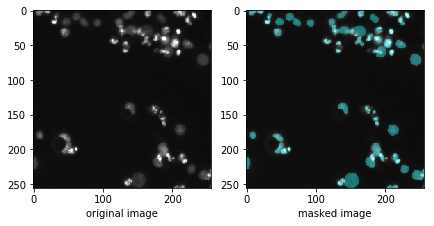

/home/biswajit/Documents/bima/unet/data/train/6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc/images/6f8197baf738986a1ec3b6ba92b567863d897a739376b7cec5599ad6cecafdfc.png


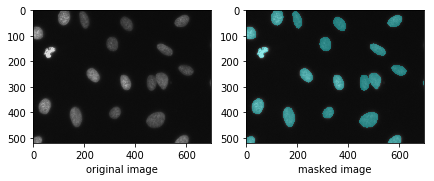

/home/biswajit/Documents/bima/unet/data/train/245b995878370ef4ea977568b2b67f93d4ecaa9308761b9d3e148e0803780183/images/245b995878370ef4ea977568b2b67f93d4ecaa9308761b9d3e148e0803780183.png


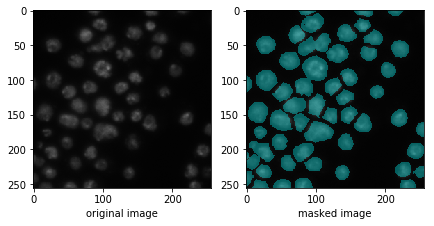

/home/biswajit/Documents/bima/unet/data/train/4cbd6c37f3a55a538d759d440344c287cac66260d3047a83f429e63e7a0f7f20/images/4cbd6c37f3a55a538d759d440344c287cac66260d3047a83f429e63e7a0f7f20.png


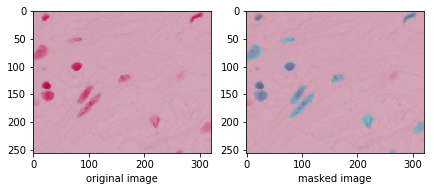

/home/biswajit/Documents/bima/unet/data/train/d4d88391bc399a3715440d4da9f8b7a973e010dc1edd9551df2e5a538685add5/images/d4d88391bc399a3715440d4da9f8b7a973e010dc1edd9551df2e5a538685add5.png


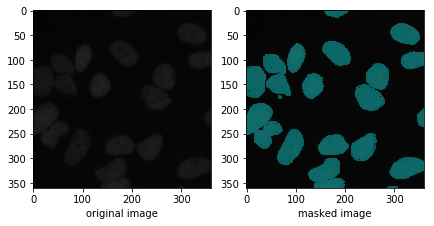

/home/biswajit/Documents/bima/unet/data/train/eb96fc6cbf6880bf05c4309857ae33844a4bc2152e228eff31024e5265cf9fc3/images/eb96fc6cbf6880bf05c4309857ae33844a4bc2152e228eff31024e5265cf9fc3.png


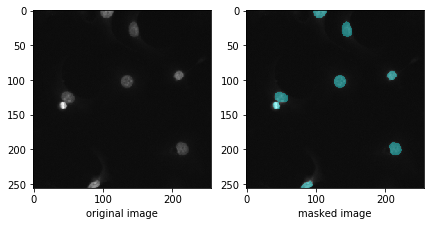

/home/biswajit/Documents/bima/unet/data/train/da79a2b105f055ce75404a04bf53bbb51d518d9381af7b4ac714c137f101d920/images/da79a2b105f055ce75404a04bf53bbb51d518d9381af7b4ac714c137f101d920.png


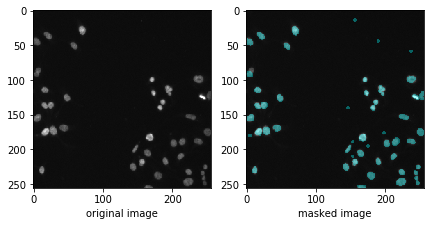

/home/biswajit/Documents/bima/unet/data/train/0d2bf916cc8de90d02f4cd4c23ea79b227dbc45d845b4124ffea380c92d34c8c/images/0d2bf916cc8de90d02f4cd4c23ea79b227dbc45d845b4124ffea380c92d34c8c.png


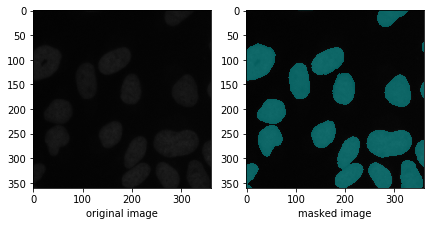

/home/biswajit/Documents/bima/unet/data/train/d1dbc6ee7c44a7027e935d040e496793186b884a1028d0e26284a206c6f5aff0/images/d1dbc6ee7c44a7027e935d040e496793186b884a1028d0e26284a206c6f5aff0.png


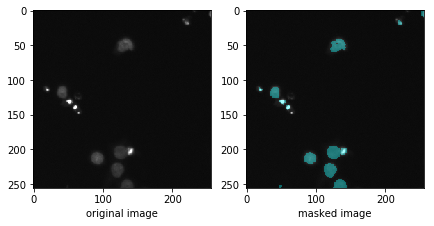

/home/biswajit/Documents/bima/unet/data/train/4185b9369fc8bdcc7e7c68f2129b9a7442237cd0f836a4b6d13ef64bf0ef572a/images/4185b9369fc8bdcc7e7c68f2129b9a7442237cd0f836a4b6d13ef64bf0ef572a.png


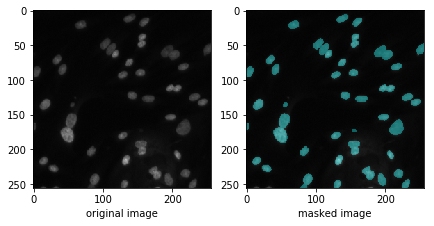

/home/biswajit/Documents/bima/unet/data/train/3934a094e8537841e973342c7f8880606f7a2712b14930340d6f6c2afe178c25/images/3934a094e8537841e973342c7f8880606f7a2712b14930340d6f6c2afe178c25.png


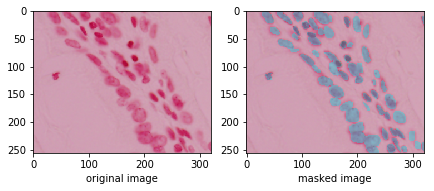

/home/biswajit/Documents/bima/unet/data/train/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a/images/8c3ef7aa7ed29b62a65b1c394d2b4a24aa3da25aebfdf3d29dbfc8ad1b08e95a.png


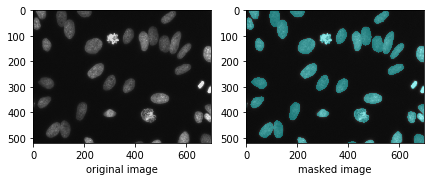

/home/biswajit/Documents/bima/unet/data/train/dabfee30b46d23569c63fa7253ef10b2407fbe8023035a5030252313cb718097/images/dabfee30b46d23569c63fa7253ef10b2407fbe8023035a5030252313cb718097.png


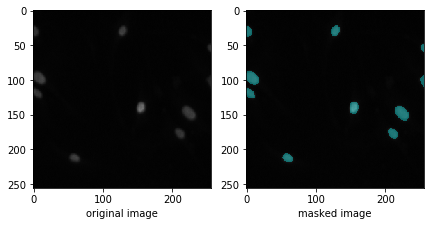

/home/biswajit/Documents/bima/unet/data/train/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac/images/b1f23c4d27afed8af7b6b64793a3760bfea31b65f582d48aaa62d2b988ef2eac.png


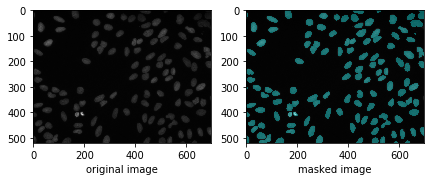

/home/biswajit/Documents/bima/unet/data/train/0a7d30b252359a10fd298b638b90cb9ada3acced4e0c0e5a3692013f432ee4e9/images/0a7d30b252359a10fd298b638b90cb9ada3acced4e0c0e5a3692013f432ee4e9.png


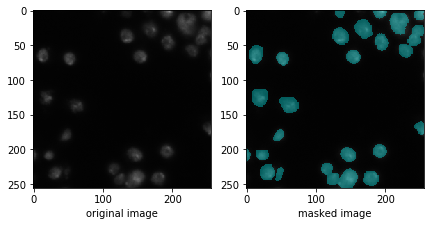

/home/biswajit/Documents/bima/unet/data/train/30f65741053db713b3f328d31d3234b6fedbe31df65c1a8ea29be28146cab789/images/30f65741053db713b3f328d31d3234b6fedbe31df65c1a8ea29be28146cab789.png


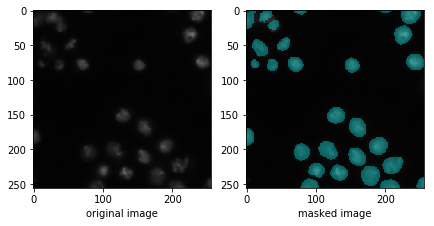

/home/biswajit/Documents/bima/unet/data/train/b1eb0123fe2d8c825694b193efb7b923d95effac9558ee4eaf3116374c2c94fe/images/b1eb0123fe2d8c825694b193efb7b923d95effac9558ee4eaf3116374c2c94fe.png


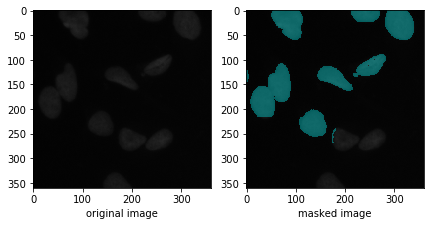

/home/biswajit/Documents/bima/unet/data/train/d751ccb64fa767a65a966061218438bd1860695d96bbef11fdb2f0d3b8dedba8/images/d751ccb64fa767a65a966061218438bd1860695d96bbef11fdb2f0d3b8dedba8.png


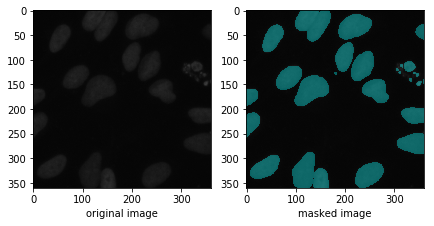

/home/biswajit/Documents/bima/unet/data/train/e856511ac1c34d24320eb7c56c05a4a3340d06667b4f5b8e8df615d415c7f650/images/e856511ac1c34d24320eb7c56c05a4a3340d06667b4f5b8e8df615d415c7f650.png


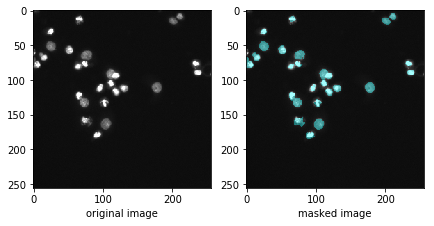

/home/biswajit/Documents/bima/unet/data/train/8ecdb93582b2d5270457b36651b62776256ade3aaa2d7432ae65c14f07432d49/images/8ecdb93582b2d5270457b36651b62776256ade3aaa2d7432ae65c14f07432d49.png


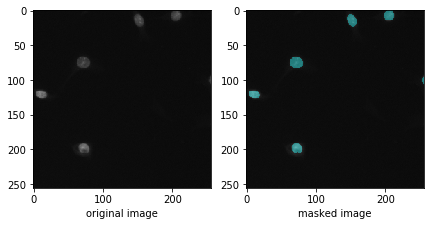

/home/biswajit/Documents/bima/unet/data/train/1609b1b8480ee52652a644403b3f7d5511410a016750aa3b9a4c8ddb3e893e8e/images/1609b1b8480ee52652a644403b3f7d5511410a016750aa3b9a4c8ddb3e893e8e.png


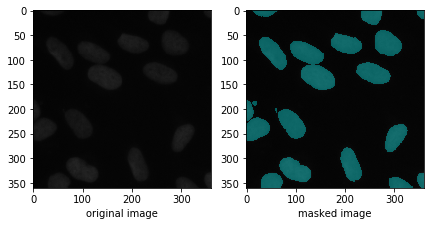

/home/biswajit/Documents/bima/unet/data/train/1631352dbafb8a90f11219fffd3bea368a30bc3bad3bbe0e84e19bd720df4945/images/1631352dbafb8a90f11219fffd3bea368a30bc3bad3bbe0e84e19bd720df4945.png


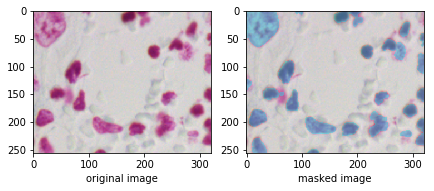

/home/biswajit/Documents/bima/unet/data/train/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df/images/1b44d22643830cd4f23c9deadb0bd499fb392fb2cd9526d81547d93077d983df.png


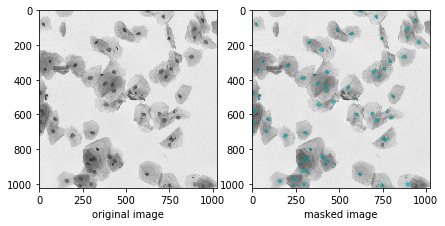

/home/biswajit/Documents/bima/unet/data/train/785555c0cbb49dad835635217085287a8cc61c27d26f0e106b70c1dfd05784dc/images/785555c0cbb49dad835635217085287a8cc61c27d26f0e106b70c1dfd05784dc.png


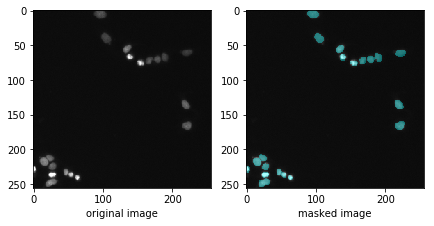

/home/biswajit/Documents/bima/unet/data/train/670ebd9d674be236b9bf0b28650ad3f68e1891b06e16a9021fd069ca7ef32b78/images/670ebd9d674be236b9bf0b28650ad3f68e1891b06e16a9021fd069ca7ef32b78.png


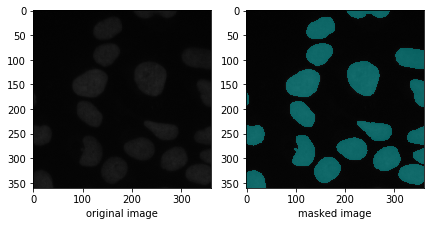

/home/biswajit/Documents/bima/unet/data/train/2a2032c4ed78f3fc64de7e5efd0bec26a81680b07404eaa54a1744b7ab3f8365/images/2a2032c4ed78f3fc64de7e5efd0bec26a81680b07404eaa54a1744b7ab3f8365.png


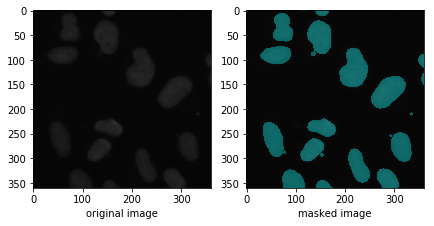

/home/biswajit/Documents/bima/unet/data/train/03b9306f44e9b8951461623dcbd615550cdcf36ea93b203f2c8fa58ed1dffcbe/images/03b9306f44e9b8951461623dcbd615550cdcf36ea93b203f2c8fa58ed1dffcbe.png


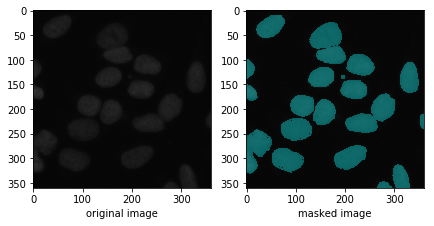

/home/biswajit/Documents/bima/unet/data/train/431b9b0c520a28375b5a0c18d0a5039dd62cbca7c4a0bcc25af3b763d4a81bec/images/431b9b0c520a28375b5a0c18d0a5039dd62cbca7c4a0bcc25af3b763d4a81bec.png


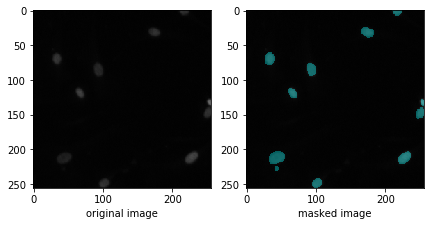

/home/biswajit/Documents/bima/unet/data/train/5cc036b65f7f2d5480e2be111a561f3713ac021683a9a9138dc49492a29ce856/images/5cc036b65f7f2d5480e2be111a561f3713ac021683a9a9138dc49492a29ce856.png


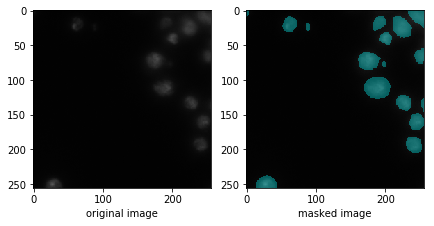

/home/biswajit/Documents/bima/unet/data/train/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72/images/c395870ad9f5a3ae651b50efab9b20c3e6b9aea15d4c731eb34c0cf9e3800a72.png


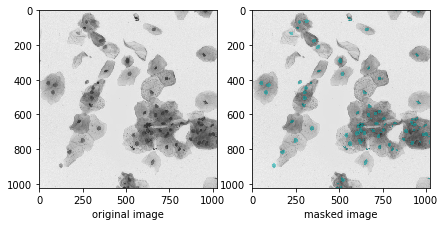

/home/biswajit/Documents/bima/unet/data/train/dbe5ad05b6f87018159a3228c1d1725892a1bfb9fa9f8fcc2e8bfe70d69d0355/images/dbe5ad05b6f87018159a3228c1d1725892a1bfb9fa9f8fcc2e8bfe70d69d0355.png


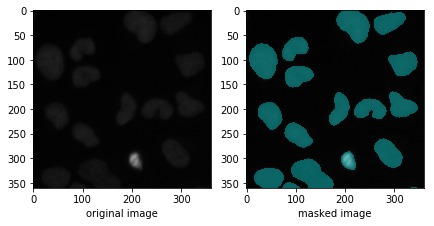

/home/biswajit/Documents/bima/unet/data/train/ba3997edd3fcb2f823ecdf870d2b607f08bff848f72a5cf72340bae5aca7c5ce/images/ba3997edd3fcb2f823ecdf870d2b607f08bff848f72a5cf72340bae5aca7c5ce.png


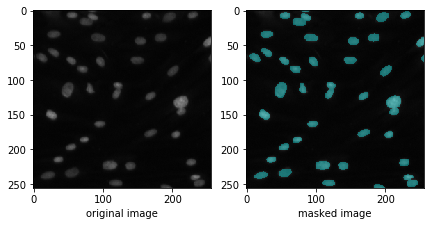

/home/biswajit/Documents/bima/unet/data/train/33d0a9b24c25852ce35274b4b1777484ccd21f44dbe35491cc926e5948c1ce3e/images/33d0a9b24c25852ce35274b4b1777484ccd21f44dbe35491cc926e5948c1ce3e.png


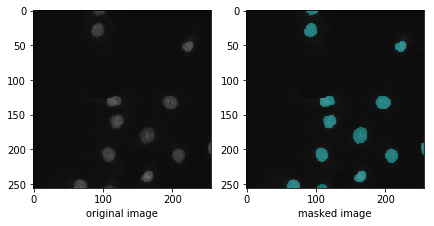

/home/biswajit/Documents/bima/unet/data/train/6d327ab4f0e3604fa6e9b8041c7e6db86ab809890d886c691f6e59c9168b7fbe/images/6d327ab4f0e3604fa6e9b8041c7e6db86ab809890d886c691f6e59c9168b7fbe.png


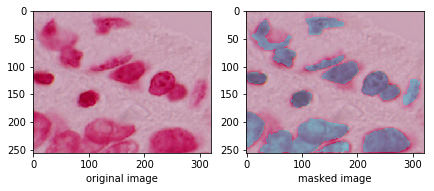

/home/biswajit/Documents/bima/unet/data/train/ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72/images/ea00f5a91ca75e745d675201cc62d7db266f8e2787033e15a7dd5f1cc5c0ad72.png


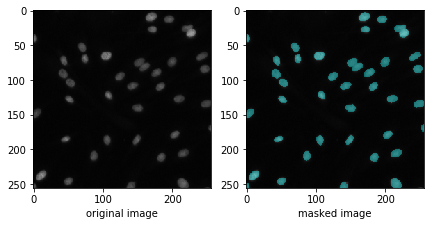

/home/biswajit/Documents/bima/unet/data/train/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd/images/cbca32daaae36a872a11da4eaff65d1068ff3f154eedc9d3fc0c214a4e5d32bd.png


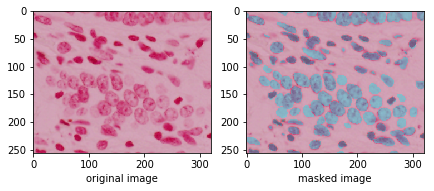

/home/biswajit/Documents/bima/unet/data/train/34c9f4eb2af8b8f46b1d88b74bde16f4614cd08948c2f1d817eb629afc512e7a/images/34c9f4eb2af8b8f46b1d88b74bde16f4614cd08948c2f1d817eb629afc512e7a.png


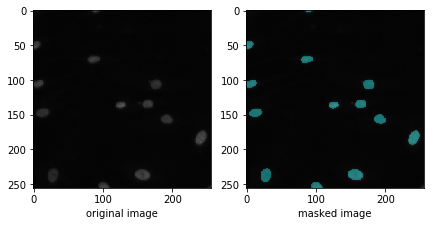

/home/biswajit/Documents/bima/unet/data/train/8175a55b711c948fe383bd3b91b6ca1b9e048a5241e0be13aff31ce2674fbe6d/images/8175a55b711c948fe383bd3b91b6ca1b9e048a5241e0be13aff31ce2674fbe6d.png


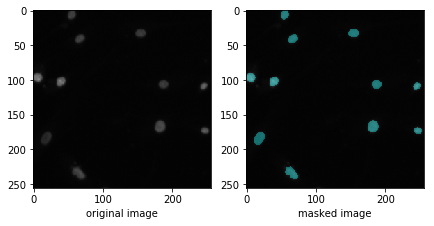

/home/biswajit/Documents/bima/unet/data/train/fe80a2cf3c93dafad8c364fdd1646b0ba4db056cdb7bdb81474f957064812bba/images/fe80a2cf3c93dafad8c364fdd1646b0ba4db056cdb7bdb81474f957064812bba.png


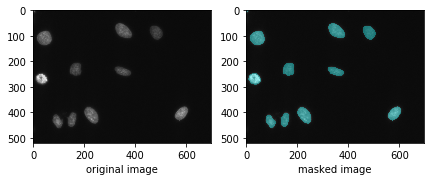

/home/biswajit/Documents/bima/unet/data/train/853a4c67900c411abd04467f7bc7813d3c58a5f565c8b0807e13c6e6dea21344/images/853a4c67900c411abd04467f7bc7813d3c58a5f565c8b0807e13c6e6dea21344.png


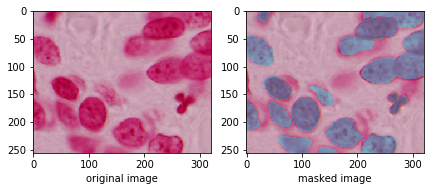

/home/biswajit/Documents/bima/unet/data/train/b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313/images/b1a239838c7dbb34ffea851ad537899f24da62f4e3f3fd6d835ff7b922f27313.png


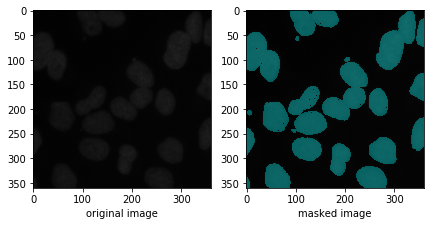

/home/biswajit/Documents/bima/unet/data/train/fc345dac2205deb169bd70197f07f053bada80b61ffa69fdfb490758323ead69/images/fc345dac2205deb169bd70197f07f053bada80b61ffa69fdfb490758323ead69.png


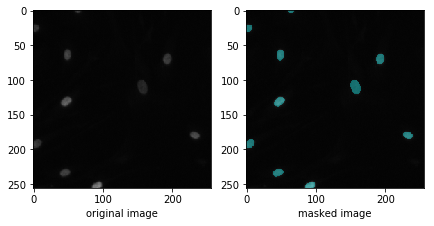

/home/biswajit/Documents/bima/unet/data/train/6af82abb29539000be4696884fc822d3cafcb2105906dc7582c92dccad8948c5/images/6af82abb29539000be4696884fc822d3cafcb2105906dc7582c92dccad8948c5.png


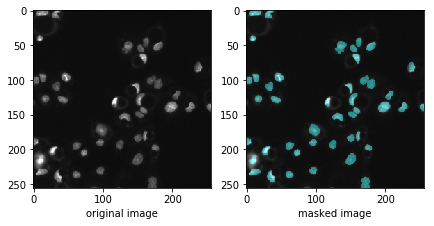

/home/biswajit/Documents/bima/unet/data/train/8aa1a883f61f0bb5af3d3d60acaaf33af45ef4fbffaac15ae838bc1ce37b6fbf/images/8aa1a883f61f0bb5af3d3d60acaaf33af45ef4fbffaac15ae838bc1ce37b6fbf.png


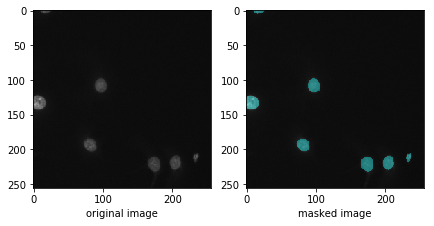

/home/biswajit/Documents/bima/unet/data/train/0b0d577159f0d6c266f360f7b8dfde46e16fa665138bf577ec3c6f9c70c0cd1e/images/0b0d577159f0d6c266f360f7b8dfde46e16fa665138bf577ec3c6f9c70c0cd1e.png


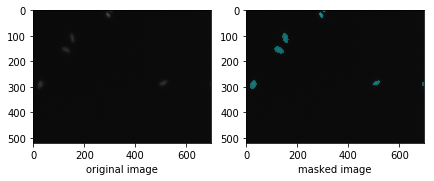

/home/biswajit/Documents/bima/unet/data/train/8b77284d6f37ab3fc826139ebadaec3b9d81c552fe525c3547bbbd6c65ac0d83/images/8b77284d6f37ab3fc826139ebadaec3b9d81c552fe525c3547bbbd6c65ac0d83.png


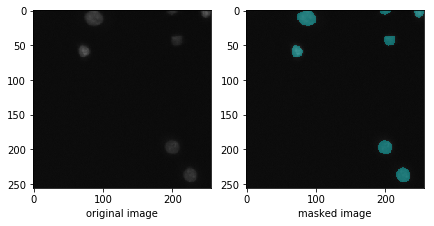

/home/biswajit/Documents/bima/unet/data/train/e4ae1ceddb279bac30273ca7ac480025ce2e7287328f5272234b5bbca6d13135/images/e4ae1ceddb279bac30273ca7ac480025ce2e7287328f5272234b5bbca6d13135.png


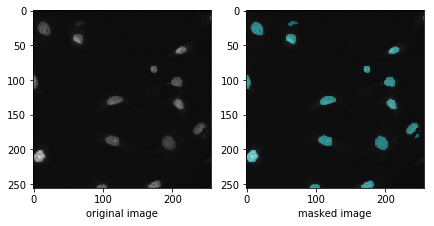

/home/biswajit/Documents/bima/unet/data/train/f93ec5e683d81005ffc2a84a1c0299b2406ad14b764b824e013f7ca3a13833b5/images/f93ec5e683d81005ffc2a84a1c0299b2406ad14b764b824e013f7ca3a13833b5.png


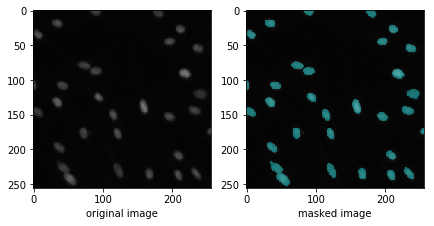

/home/biswajit/Documents/bima/unet/data/train/e66f25e175abab08ecb4e5f6859db64a211e0ddffb262d7e727b9d9bd4aad2d2/images/e66f25e175abab08ecb4e5f6859db64a211e0ddffb262d7e727b9d9bd4aad2d2.png


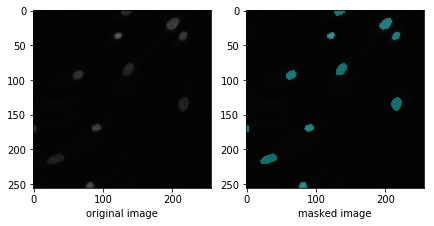

/home/biswajit/Documents/bima/unet/data/train/52a4ac5a875be7a6c886035d54fb63f5f397dc43508c4831898f6b2f8debc7f3/images/52a4ac5a875be7a6c886035d54fb63f5f397dc43508c4831898f6b2f8debc7f3.png


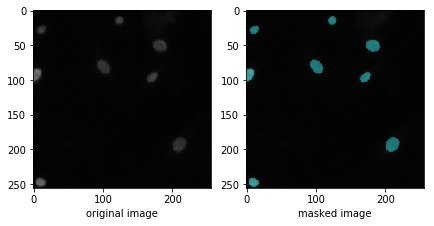

/home/biswajit/Documents/bima/unet/data/train/a4c729efb5059893a8b62c7abeba171cb516836f8a20468f6b176dfe2f6f84d1/images/a4c729efb5059893a8b62c7abeba171cb516836f8a20468f6b176dfe2f6f84d1.png


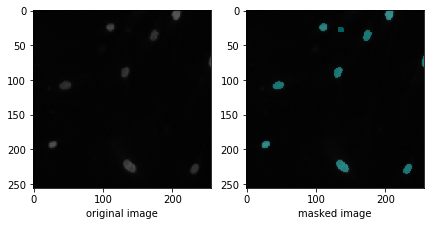

/home/biswajit/Documents/bima/unet/data/train/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f/images/150b0ffa318c87b31d78af0e87d60390dbcd84b5f228a8c1fb3225cbe5df3e3f.png


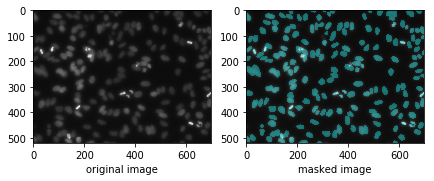

/home/biswajit/Documents/bima/unet/data/train/aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0/images/aa58ba4512955771b4f9b459cb4e6a8adb71d11cd6cae662ec2df31d688a5fe0.png


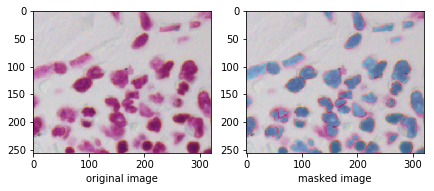

/home/biswajit/Documents/bima/unet/data/train/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1/images/76faaed50ed6ea6814ac36199964b86fb09ba7f41a6f213bceaa80d625adc2e1.png


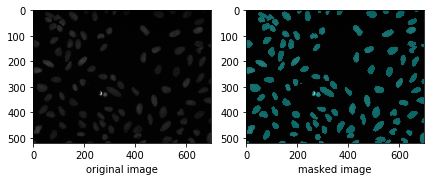

/home/biswajit/Documents/bima/unet/data/train/b2c23ddb04531158da6a0abcaca78fec0ae5c6f64f60166e4f36f4a161efd76f/images/b2c23ddb04531158da6a0abcaca78fec0ae5c6f64f60166e4f36f4a161efd76f.png


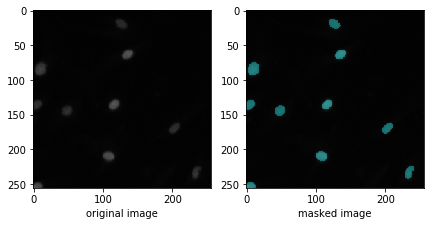

/home/biswajit/Documents/bima/unet/data/train/27c30f9011492f234e4587c9a4b53c787037d486f658821196fe354240ac3c47/images/27c30f9011492f234e4587c9a4b53c787037d486f658821196fe354240ac3c47.png


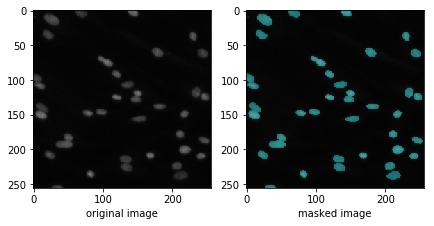

/home/biswajit/Documents/bima/unet/data/train/5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053/images/5d2c98fd6fda3c7d739461c3b3d4a0c7f8456121a14519dc5955a1775227b053.png


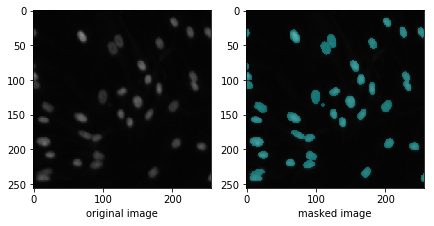

/home/biswajit/Documents/bima/unet/data/train/fec226e45f49ab81ab71e0eaa1248ba09b56a328338dce93a43f4044eababed5/images/fec226e45f49ab81ab71e0eaa1248ba09b56a328338dce93a43f4044eababed5.png


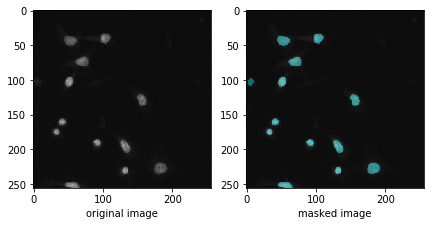

/home/biswajit/Documents/bima/unet/data/train/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f/images/20b20ab049372d184c705acebe7af026d3580f5fd5a72ed796e3622e1685af2f.png


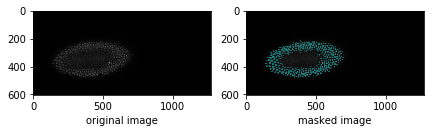

/home/biswajit/Documents/bima/unet/data/train/a22b7882fa85b9f0fcef659a7b82bfcddf01710f9a7617a9e036e84ac6901841/images/a22b7882fa85b9f0fcef659a7b82bfcddf01710f9a7617a9e036e84ac6901841.png


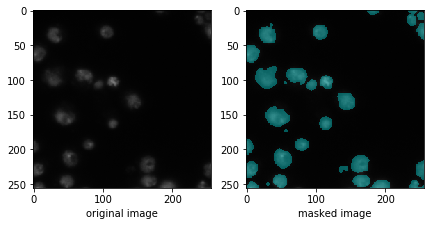

/home/biswajit/Documents/bima/unet/data/train/2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2/images/2abc40c118bc7303592c8bb95a80361e27560854b8971ab34dcf91966575b1f2.png


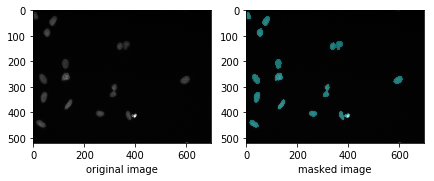

/home/biswajit/Documents/bima/unet/data/train/35ca5f142a7d7a3e4b59f1a767a31f87cb00d66348226bc64094ee3d1e46531c/images/35ca5f142a7d7a3e4b59f1a767a31f87cb00d66348226bc64094ee3d1e46531c.png


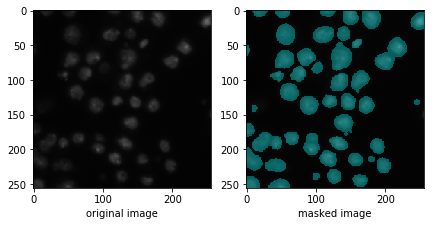

/home/biswajit/Documents/bima/unet/data/train/a022908f1b7880838dbc0411e50828e64b4f5e0263afdf04295e30bb2ff58005/images/a022908f1b7880838dbc0411e50828e64b4f5e0263afdf04295e30bb2ff58005.png


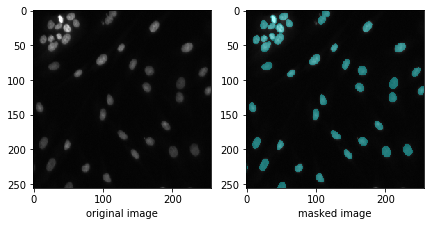

/home/biswajit/Documents/bima/unet/data/train/2bf594e9d06f78b4b79d7ffb395497a0a91126b6b0d710d7a9cee21f5c3bd177/images/2bf594e9d06f78b4b79d7ffb395497a0a91126b6b0d710d7a9cee21f5c3bd177.png


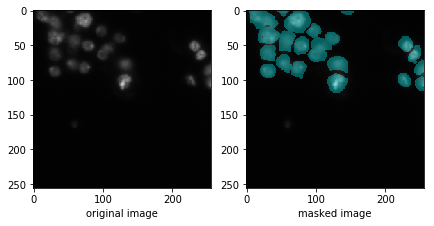

/home/biswajit/Documents/bima/unet/data/train/abc781c8721fe04b877a7e324494eb75aa5bce94950a0e4e4d7d6ffc9e74da62/images/abc781c8721fe04b877a7e324494eb75aa5bce94950a0e4e4d7d6ffc9e74da62.png


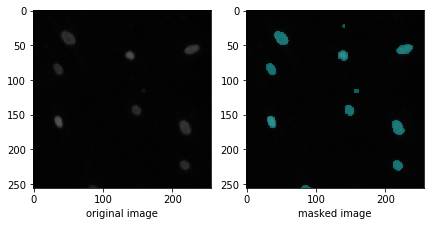

/home/biswajit/Documents/bima/unet/data/train/724b6b7044522f6d5ea35b55f8fa71d0a45a28687be2b7cac3149943ab816eec/images/724b6b7044522f6d5ea35b55f8fa71d0a45a28687be2b7cac3149943ab816eec.png


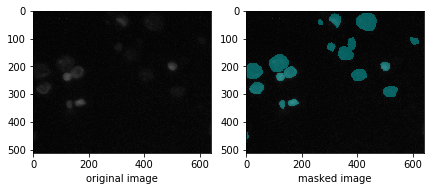

/home/biswajit/Documents/bima/unet/data/train/5afcbfd0dd64392aa1e233b996d0bfb4354ee7119f30ae111c33d0fe4df11590/images/5afcbfd0dd64392aa1e233b996d0bfb4354ee7119f30ae111c33d0fe4df11590.png


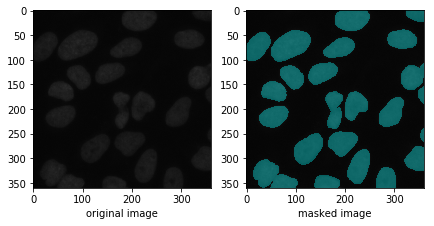

/home/biswajit/Documents/bima/unet/data/train/358e47eaa1e9222252793fe0fb8c77028d4e0d4360b95a07c9fe6df6a2066556/images/358e47eaa1e9222252793fe0fb8c77028d4e0d4360b95a07c9fe6df6a2066556.png


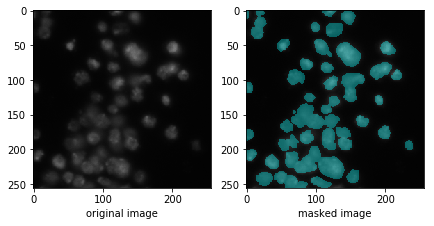

/home/biswajit/Documents/bima/unet/data/train/33a5b0ff232b425796ee6a9dd5b516ff9aad54ca723b4ec490bf5cd9b2e2a731/images/33a5b0ff232b425796ee6a9dd5b516ff9aad54ca723b4ec490bf5cd9b2e2a731.png


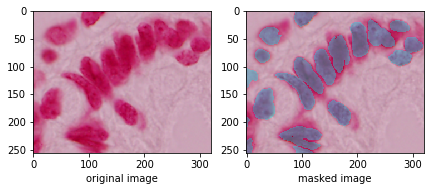

/home/biswajit/Documents/bima/unet/data/train/0ddd8deaf1696db68b00c600601c6a74a0502caaf274222c8367bdc31458ae7e/images/0ddd8deaf1696db68b00c600601c6a74a0502caaf274222c8367bdc31458ae7e.png


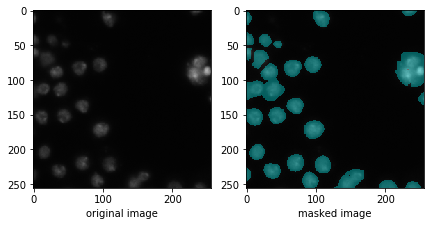

/home/biswajit/Documents/bima/unet/data/train/3bf7873f11823f4b64422f49c8248dd95c0d01f9ae9075ae3d233bbb21a3d875/images/3bf7873f11823f4b64422f49c8248dd95c0d01f9ae9075ae3d233bbb21a3d875.png


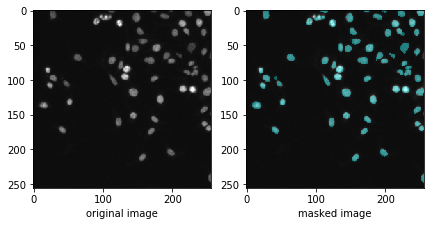

/home/biswajit/Documents/bima/unet/data/train/c89ac06daef5c819309f03d6a35792d1a8a66abb8cb3414013ffe71d3dd9fe96/images/c89ac06daef5c819309f03d6a35792d1a8a66abb8cb3414013ffe71d3dd9fe96.png


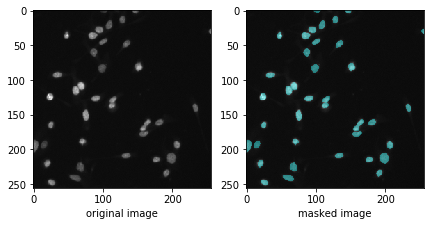

/home/biswajit/Documents/bima/unet/data/train/b2c5d8653c621207e97b699e5c4c05d13df4f02d9db3e594b1f0c22e5b746aae/images/b2c5d8653c621207e97b699e5c4c05d13df4f02d9db3e594b1f0c22e5b746aae.png


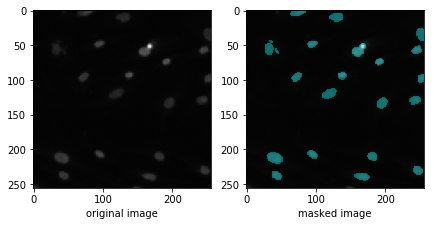

/home/biswajit/Documents/bima/unet/data/train/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974/images/5d21acedb3015c1208b31778561f8b1079cca7487399300390c3947f691e3974.png


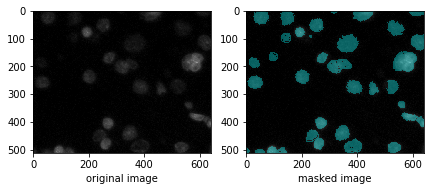

/home/biswajit/Documents/bima/unet/data/train/58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5/images/58cc121d37fb7f1b4a5252024d88415936781e540252b8f734faeedd29b682d5.png


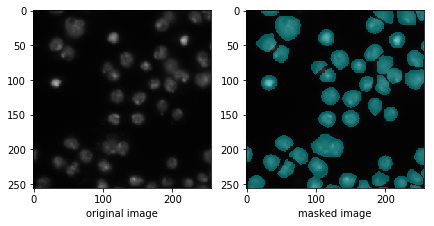

/home/biswajit/Documents/bima/unet/data/train/3b957237bc1e09740b58a414282393d3a91dde996b061e7061f4198fb03dab2e/images/3b957237bc1e09740b58a414282393d3a91dde996b061e7061f4198fb03dab2e.png


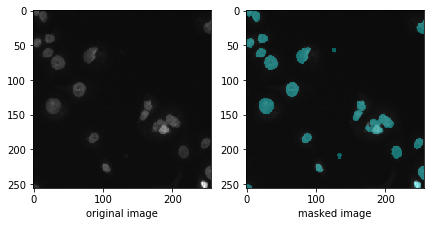

/home/biswajit/Documents/bima/unet/data/train/1c2f9e121fc207efff79d46390df1a740566b683ff56a96d8cabe830a398dd2e/images/1c2f9e121fc207efff79d46390df1a740566b683ff56a96d8cabe830a398dd2e.png


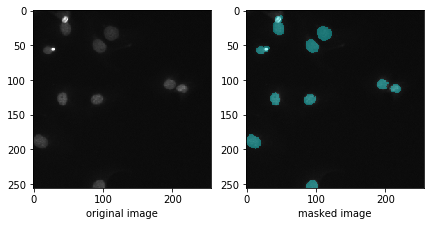

/home/biswajit/Documents/bima/unet/data/train/08151b19806eebd58e5acec7e138dbfbb1761f41a1ab9620466584ecc7d5fada/images/08151b19806eebd58e5acec7e138dbfbb1761f41a1ab9620466584ecc7d5fada.png


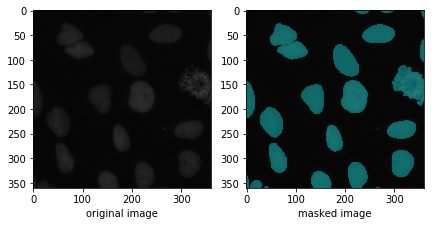

/home/biswajit/Documents/bima/unet/data/train/077f026f4ab0f0bcc0856644d99cbf639e443ec4f067d7b708bc6cecac609424/images/077f026f4ab0f0bcc0856644d99cbf639e443ec4f067d7b708bc6cecac609424.png


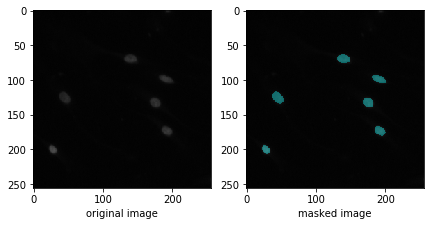

/home/biswajit/Documents/bima/unet/data/train/d0f2a00d3155c243048bc48944aef93fb08e2258d1fa5f9ccadd9140082bc22f/images/d0f2a00d3155c243048bc48944aef93fb08e2258d1fa5f9ccadd9140082bc22f.png


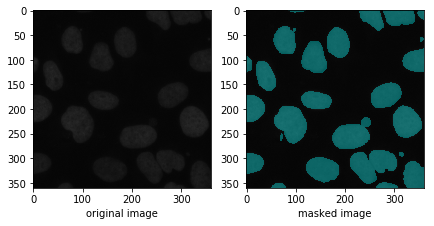

/home/biswajit/Documents/bima/unet/data/train/3b75fc03a1d12b29bd2870eb1f6fdb44174dbd1118dfc11c31f127bd87bd27ef/images/3b75fc03a1d12b29bd2870eb1f6fdb44174dbd1118dfc11c31f127bd87bd27ef.png


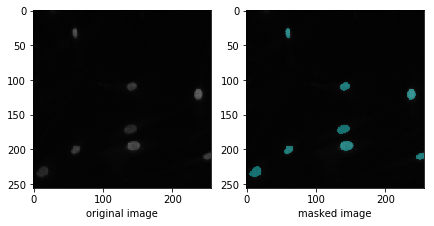

/home/biswajit/Documents/bima/unet/data/train/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d/images/5e263abff938acba1c0cff698261c7c00c23d7376e3ceacc3d5d4a655216b16d.png


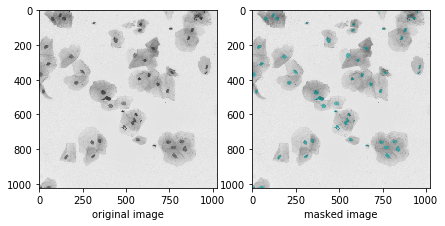

/home/biswajit/Documents/bima/unet/data/train/2e2d29fc44444a85049b162eb359a523dec108ccd5bd75022b25547491abf0c7/images/2e2d29fc44444a85049b162eb359a523dec108ccd5bd75022b25547491abf0c7.png


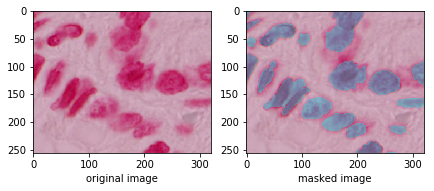

/home/biswajit/Documents/bima/unet/data/train/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e/images/00ae65c1c6631ae6f2be1a449902976e6eb8483bf6b0740d00530220832c6d3e.png


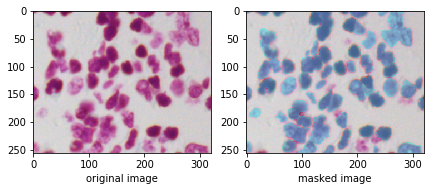

/home/biswajit/Documents/bima/unet/data/train/d2815f2f616d92be35c7e8dcfe592deec88516aef9ffc9b21257f52b7d6d0354/images/d2815f2f616d92be35c7e8dcfe592deec88516aef9ffc9b21257f52b7d6d0354.png


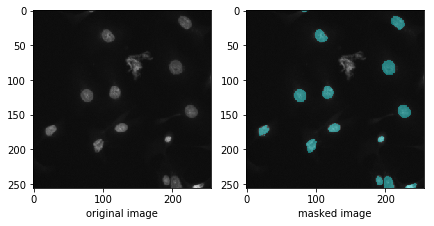

/home/biswajit/Documents/bima/unet/data/train/ce9e1a58b58940039ae841466198b72ea21cc90584039a9294b47f5aef17ddfa/images/ce9e1a58b58940039ae841466198b72ea21cc90584039a9294b47f5aef17ddfa.png


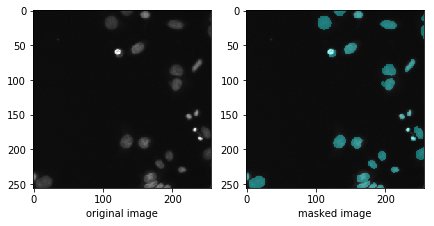

/home/biswajit/Documents/bima/unet/data/train/b7a86f4968071e0f963fa87ef314fdd1b6c73a66355431cc53a37e193ba6be9b/images/b7a86f4968071e0f963fa87ef314fdd1b6c73a66355431cc53a37e193ba6be9b.png


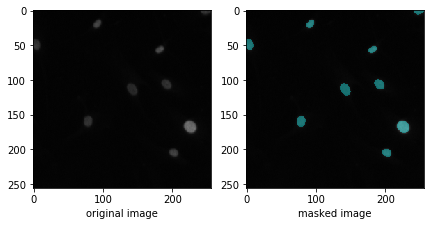

/home/biswajit/Documents/bima/unet/data/train/7f4d7b549d0f1a110191e2aded872943d85892bc30667f19fe9de97a5370b08e/images/7f4d7b549d0f1a110191e2aded872943d85892bc30667f19fe9de97a5370b08e.png


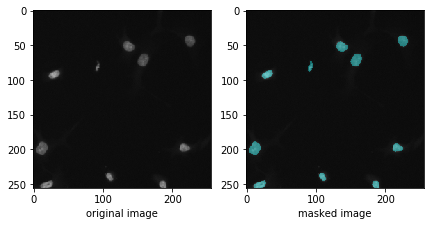

/home/biswajit/Documents/bima/unet/data/train/4948e3dfe0483c2198b9616612071ead5474dffd223071cf0a567aea9aca0b9e/images/4948e3dfe0483c2198b9616612071ead5474dffd223071cf0a567aea9aca0b9e.png


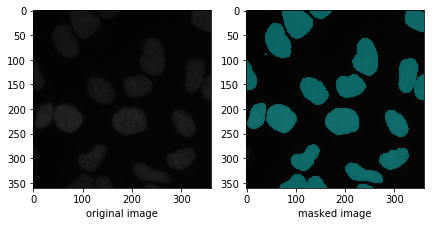

/home/biswajit/Documents/bima/unet/data/train/751f421d322940d6efe3bd570a66ecda16d08a1b90bc32a6d7ae1af89856fd49/images/751f421d322940d6efe3bd570a66ecda16d08a1b90bc32a6d7ae1af89856fd49.png


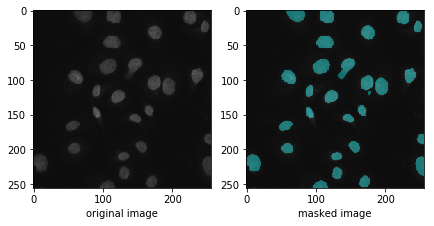

/home/biswajit/Documents/bima/unet/data/train/5c6eb9a47852754d4e45eceb9a696c64c7cfe304afc5ea491cdfef11d55c17f3/images/5c6eb9a47852754d4e45eceb9a696c64c7cfe304afc5ea491cdfef11d55c17f3.png


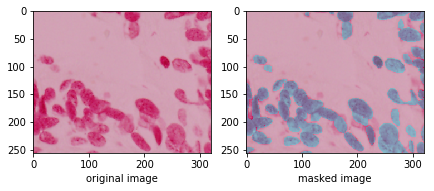

/home/biswajit/Documents/bima/unet/data/train/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1/images/0ea221716cf13710214dcd331a61cea48308c3940df1d28cfc7fd817c83714e1.png


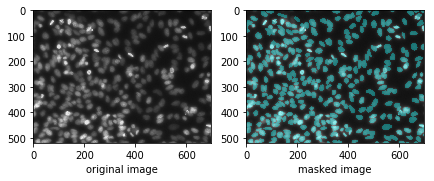

/home/biswajit/Documents/bima/unet/data/train/c322c72b9d411e631580fee9312885088b4bb14ed297aa4b246ec943533b3ffb/images/c322c72b9d411e631580fee9312885088b4bb14ed297aa4b246ec943533b3ffb.png


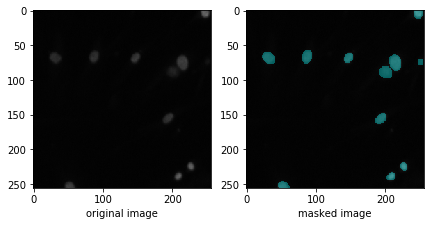

/home/biswajit/Documents/bima/unet/data/train/1c681dfa5cf7e413305d2e90ee47553a46e29cce4f6ed034c8297e511714f867/images/1c681dfa5cf7e413305d2e90ee47553a46e29cce4f6ed034c8297e511714f867.png


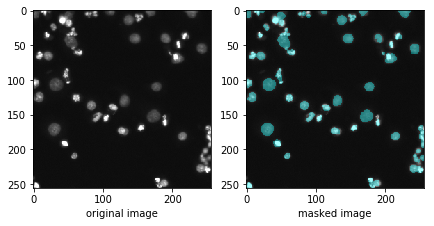

/home/biswajit/Documents/bima/unet/data/train/ee927e8255096971ddae1bd975cf80c4ad7c847c82d0b5f5dd2ddfe5407007ee/images/ee927e8255096971ddae1bd975cf80c4ad7c847c82d0b5f5dd2ddfe5407007ee.png


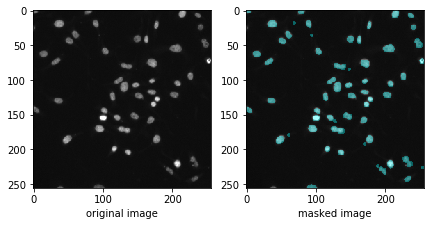

/home/biswajit/Documents/bima/unet/data/train/a08166d91d2cca263d2dd52764dc25c9c582b7a5ece2b802749fa4be33187c49/images/a08166d91d2cca263d2dd52764dc25c9c582b7a5ece2b802749fa4be33187c49.png


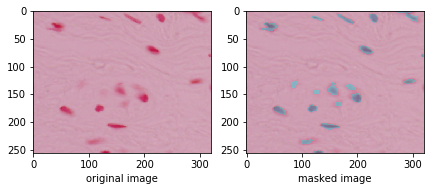

/home/biswajit/Documents/bima/unet/data/train/b0defa611b75645c0283464ee4163917bad382d335b61e8509f065bf371fa15f/images/b0defa611b75645c0283464ee4163917bad382d335b61e8509f065bf371fa15f.png


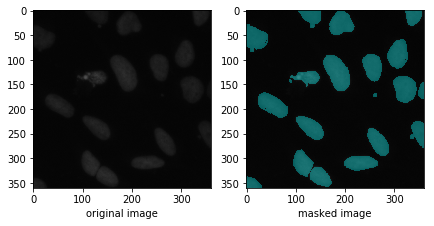

/home/biswajit/Documents/bima/unet/data/train/61a15ccbfebb9d2fc54c068472a75d7babfb3f48fea008470e7db807585f9510/images/61a15ccbfebb9d2fc54c068472a75d7babfb3f48fea008470e7db807585f9510.png


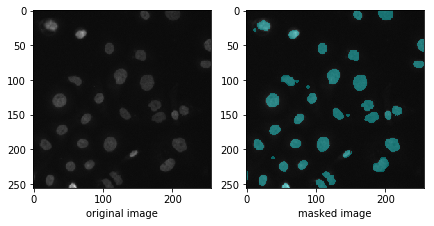

/home/biswajit/Documents/bima/unet/data/train/c35e6e3ea39a718e1b7aff66e4cc678efd662f9b5336b74d69c1d6bca7aaf288/images/c35e6e3ea39a718e1b7aff66e4cc678efd662f9b5336b74d69c1d6bca7aaf288.png


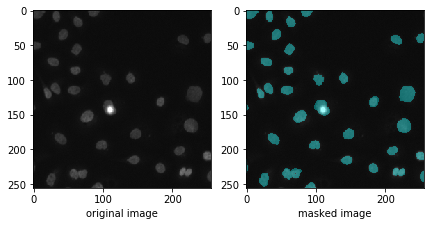

/home/biswajit/Documents/bima/unet/data/train/c96109cbebcf206f20035cbde414e43872074eee8d839ba214feed9cd36277a1/images/c96109cbebcf206f20035cbde414e43872074eee8d839ba214feed9cd36277a1.png


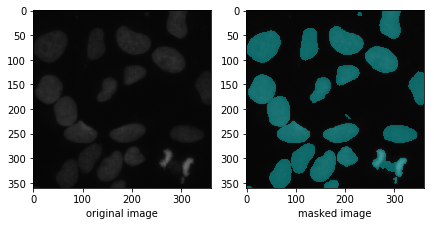

/home/biswajit/Documents/bima/unet/data/train/d827a7d80fc67487a3237135e0d43ae01b7bbcb135e1a167601fc974a8348c51/images/d827a7d80fc67487a3237135e0d43ae01b7bbcb135e1a167601fc974a8348c51.png


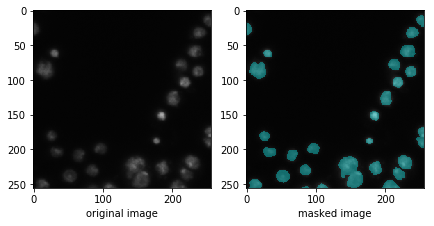

/home/biswajit/Documents/bima/unet/data/train/b82548ab19466b461614e6055aaf49fbc24c03a2d20e65575b680c7c28268807/images/b82548ab19466b461614e6055aaf49fbc24c03a2d20e65575b680c7c28268807.png


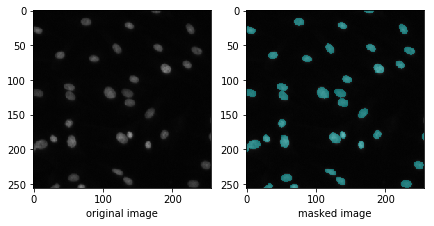

/home/biswajit/Documents/bima/unet/data/train/d7db360fabfce9828559a21f6bffff589ae868e0dc6101d7c1212de34a25e3cb/images/d7db360fabfce9828559a21f6bffff589ae868e0dc6101d7c1212de34a25e3cb.png


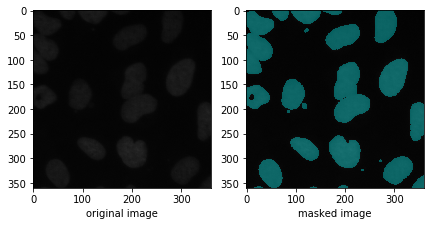

/home/biswajit/Documents/bima/unet/data/train/6bd330234b763b77796d4804de8e224881c0fc8dd02650fa708b2edfd8c7461f/images/6bd330234b763b77796d4804de8e224881c0fc8dd02650fa708b2edfd8c7461f.png


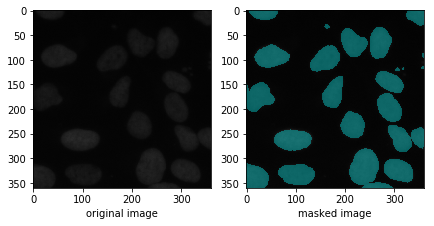

/home/biswajit/Documents/bima/unet/data/train/edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8/images/edd36ed822e7ed760ff73e0524df22aa5bf5c565efcdc6c39603239c0896e7a8.png


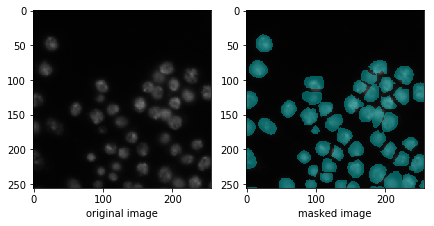

/home/biswajit/Documents/bima/unet/data/train/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699/images/6b72b61b80060a9e79a4747f9c5d5af135af9db466681c2d1086f784c7130699.png


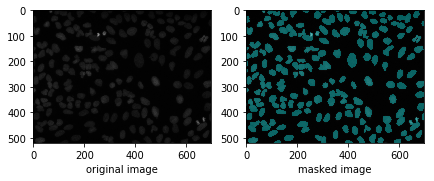

/home/biswajit/Documents/bima/unet/data/train/40b00d701695d8ea5d59f95ac39e18004040c96d17fbc1a539317c674eca084b/images/40b00d701695d8ea5d59f95ac39e18004040c96d17fbc1a539317c674eca084b.png


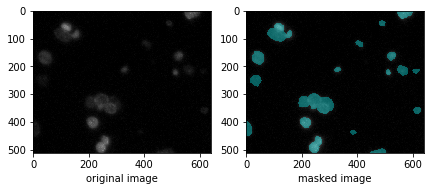

/home/biswajit/Documents/bima/unet/data/train/7ac468eb217b7058d22c1711285d21949b4121bf3fa3217e3e51453666ebecff/images/7ac468eb217b7058d22c1711285d21949b4121bf3fa3217e3e51453666ebecff.png


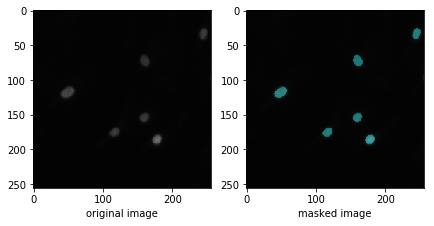

/home/biswajit/Documents/bima/unet/data/train/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1/images/b24ea5c268469a95ed155eeaf809e36030b78a2eb530a0cb2380cdc1ccdb7dd1.png


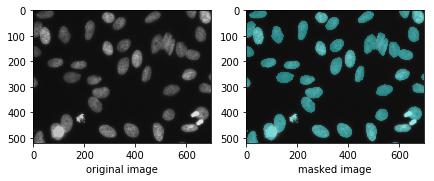

/home/biswajit/Documents/bima/unet/data/train/f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6/images/f01a9742c43a69f087700a43893f713878e537bae8e44f76b957f09519601ad6.png


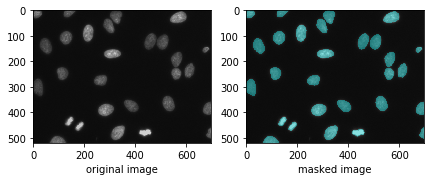

/home/biswajit/Documents/bima/unet/data/train/21408476af0506331e8b5d49b385833e5ef1fbb90815fbf9af9d19b4bb145f76/images/21408476af0506331e8b5d49b385833e5ef1fbb90815fbf9af9d19b4bb145f76.png


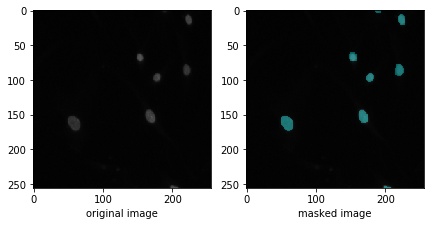

/home/biswajit/Documents/bima/unet/data/train/df33b11184427e05c8a450f921586685975fe975f57315e686a0f26fddb93db1/images/df33b11184427e05c8a450f921586685975fe975f57315e686a0f26fddb93db1.png


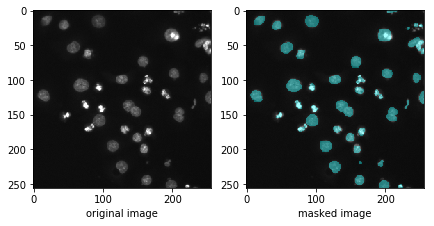

/home/biswajit/Documents/bima/unet/data/train/df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9/images/df5cdd0ebe1bdf8dc870bc294b8f08961e083bc7f9be69e268454aa9091808b9.png


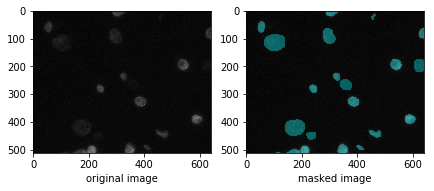

/home/biswajit/Documents/bima/unet/data/train/c169a7782a69ea2f38f64d2739de189e88adbcfd4a829721def8c89ecabe8b71/images/c169a7782a69ea2f38f64d2739de189e88adbcfd4a829721def8c89ecabe8b71.png


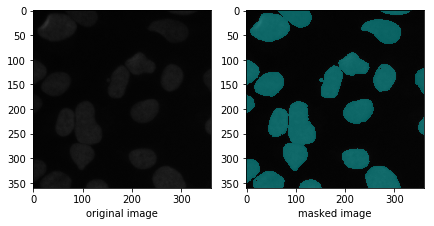

/home/biswajit/Documents/bima/unet/data/train/2255d5aba044256bb92f6b7cbed0fca46d972c7b6b1a59dcbe7f682c5777d074/images/2255d5aba044256bb92f6b7cbed0fca46d972c7b6b1a59dcbe7f682c5777d074.png


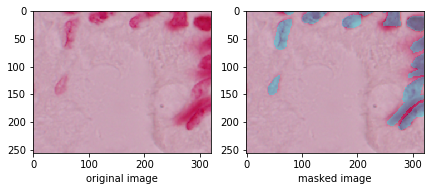

/home/biswajit/Documents/bima/unet/data/train/139946af9e2c7ef4f0298e622b831dbef5e5c0cd088eb5bc3382f8df9355443d/images/139946af9e2c7ef4f0298e622b831dbef5e5c0cd088eb5bc3382f8df9355443d.png


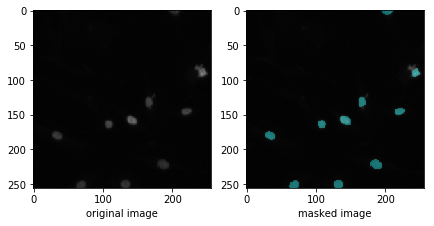

/home/biswajit/Documents/bima/unet/data/train/f67e72b7fe0b1e3648ea745ffd395c80705c89b0c0c48227991fe6f5815b2a18/images/f67e72b7fe0b1e3648ea745ffd395c80705c89b0c0c48227991fe6f5815b2a18.png


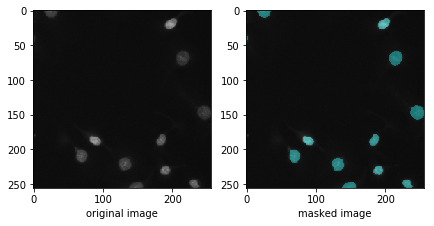

/home/biswajit/Documents/bima/unet/data/train/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149/images/4ee5850b63549794eb3ecd3d5f5673164ac16936e36ecc3700da886e3b616149.png


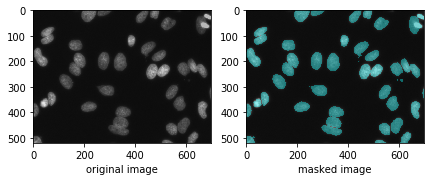

/home/biswajit/Documents/bima/unet/data/train/a6515d73077866808ad4cb837ecdac33612527b8a1041e82135e40fce2bb9380/images/a6515d73077866808ad4cb837ecdac33612527b8a1041e82135e40fce2bb9380.png


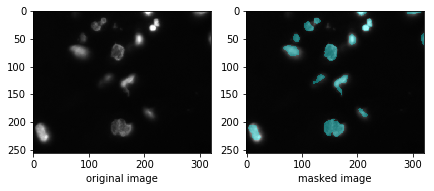

/home/biswajit/Documents/bima/unet/data/train/1e61ecf354cb93a62a9561db87a53985fb54e001444f98112ed0fc623fad793e/images/1e61ecf354cb93a62a9561db87a53985fb54e001444f98112ed0fc623fad793e.png


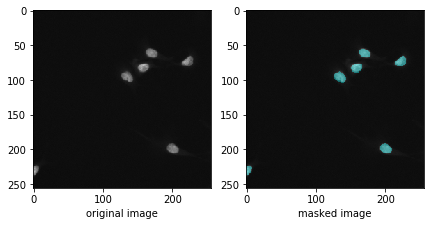

/home/biswajit/Documents/bima/unet/data/train/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770/images/7f38885521586fc6011bef1314a9fb2aa1e4935bd581b2991e1d963395eab770.png


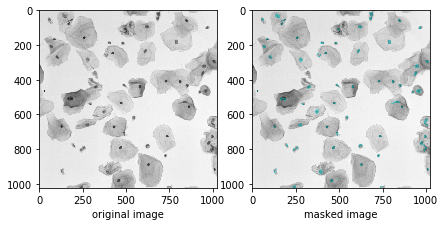

/home/biswajit/Documents/bima/unet/data/train/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e/images/5d58600efa0c2667ec85595bf456a54e2bd6e6e9a5c0dff42d807bc9fe2b822e.png


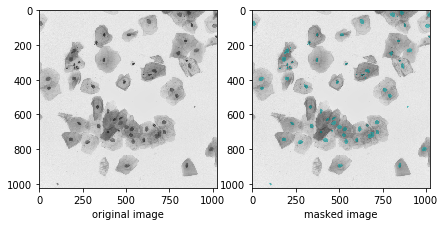

/home/biswajit/Documents/bima/unet/data/train/648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868/images/648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619039f678df67b526868.png


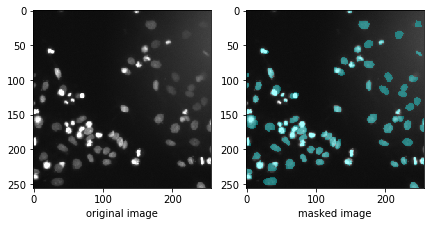

/home/biswajit/Documents/bima/unet/data/train/10328b822b836e67b547b4144e0b7eb43747c114ce4cacd8b540648892945b00/images/10328b822b836e67b547b4144e0b7eb43747c114ce4cacd8b540648892945b00.png


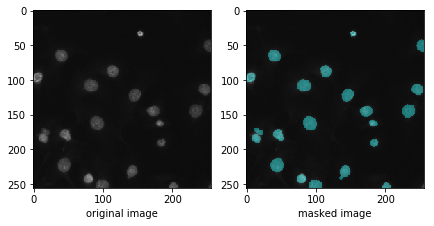

/home/biswajit/Documents/bima/unet/data/train/1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5/images/1f9e429c12f4477221b5b855a5f494fda2ef6d064ff75b061ffaf093e91758c5.png


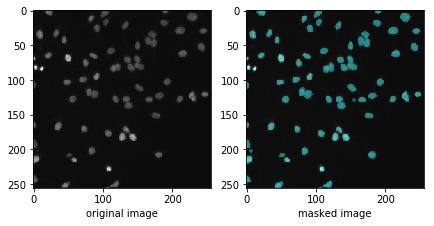

/home/biswajit/Documents/bima/unet/data/train/f73e37957c74f554be132986f38b6f1d75339f636dfe2b681a0cf3f88d2733af/images/f73e37957c74f554be132986f38b6f1d75339f636dfe2b681a0cf3f88d2733af.png


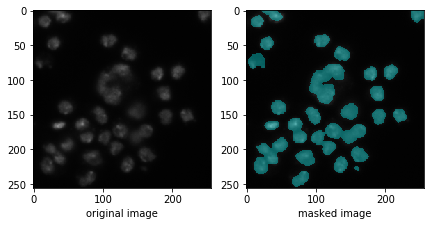

/home/biswajit/Documents/bima/unet/data/train/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f/images/958114e5f37d5e1420b410bd716753b3e874b175f2b6958ebf1ec2bdf776e41f.png


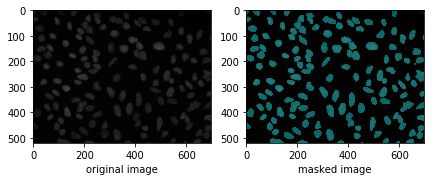

/home/biswajit/Documents/bima/unet/data/train/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e/images/3f9fc8e63f87e8a56d3eaef7db26f1b6db874d19f12abd5a752821b78d47661e.png


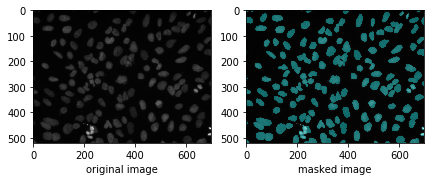

/home/biswajit/Documents/bima/unet/data/train/b0d6dfcc95e4d087d232378f860fc3ef9f95ea5a4c26d623a0be091f820a793f/images/b0d6dfcc95e4d087d232378f860fc3ef9f95ea5a4c26d623a0be091f820a793f.png


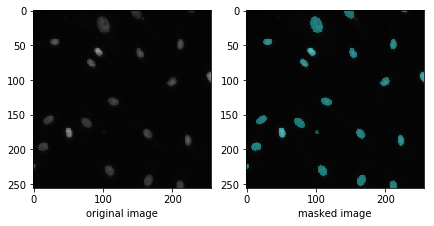

/home/biswajit/Documents/bima/unet/data/train/63d981a107091e1e3059102ce08870744dde173afe324bc2274c17d42f661778/images/63d981a107091e1e3059102ce08870744dde173afe324bc2274c17d42f661778.png


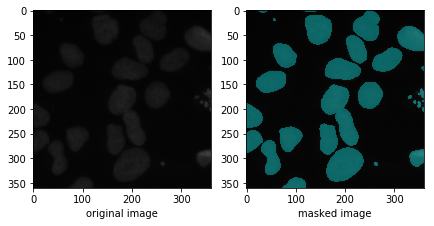

/home/biswajit/Documents/bima/unet/data/train/f81ca7ee25e733ff37240c34c8e3044d9937bb0166e315952ebde3f237ecb86f/images/f81ca7ee25e733ff37240c34c8e3044d9937bb0166e315952ebde3f237ecb86f.png


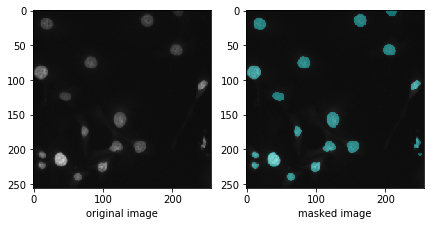

/home/biswajit/Documents/bima/unet/data/train/feffce59a1a3eb0a6a05992bb7423c39c7d52865846da36d89e2a72c379e5398/images/feffce59a1a3eb0a6a05992bb7423c39c7d52865846da36d89e2a72c379e5398.png


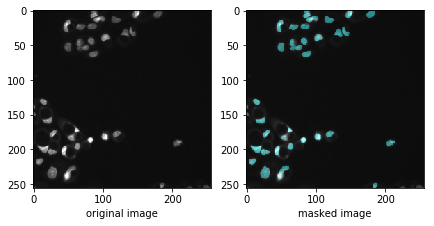

/home/biswajit/Documents/bima/unet/data/train/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948/images/8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691aa63ca16dbafae6f948.png


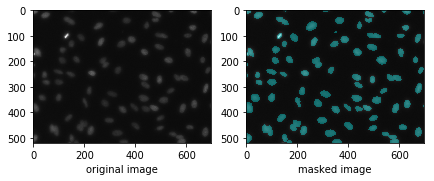

/home/biswajit/Documents/bima/unet/data/train/97126a9791f0c1176e4563ad679a301dac27c59011f579e808bbd6e9f4cd1034/images/97126a9791f0c1176e4563ad679a301dac27c59011f579e808bbd6e9f4cd1034.png


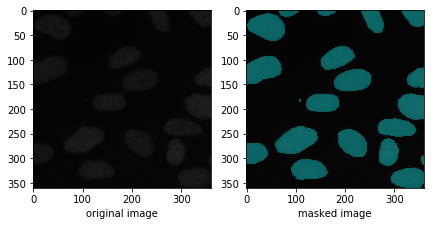

/home/biswajit/Documents/bima/unet/data/train/ac782d2cad7f515ce7276926209820e386248e3d619b2df81e22d5e3c160b7cb/images/ac782d2cad7f515ce7276926209820e386248e3d619b2df81e22d5e3c160b7cb.png


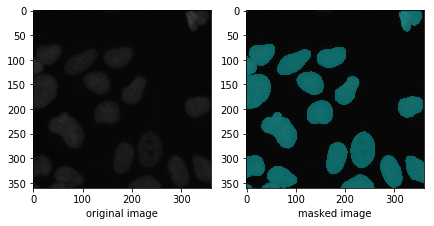

/home/biswajit/Documents/bima/unet/data/train/be771d6831e3f8f1af4696bc08a582f163735db5baf9906e4729acc6a05e1187/images/be771d6831e3f8f1af4696bc08a582f163735db5baf9906e4729acc6a05e1187.png


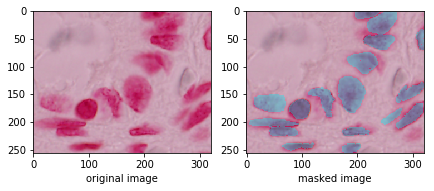

/home/biswajit/Documents/bima/unet/data/train/619429303c1af7540916509fe7900cf483eba4391b06aac87ff7f66ca1ab6483/images/619429303c1af7540916509fe7900cf483eba4391b06aac87ff7f66ca1ab6483.png


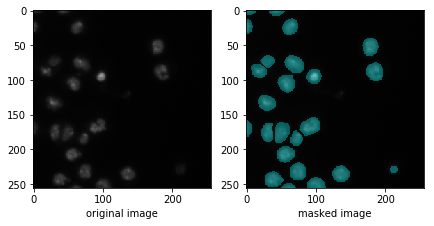

/home/biswajit/Documents/bima/unet/data/train/15039b3acccc4257a1a442646a89b6e596b5eb4531637e6d8fa1c43203722c99/images/15039b3acccc4257a1a442646a89b6e596b5eb4531637e6d8fa1c43203722c99.png


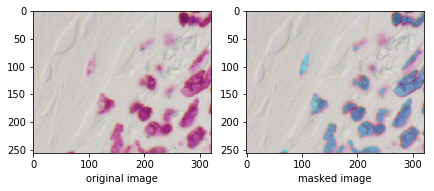

/home/biswajit/Documents/bima/unet/data/train/e1bcb583985325d0ef5f3ef52957d0371c96d4af767b13e48102bca9d5351a9b/images/e1bcb583985325d0ef5f3ef52957d0371c96d4af767b13e48102bca9d5351a9b.png


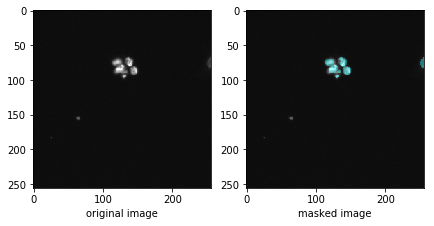

/home/biswajit/Documents/bima/unet/data/train/ef6634efb46567d87b811be786b18c4cd0e2cda23d79b65d6afe0d259ef3ade6/images/ef6634efb46567d87b811be786b18c4cd0e2cda23d79b65d6afe0d259ef3ade6.png


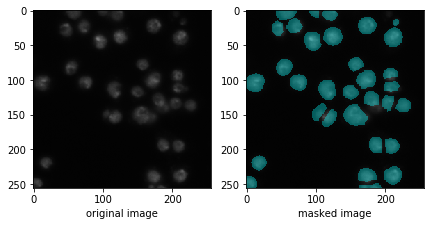

/home/biswajit/Documents/bima/unet/data/train/bfe8ef193a68a0a86a5e4ae1ddc27bda3f9ffe170494395be4030ba72737c565/images/bfe8ef193a68a0a86a5e4ae1ddc27bda3f9ffe170494395be4030ba72737c565.png


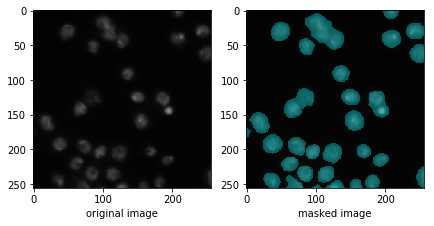

/home/biswajit/Documents/bima/unet/data/train/2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af/images/2dec81a678ddcac2b110acffe82427d857695180bd841e3f9736a554acf832af.png


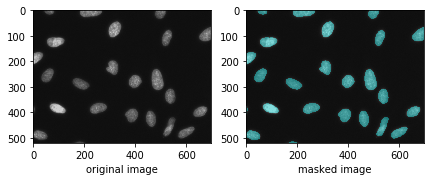

/home/biswajit/Documents/bima/unet/data/train/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0/images/94519eb45cbe1573252623b7ea06a8b43c19c930f5c9b685edb639d0db719ab0.png


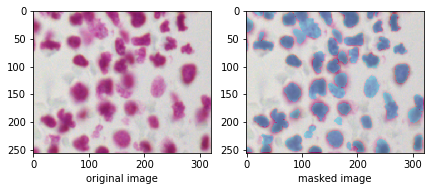

/home/biswajit/Documents/bima/unet/data/train/9d429167633b4d9d7f41544a461975cf8e688a3affa6a8916799202874809f2a/images/9d429167633b4d9d7f41544a461975cf8e688a3affa6a8916799202874809f2a.png


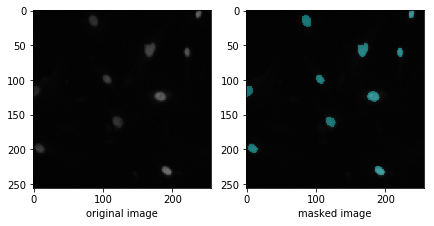

/home/biswajit/Documents/bima/unet/data/train/16c3d5935ba94b720becc24b7a05741c26149e221e3401924080f41e2f891368/images/16c3d5935ba94b720becc24b7a05741c26149e221e3401924080f41e2f891368.png


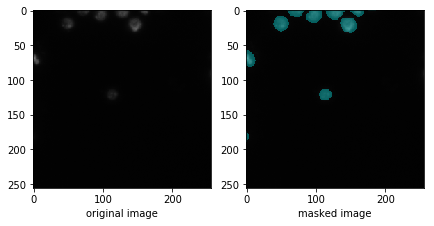

/home/biswajit/Documents/bima/unet/data/train/56d0da5b663ddd49955478c00ca03118c367ff7dd6a646b8c875b0acb207d1c5/images/56d0da5b663ddd49955478c00ca03118c367ff7dd6a646b8c875b0acb207d1c5.png


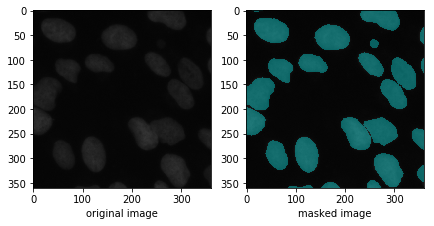

/home/biswajit/Documents/bima/unet/data/train/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050/images/947c0d94c8213ac7aaa41c4efc95d854246550298259cf1bb489654d0e969050.png


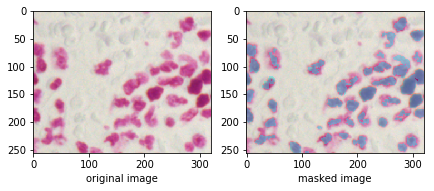

/home/biswajit/Documents/bima/unet/data/train/ac8169a0debed11560f3f0e246c05ea82d03c66346f1576cc8268554cb3f549f/images/ac8169a0debed11560f3f0e246c05ea82d03c66346f1576cc8268554cb3f549f.png


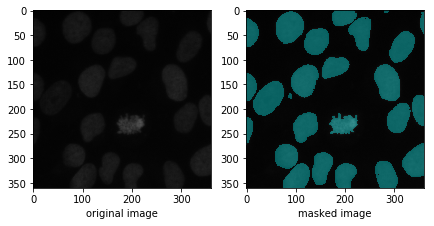

/home/biswajit/Documents/bima/unet/data/train/608ff81c8a0c8b622f6648a9c7f935d85f0c503f515ef2ac3728387be1953ee8/images/608ff81c8a0c8b622f6648a9c7f935d85f0c503f515ef2ac3728387be1953ee8.png


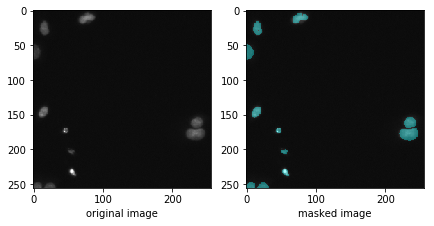

/home/biswajit/Documents/bima/unet/data/train/243443ae303cc09cfbea85bfd22b0c4f026342f3dfc3aa1076f27867910d025b/images/243443ae303cc09cfbea85bfd22b0c4f026342f3dfc3aa1076f27867910d025b.png


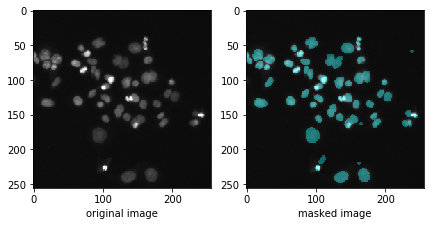

/home/biswajit/Documents/bima/unet/data/train/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5/images/1b518cd2ea84a389c267662840f3d902d0129fab27696215db2488de6d4316c5.png


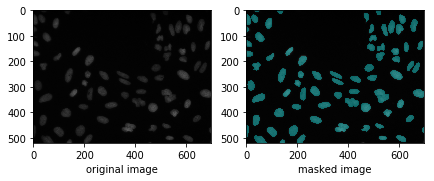

/home/biswajit/Documents/bima/unet/data/train/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771/images/718751b439c05bdd589f04fcef321a86be3ecb35292a435138e295e05eb2e771.png


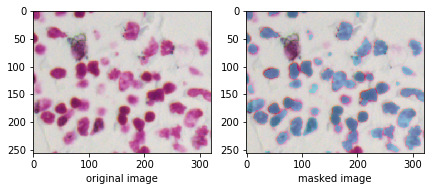

/home/biswajit/Documents/bima/unet/data/train/d7d12a2acc47a94961aeb56fd56e8a0873016af75f5dd10915de9db8af8e4f5e/images/d7d12a2acc47a94961aeb56fd56e8a0873016af75f5dd10915de9db8af8e4f5e.png


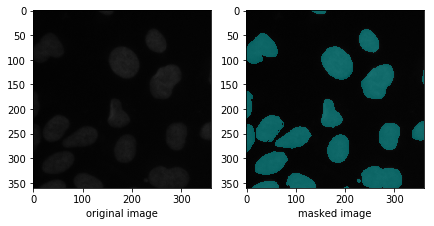

/home/biswajit/Documents/bima/unet/data/train/45f059cf21d85ecfce0eb93260516f1e2443d210e9a52f9ae2271d604aa3fcc5/images/45f059cf21d85ecfce0eb93260516f1e2443d210e9a52f9ae2271d604aa3fcc5.png


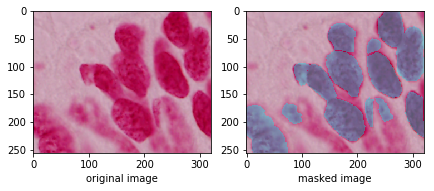

/home/biswajit/Documents/bima/unet/data/train/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886/images/f952cc65376009cfad8249e53b9b2c0daaa3553e897096337d143c625c2df886.png


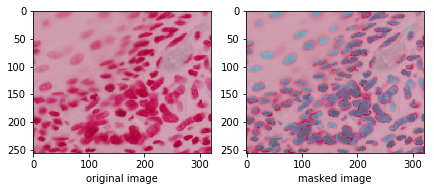

/home/biswajit/Documents/bima/unet/data/train/6ab24e7e1f6c9fdd371c5edae1bbb20abeeb976811f8ab2375880b4483860f4d/images/6ab24e7e1f6c9fdd371c5edae1bbb20abeeb976811f8ab2375880b4483860f4d.png


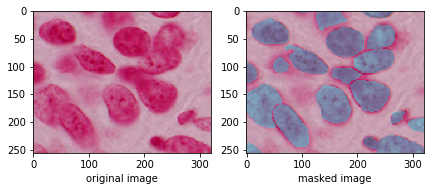

/home/biswajit/Documents/bima/unet/data/train/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6/images/547ef286ee5f4e5dce533e982e6992ada67b7d727fdd3cfa6576f24c631a7ae6.png


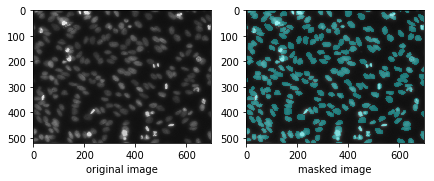

/home/biswajit/Documents/bima/unet/data/train/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2/images/e23e11414ee645b51081fb202d38b793f0c8ef2940f8228ded384899d21b02c2.png


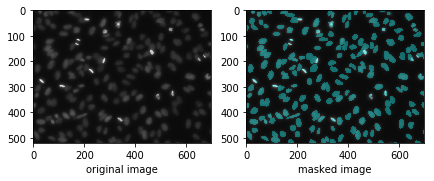

/home/biswajit/Documents/bima/unet/data/train/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490/images/cb4df20a83b2f38b394c67f1d9d4aef29f9794d5345da3576318374ec3a11490.png


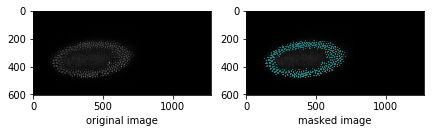

/home/biswajit/Documents/bima/unet/data/train/2e172afb1f43b359f1f0208da9386aefe97c0c1afe202abfe6ec09cdca820990/images/2e172afb1f43b359f1f0208da9386aefe97c0c1afe202abfe6ec09cdca820990.png


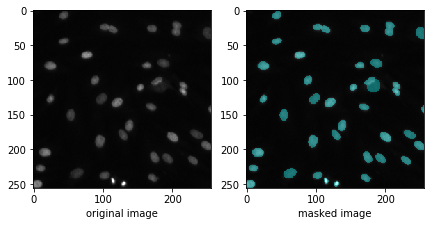

/home/biswajit/Documents/bima/unet/data/train/072ff14c1d3245bf49ad6f1d4c71cdb18f1cb78a8e06fd2f53767e28f727cb81/images/072ff14c1d3245bf49ad6f1d4c71cdb18f1cb78a8e06fd2f53767e28f727cb81.png


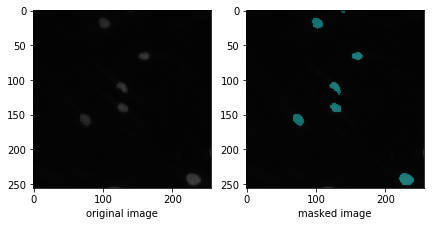

/home/biswajit/Documents/bima/unet/data/train/aa4d989d262c618ac2793579e200cc71b3767f84698ae5f669867f23cdfe2568/images/aa4d989d262c618ac2793579e200cc71b3767f84698ae5f669867f23cdfe2568.png


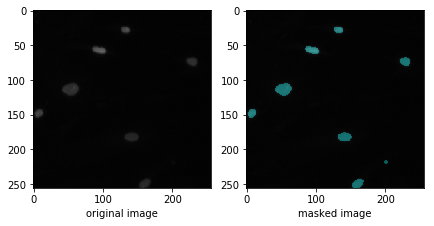

/home/biswajit/Documents/bima/unet/data/train/2b50b1e3fa5c5aa39bc84ebfaea9961b7199c4d2488ae0b48d0b3459807d59d2/images/2b50b1e3fa5c5aa39bc84ebfaea9961b7199c4d2488ae0b48d0b3459807d59d2.png


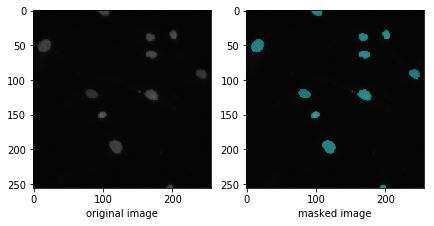

/home/biswajit/Documents/bima/unet/data/train/9a71a416f98971aa14f63ef91242654cc9191a1414ce8bbd38066fe94559aa4f/images/9a71a416f98971aa14f63ef91242654cc9191a1414ce8bbd38066fe94559aa4f.png


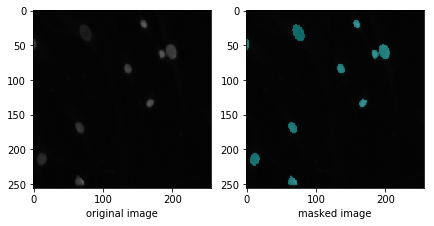

/home/biswajit/Documents/bima/unet/data/train/953211bcc0192e2298087d30e708dba68def9e0c13a3ff3326a18b0962c63adc/images/953211bcc0192e2298087d30e708dba68def9e0c13a3ff3326a18b0962c63adc.png


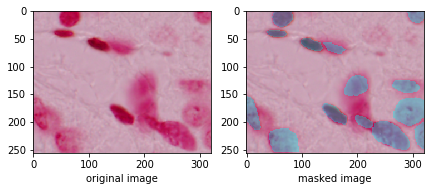

/home/biswajit/Documents/bima/unet/data/train/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96/images/79fe419488ba98494e3baa35c6fef9662eda1efe325d0ab0ac002f5383245d96.png


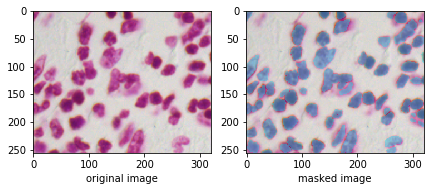

/home/biswajit/Documents/bima/unet/data/train/f4b7c24baf69b8752c49d0eb5db4b7b5e1524945d48e54925bff401d5658045d/images/f4b7c24baf69b8752c49d0eb5db4b7b5e1524945d48e54925bff401d5658045d.png


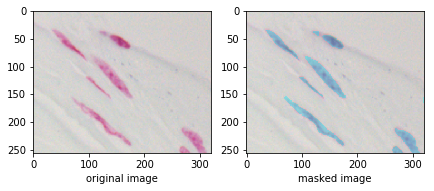

/home/biswajit/Documents/bima/unet/data/train/9b25b8ffd5f52b6c3d235a42d51d380503d1f80b61ef0f62eeb696f5977c38e6/images/9b25b8ffd5f52b6c3d235a42d51d380503d1f80b61ef0f62eeb696f5977c38e6.png


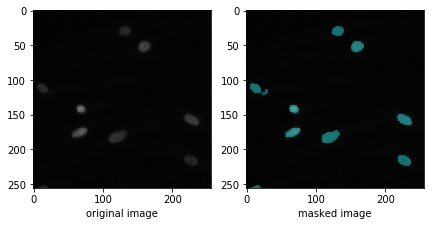

/home/biswajit/Documents/bima/unet/data/train/4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1/images/4c465a54e329ec7b0f4bc5f6acdfd3192707d6c0fbdf557339485581c5a6b3c1.png


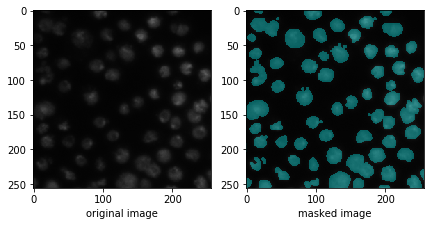

/home/biswajit/Documents/bima/unet/data/train/815524d88283ba10ad597b87aa1967671db776df8004a0c4291b67fc2624c22a/images/815524d88283ba10ad597b87aa1967671db776df8004a0c4291b67fc2624c22a.png


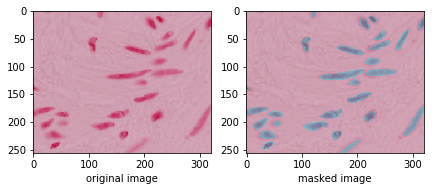

/home/biswajit/Documents/bima/unet/data/train/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da/images/c0f172831b8017c769ff0e80f85b096ac939e79de3d524e0826fbb95221365da.png


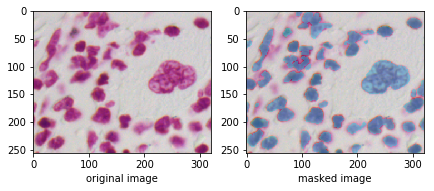

/home/biswajit/Documents/bima/unet/data/train/9f073db4acd7e634fd578af50d4e77218742f63a4d423a99808d6fd7cb0d3cdb/images/9f073db4acd7e634fd578af50d4e77218742f63a4d423a99808d6fd7cb0d3cdb.png


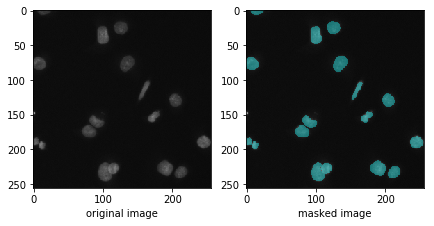

/home/biswajit/Documents/bima/unet/data/train/1ec74a26e772966df764e063f1391109a60d803cff9d15680093641ed691bf72/images/1ec74a26e772966df764e063f1391109a60d803cff9d15680093641ed691bf72.png


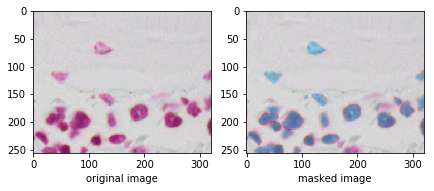

/home/biswajit/Documents/bima/unet/data/train/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de/images/9520aff4efe87bd8f3901652fa2dde9b4bc9c679325966145ce00c1ca33f35de.png


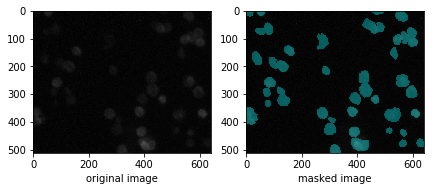

/home/biswajit/Documents/bima/unet/data/train/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8/images/da31f2aa8601afec5c45180a2c448cb9c4a8ec7b35e75190d6ba3588f69058c8.png


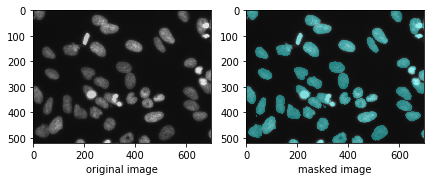

/home/biswajit/Documents/bima/unet/data/train/6fb82031f7fc5f4fa6e0bc2ef3421db19036b5c2cdd2725009ab465d66d61d72/images/6fb82031f7fc5f4fa6e0bc2ef3421db19036b5c2cdd2725009ab465d66d61d72.png


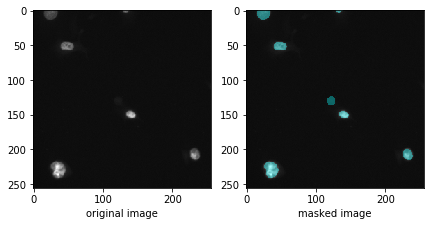

/home/biswajit/Documents/bima/unet/data/train/8a26b134fe9343c0c794513dae7787b7ac1debec3bb2a7096ab0b874a31d8175/images/8a26b134fe9343c0c794513dae7787b7ac1debec3bb2a7096ab0b874a31d8175.png


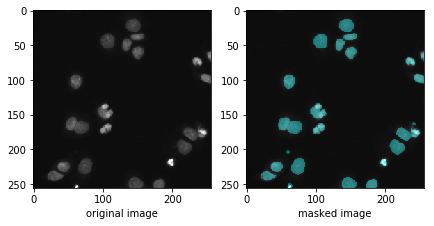

/home/biswajit/Documents/bima/unet/data/train/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812/images/2a1a294e21d76efd0399e4eb321b45f44f7510911acd92c988480195c5b4c812.png


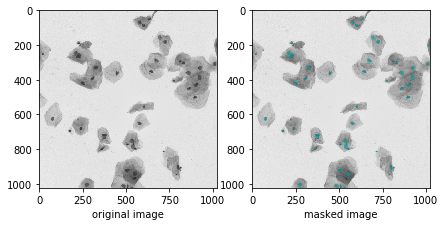

/home/biswajit/Documents/bima/unet/data/train/003cee89357d9fe13516167fd67b609a164651b21934585648c740d2c3d86dc1/images/003cee89357d9fe13516167fd67b609a164651b21934585648c740d2c3d86dc1.png


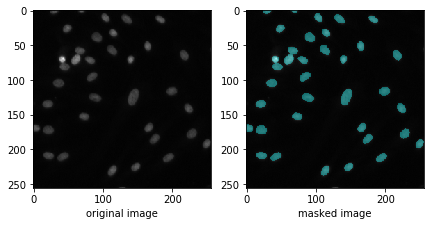

/home/biswajit/Documents/bima/unet/data/train/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8/images/e5a6c5e01e6a4ef676a2d975374e995dd55792ea317a8e110bebc37da83a4ce8.png


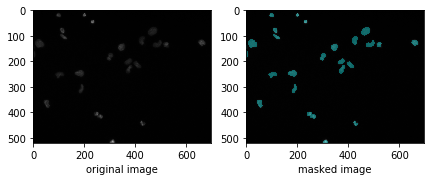

/home/biswajit/Documents/bima/unet/data/train/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25/images/876423522bdec1602917b94163a21e05fc7b692045219b7bc96cdaf638c33c25.png


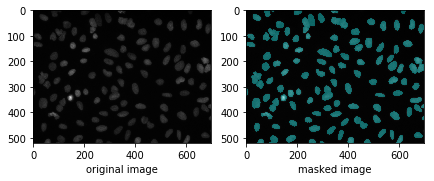

/home/biswajit/Documents/bima/unet/data/train/58c593bcb98386e7fd42a1d34e291db93477624b164e83ab2afa3caa90d1d921/images/58c593bcb98386e7fd42a1d34e291db93477624b164e83ab2afa3caa90d1d921.png


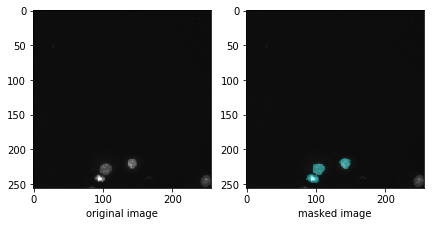

/home/biswajit/Documents/bima/unet/data/train/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a/images/2dd3356f2dcf470aec4003800744dfec6490e75d88011e1d835f4f3d60f88e7a.png


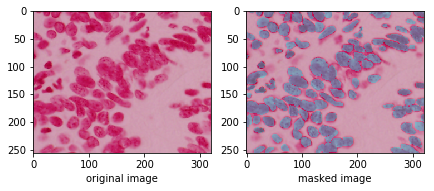

/home/biswajit/Documents/bima/unet/data/train/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22/images/c44ed955eb2e5c8d820b01477e122b32eff6dd475343e11229c33d8af3473b22.png


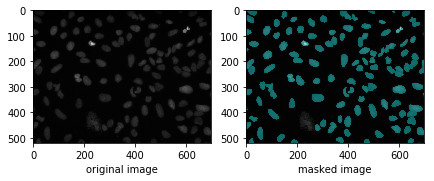

/home/biswajit/Documents/bima/unet/data/train/f113626a04125d97b27f21b45a0ce9a686d73dee7b5dbc0725d49194ba0203bd/images/f113626a04125d97b27f21b45a0ce9a686d73dee7b5dbc0725d49194ba0203bd.png


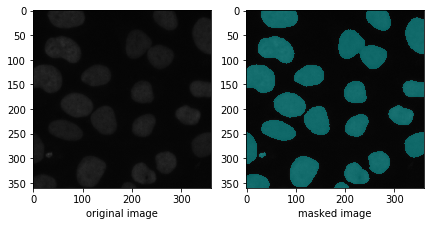

/home/biswajit/Documents/bima/unet/data/train/7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5/images/7f34dfccd1bc2e2466ee3d6f74ff05821a0e5404e9cf2c9568da26b59f7afda5.png


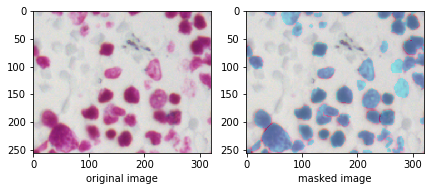

/home/biswajit/Documents/bima/unet/data/train/b4d902d42c93dea77b541456f8d905f35eeb24fc3a5b0b15b5678d78e0aabe0c/images/b4d902d42c93dea77b541456f8d905f35eeb24fc3a5b0b15b5678d78e0aabe0c.png


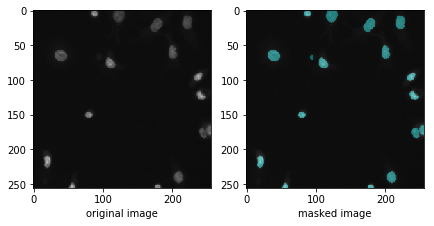

/home/biswajit/Documents/bima/unet/data/train/589f86dee5b480a88dd4f77eeaffe2c4d70aefdf879a4096dde1fa4d41055b8f/images/589f86dee5b480a88dd4f77eeaffe2c4d70aefdf879a4096dde1fa4d41055b8f.png


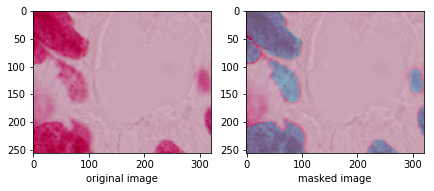

/home/biswajit/Documents/bima/unet/data/train/adc315bd40d699fd4e4effbcce81cd7162851007f485d754ad3b0472f73a86df/images/adc315bd40d699fd4e4effbcce81cd7162851007f485d754ad3b0472f73a86df.png


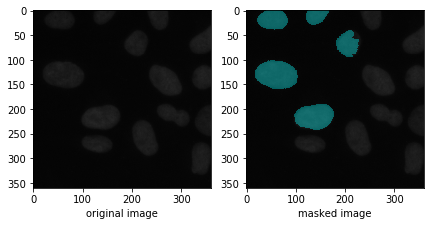

/home/biswajit/Documents/bima/unet/data/train/4ff152d76db095f75c664dd48e41e8c9953fd0e784535883916383165e28a08e/images/4ff152d76db095f75c664dd48e41e8c9953fd0e784535883916383165e28a08e.png


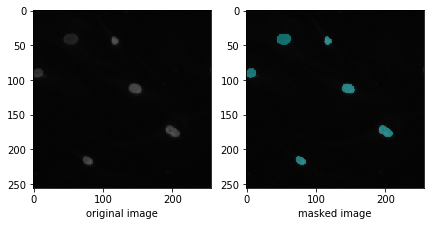

/home/biswajit/Documents/bima/unet/data/train/356d9903d16074f152fe8f2f0ef555d9959c53264228eae7373cad5cf35d4e85/images/356d9903d16074f152fe8f2f0ef555d9959c53264228eae7373cad5cf35d4e85.png


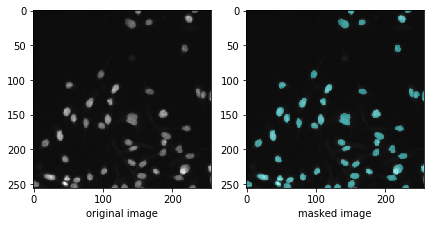

/home/biswajit/Documents/bima/unet/data/train/4d40de30a3db3bc4f241cb7f48e8497c11e8f20a99bf55788bdce17242029745/images/4d40de30a3db3bc4f241cb7f48e8497c11e8f20a99bf55788bdce17242029745.png


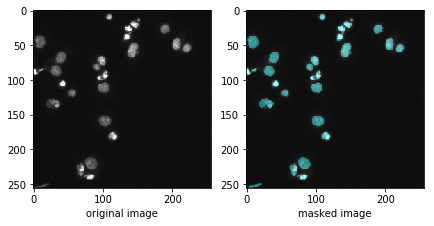

/home/biswajit/Documents/bima/unet/data/train/5ba4facefc949c920d7054813a3e846b000969da2ed860148bdfd18456f59bcc/images/5ba4facefc949c920d7054813a3e846b000969da2ed860148bdfd18456f59bcc.png


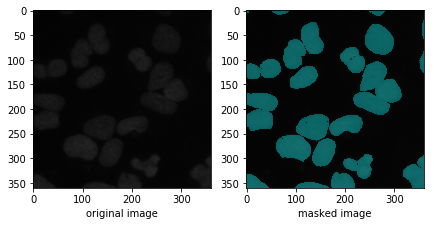

/home/biswajit/Documents/bima/unet/data/train/76c4f14e35210f87a29e93c46dbb25c8f5dc5c04d1d3134672708bcdfbc7e959/images/76c4f14e35210f87a29e93c46dbb25c8f5dc5c04d1d3134672708bcdfbc7e959.png


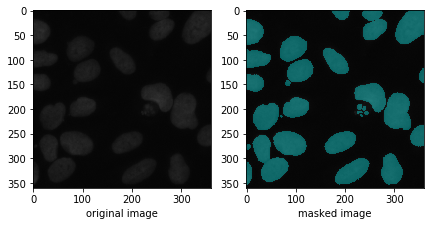

/home/biswajit/Documents/bima/unet/data/train/20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45/images/20c37b1ad2f510ed7396969e855fe93d0d05611738f6e706e8ca1d1aed3ded45.png


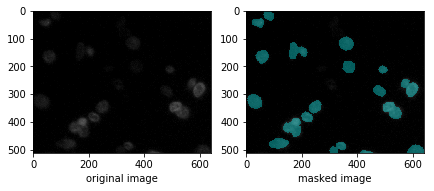

/home/biswajit/Documents/bima/unet/data/train/8b12e18670e4b24d03567d1e17c0c24fadf0ea2c1e763983dd6bb4c44b7376a6/images/8b12e18670e4b24d03567d1e17c0c24fadf0ea2c1e763983dd6bb4c44b7376a6.png


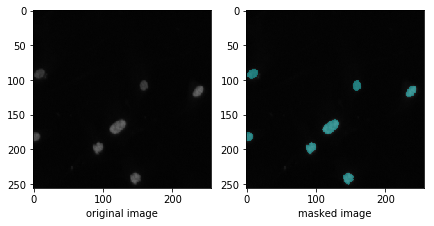

/home/biswajit/Documents/bima/unet/data/train/ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142/images/ae570a676961482848b5097038ef5e407df7a66a8e1c9b0567da599565a6b142.png


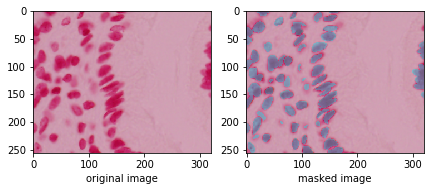

/home/biswajit/Documents/bima/unet/data/train/fadeb0ab092833f27daaeb3e24223eb090f9536b83f68cde8f49df7c544f711b/images/fadeb0ab092833f27daaeb3e24223eb090f9536b83f68cde8f49df7c544f711b.png


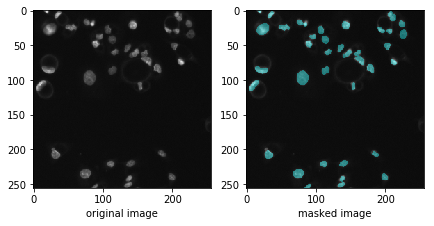

/home/biswajit/Documents/bima/unet/data/train/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7/images/700afb1cd830a808e3c6125749612e5d23fd9f9726049a9e0c2061997514e1a7.png


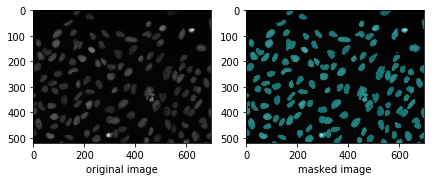

/home/biswajit/Documents/bima/unet/data/train/2227fd9b01d67c2bcdb407d3205214e6dfeff9fd0725828e3b3651959942ff4a/images/2227fd9b01d67c2bcdb407d3205214e6dfeff9fd0725828e3b3651959942ff4a.png


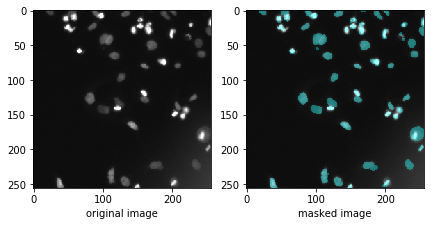

/home/biswajit/Documents/bima/unet/data/train/0bf4b144167694b6846d584cf52c458f34f28fcae75328a2a096c8214e01c0d0/images/0bf4b144167694b6846d584cf52c458f34f28fcae75328a2a096c8214e01c0d0.png


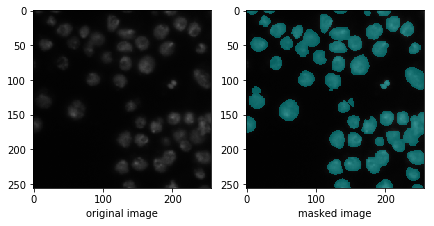

/home/biswajit/Documents/bima/unet/data/train/54cb3328e778d87f76062b0550e3bc190f46384acd8efbe58c297265d1906e84/images/54cb3328e778d87f76062b0550e3bc190f46384acd8efbe58c297265d1906e84.png


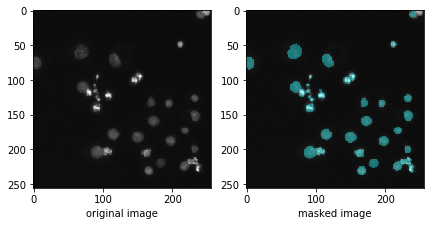

/home/biswajit/Documents/bima/unet/data/train/610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96/images/610f32e2d9d270d740aec501dcf0c89595e4e623468ad43272adab90520a8f96.png


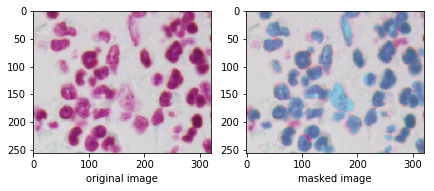

/home/biswajit/Documents/bima/unet/data/train/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381/images/4217e25defac94ff465157d53f5a24b8a14045b763d8606ec4a97d71d99ee381.png


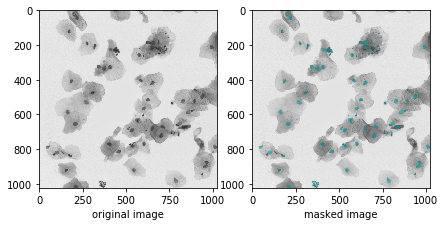

/home/biswajit/Documents/bima/unet/data/train/4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b942c2265eea75419d62f/images/4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b942c2265eea75419d62f.png


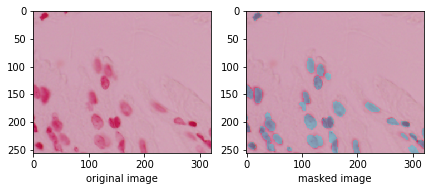

/home/biswajit/Documents/bima/unet/data/train/3874755f6222e83006fdad4d664ec0d9697c13af4fbe24b2f9a059bb13075186/images/3874755f6222e83006fdad4d664ec0d9697c13af4fbe24b2f9a059bb13075186.png


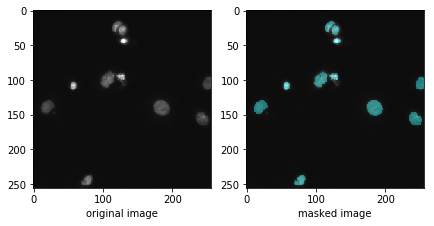

/home/biswajit/Documents/bima/unet/data/train/44ab6a09eedee848b072ea3acd0f4e781f9c43b8d4e3d62598e1024584bf0b01/images/44ab6a09eedee848b072ea3acd0f4e781f9c43b8d4e3d62598e1024584bf0b01.png


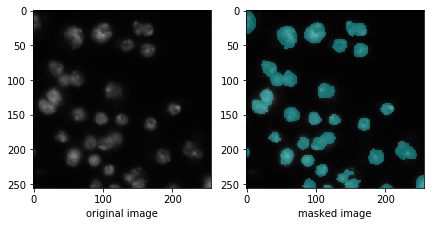

/home/biswajit/Documents/bima/unet/data/train/a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7/images/a9d884ba0929dac87c2052ce5b15034163685317d7cff45c40b0f7bd9bd4d9e7.png


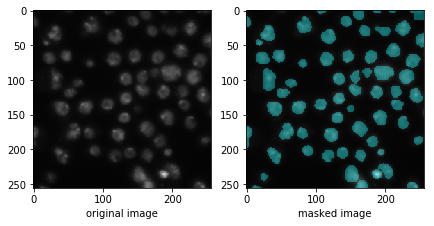

/home/biswajit/Documents/bima/unet/data/train/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6/images/212b858a66f0d23768b8e3e1357704fc2f4cf4bbe7eed8cd59b5d01031d553e6.png


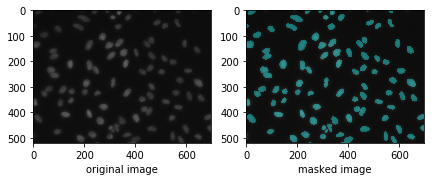

/home/biswajit/Documents/bima/unet/data/train/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b/images/bde3727f3a9e8b2b58f383ebc762b2157eb50cdbff23e69b025418b43967556b.png


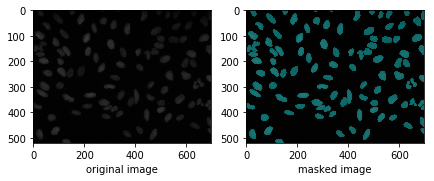

/home/biswajit/Documents/bima/unet/data/train/4e92129f4e8066d6f560d6022cd343a2245939aa49d8b06cddbd9bfc7e7eeb0e/images/4e92129f4e8066d6f560d6022cd343a2245939aa49d8b06cddbd9bfc7e7eeb0e.png


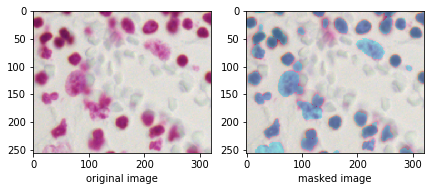

/home/biswajit/Documents/bima/unet/data/train/5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456/images/5ef4442e5b8b0b4cf824b61be4050dfd793d846e0a6800afa4425a2f66e91456.png


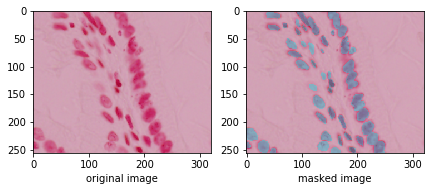

/home/biswajit/Documents/bima/unet/data/train/c2a646a819f59a4e816e0ee8ea00ba10d5de9ac20b5a435c41192637790dabee/images/c2a646a819f59a4e816e0ee8ea00ba10d5de9ac20b5a435c41192637790dabee.png


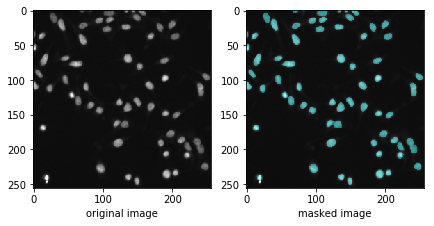

/home/biswajit/Documents/bima/unet/data/train/33618678c167c5e07be02c49d0c43bcd90493ba5d83110a631409a4d3ccc1e51/images/33618678c167c5e07be02c49d0c43bcd90493ba5d83110a631409a4d3ccc1e51.png


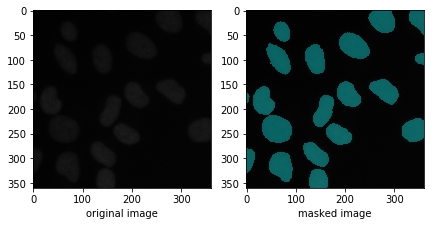

/home/biswajit/Documents/bima/unet/data/train/7c0157913223365720209ac83ff2e0b1b2b460173acd615c67646014093a2b97/images/7c0157913223365720209ac83ff2e0b1b2b460173acd615c67646014093a2b97.png


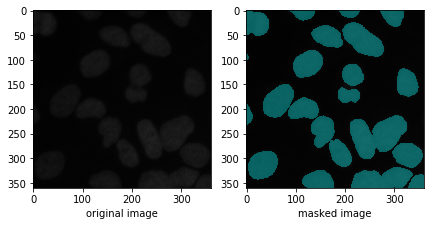

/home/biswajit/Documents/bima/unet/data/train/50a7ea80dd73232a17f98b5c83f62ec89989e892fe25b79b36f99b3872a7d182/images/50a7ea80dd73232a17f98b5c83f62ec89989e892fe25b79b36f99b3872a7d182.png


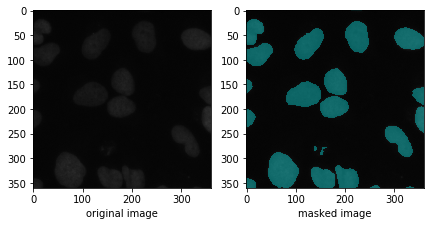

/home/biswajit/Documents/bima/unet/data/train/d4d6c683f249d82518431603bf0206d05f2114ac871a99ffade0f5f61cf167e1/images/d4d6c683f249d82518431603bf0206d05f2114ac871a99ffade0f5f61cf167e1.png


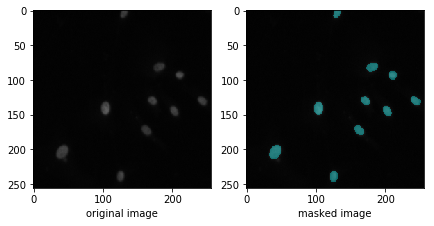

/home/biswajit/Documents/bima/unet/data/train/866a8cba7bfe1ea73e383d6cf492e53752579140c8b833bb56839a55bf79d855/images/866a8cba7bfe1ea73e383d6cf492e53752579140c8b833bb56839a55bf79d855.png


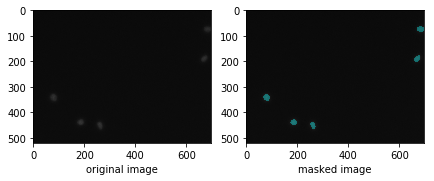

/home/biswajit/Documents/bima/unet/data/train/ea94ba4b01d1bd5f7768d10e0ac547743791033df545c71fcec442d0cb5cb5e7/images/ea94ba4b01d1bd5f7768d10e0ac547743791033df545c71fcec442d0cb5cb5e7.png


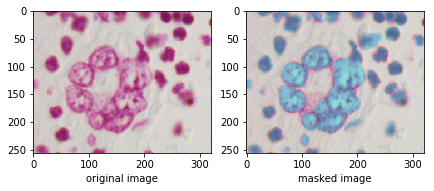

/home/biswajit/Documents/bima/unet/data/train/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180/images/1c8b905c9519061d6d091e702b45274f4485c80dcf7fb1491e6b2723f5002180.png


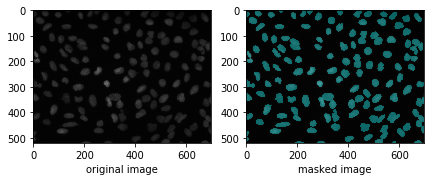

/home/biswajit/Documents/bima/unet/data/train/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05/images/dd54adb80393de7769b9853c0aa2ee9b240905d0e99c59d4ccd99401f327aa05.png


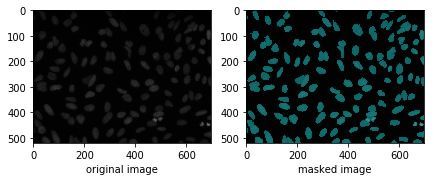

/home/biswajit/Documents/bima/unet/data/train/1ee4a111f0e0bb9b001121b94ff98ca736fad03797b25285fe33a47046b3e4b0/images/1ee4a111f0e0bb9b001121b94ff98ca736fad03797b25285fe33a47046b3e4b0.png


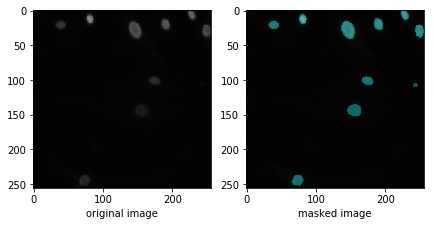

/home/biswajit/Documents/bima/unet/data/train/bb61fc17daf8bdd4e16fdcf50137a8d7762bec486ede9249d92e511fcb693676/images/bb61fc17daf8bdd4e16fdcf50137a8d7762bec486ede9249d92e511fcb693676.png


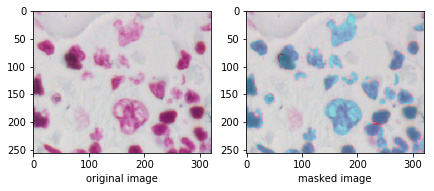

/home/biswajit/Documents/bima/unet/data/train/4c032609d377bd980e01f888e0b298600bf8af0e33c4271a1f3aaf76964dce06/images/4c032609d377bd980e01f888e0b298600bf8af0e33c4271a1f3aaf76964dce06.png


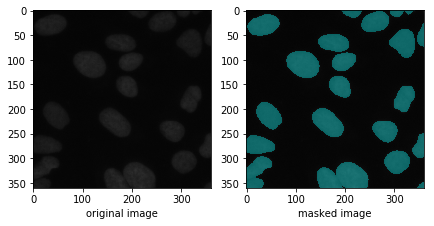

/home/biswajit/Documents/bima/unet/data/train/0d3640c1f1b80f24e94cc9a5f3e1d9e8db7bf6af7d4aba920265f46cadc25e37/images/0d3640c1f1b80f24e94cc9a5f3e1d9e8db7bf6af7d4aba920265f46cadc25e37.png


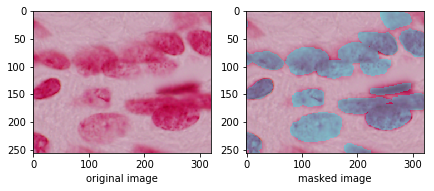

/home/biswajit/Documents/bima/unet/data/train/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56/images/6c67b78e8164801059375ed9a607f61e67a7ae347e92e36a7f20514224541d56.png


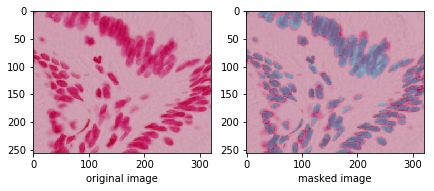

/home/biswajit/Documents/bima/unet/data/train/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1/images/ad9d305cbf193d4250743ead466bdaefe910835d7e352c544e22320e8336f5c1.png


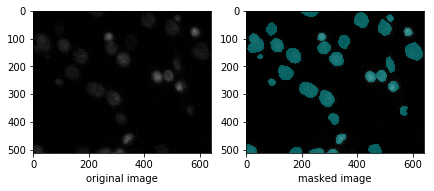

/home/biswajit/Documents/bima/unet/data/train/45cc00f2ef95da6698bf590663e319d7c0ed4fb99d42dd3cf4060887da74fb81/images/45cc00f2ef95da6698bf590663e319d7c0ed4fb99d42dd3cf4060887da74fb81.png


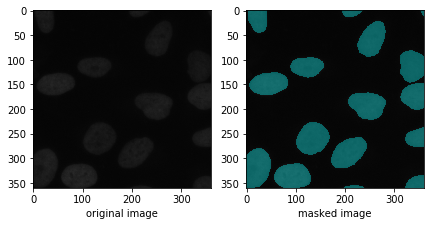

/home/biswajit/Documents/bima/unet/data/train/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9/images/4dbbb275960ab9e4ec2c66c8d3000f7c70c8dce5112df591b95db84e25efa6e9.png


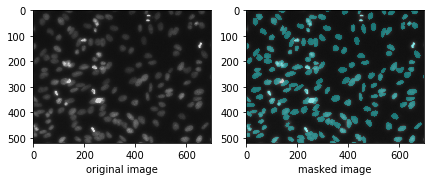

/home/biswajit/Documents/bima/unet/data/train/3bfd6bb152310f93daa6f4e1867c10572946e874b3a30c9ba8e0fcdeb590300b/images/3bfd6bb152310f93daa6f4e1867c10572946e874b3a30c9ba8e0fcdeb590300b.png


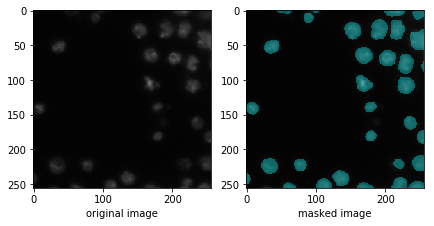

/home/biswajit/Documents/bima/unet/data/train/c15c652c08153fb781a5349123ab8f80bb2a8680a41eb8e89e547ae01b7a5441/images/c15c652c08153fb781a5349123ab8f80bb2a8680a41eb8e89e547ae01b7a5441.png


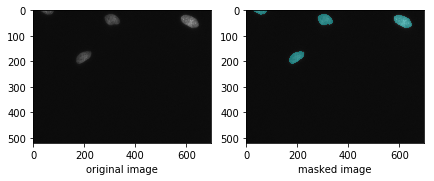

/home/biswajit/Documents/bima/unet/data/train/cfabf7379c5591d40aa4a20c86b4197c6a25ab55887a9fca4f06c2dfc0f0e973/images/cfabf7379c5591d40aa4a20c86b4197c6a25ab55887a9fca4f06c2dfc0f0e973.png


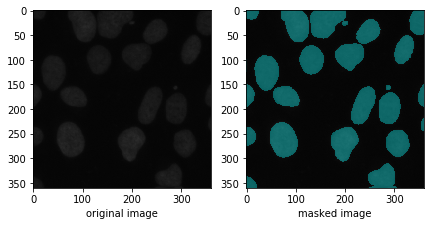

/home/biswajit/Documents/bima/unet/data/train/af6b6173c59450bc76b2cc461cf233921fbfdb6feb8dd6da03a0d44193221fd0/images/af6b6173c59450bc76b2cc461cf233921fbfdb6feb8dd6da03a0d44193221fd0.png


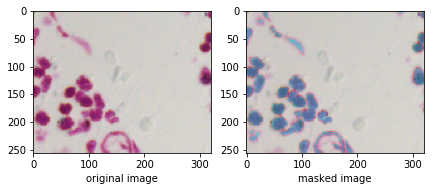

/home/biswajit/Documents/bima/unet/data/train/cf26c41245febfe67c2a1682cc4ee8752ee40ae3e49610314f45923b8bf5b08a/images/cf26c41245febfe67c2a1682cc4ee8752ee40ae3e49610314f45923b8bf5b08a.png


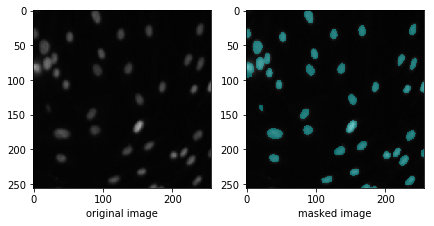

/home/biswajit/Documents/bima/unet/data/train/01d44a26f6680c42ba94c9bc6339228579a95d0e2695b149b7cc0c9592b21baf/images/01d44a26f6680c42ba94c9bc6339228579a95d0e2695b149b7cc0c9592b21baf.png


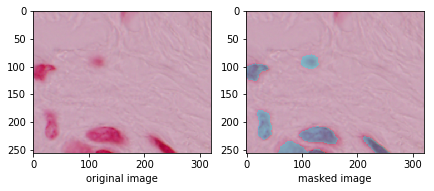

/home/biswajit/Documents/bima/unet/data/train/62570c4ff1c5ab6d9d383aba9f25e604768520b4266afd40fdf4734a694c8bc3/images/62570c4ff1c5ab6d9d383aba9f25e604768520b4266afd40fdf4734a694c8bc3.png


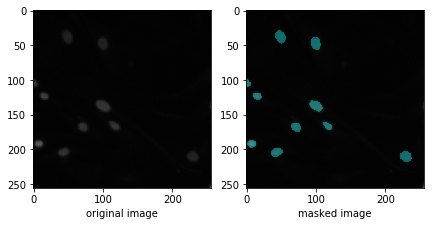

/home/biswajit/Documents/bima/unet/data/train/11a0170f44e3ab4a8d669ae8ea9546d3a32ebfe6486d9066e5648d30b4e1cb69/images/11a0170f44e3ab4a8d669ae8ea9546d3a32ebfe6486d9066e5648d30b4e1cb69.png


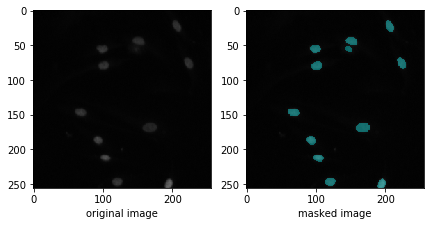

/home/biswajit/Documents/bima/unet/data/train/e321cfa987e77c21373a0f8b1236c83d6636306949a82a7f5b07fc0838e7777f/images/e321cfa987e77c21373a0f8b1236c83d6636306949a82a7f5b07fc0838e7777f.png


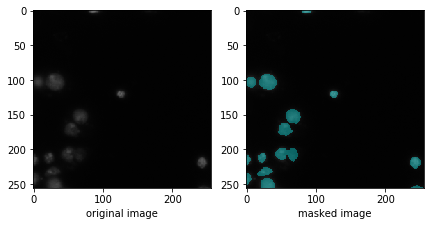

/home/biswajit/Documents/bima/unet/data/train/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b/images/4d2cff9a0c8df3a7ef6100fda6f66e865a7670af6a18564767d8019b9ed2fd7b.png


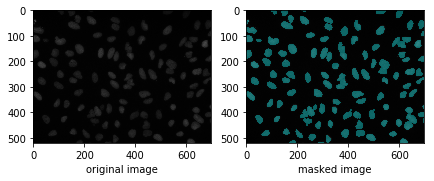

/home/biswajit/Documents/bima/unet/data/train/e9b8ad127f2163438b6236c74938f43d7b4863aaf39a16367f4af59bfd96597b/images/e9b8ad127f2163438b6236c74938f43d7b4863aaf39a16367f4af59bfd96597b.png


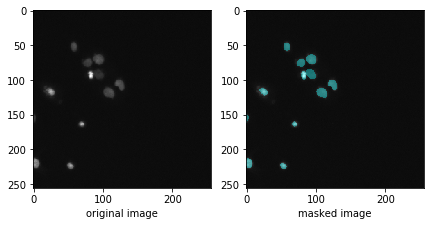

/home/biswajit/Documents/bima/unet/data/train/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e/images/538b7673d507014d83af238876e03617396b70fe27f525f8205a4a96900fbb8e.png


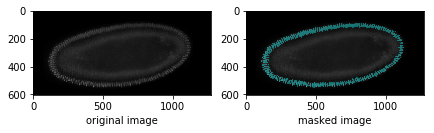

/home/biswajit/Documents/bima/unet/data/train/0e21d7b3eea8cdbbed60d51d72f4f8c1974c5d76a8a3893a7d5835c85284132e/images/0e21d7b3eea8cdbbed60d51d72f4f8c1974c5d76a8a3893a7d5835c85284132e.png


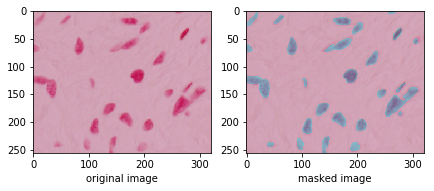

/home/biswajit/Documents/bima/unet/data/train/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687/images/f728de04267283f0b4daab9a840e7433b2c6034baf195fd526850439c9297687.png


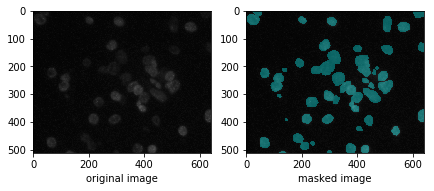

/home/biswajit/Documents/bima/unet/data/train/2349e95ece2857c89db7e4a8be8c88af0b45f3c4262608120cb3bd6ef51fd241/images/2349e95ece2857c89db7e4a8be8c88af0b45f3c4262608120cb3bd6ef51fd241.png


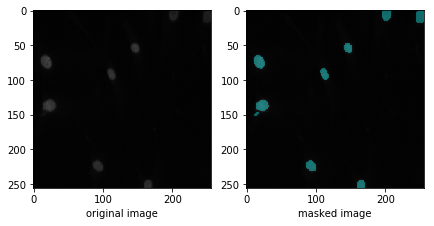

/home/biswajit/Documents/bima/unet/data/train/623cf6987b3fac8f384c09f40d98c5e739c097aa9a9627054542aa27f7d38db1/images/623cf6987b3fac8f384c09f40d98c5e739c097aa9a9627054542aa27f7d38db1.png


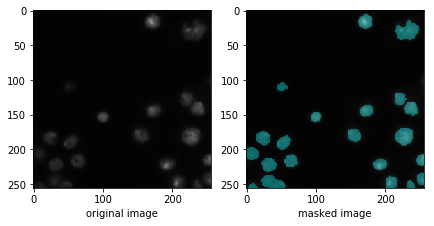

/home/biswajit/Documents/bima/unet/data/train/693bc64581275f04fc456da74f031d583733360a1f6032fa38b3fbf592ff4352/images/693bc64581275f04fc456da74f031d583733360a1f6032fa38b3fbf592ff4352.png


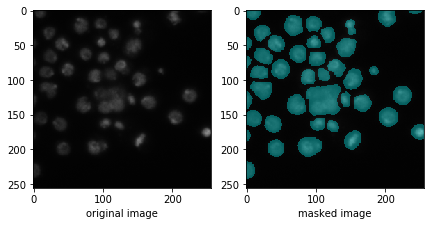

/home/biswajit/Documents/bima/unet/data/train/0bda515e370294ed94efd36bd53782288acacb040c171df2ed97fd691fc9d8fe/images/0bda515e370294ed94efd36bd53782288acacb040c171df2ed97fd691fc9d8fe.png


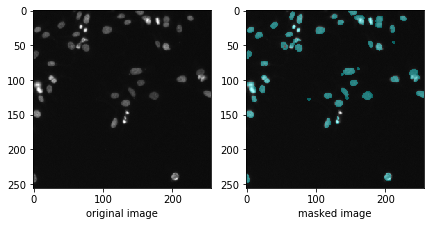

/home/biswajit/Documents/bima/unet/data/train/483b89aa683542f1c63e62f5f71ae8ae1f959caf1c379cd61230a71cd1036732/images/483b89aa683542f1c63e62f5f71ae8ae1f959caf1c379cd61230a71cd1036732.png


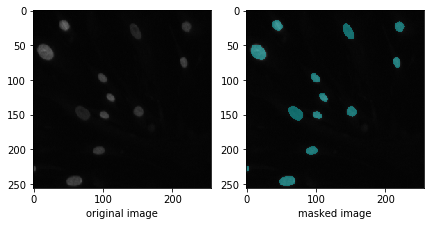

/home/biswajit/Documents/bima/unet/data/train/602f267432e7a573e1092f1cf48135c82d0fbc8722bc028b9330ec801a40bb18/images/602f267432e7a573e1092f1cf48135c82d0fbc8722bc028b9330ec801a40bb18.png


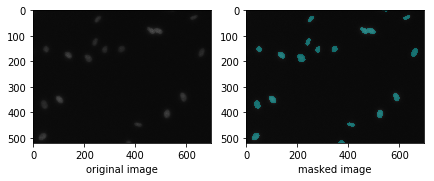

/home/biswajit/Documents/bima/unet/data/train/e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203/images/e50ac10d1dce6496d092d966784ed3795969128ca0bc58199a36d558ed529203.png


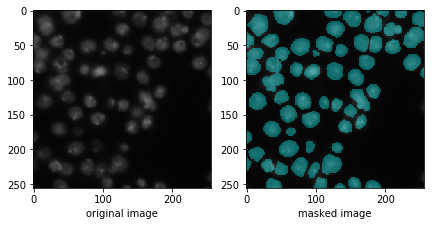

/home/biswajit/Documents/bima/unet/data/train/9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944/images/9fb32aba1c2fd53273dca9abefac944ba747f578da82dfaa1249f332a2324944.png


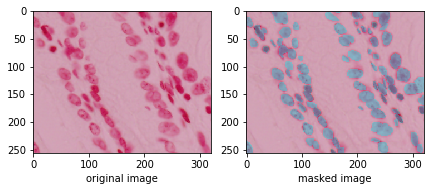

/home/biswajit/Documents/bima/unet/data/train/4e23ecf65040f86420e0201134e538951acdeda84fbb274311f995682044dd64/images/4e23ecf65040f86420e0201134e538951acdeda84fbb274311f995682044dd64.png


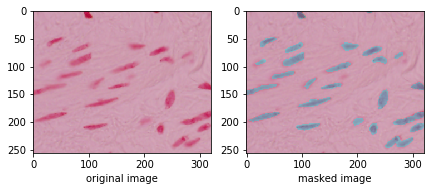

/home/biswajit/Documents/bima/unet/data/train/eeb142344e9de3250ab748f93940bf06be70d5078337680998468a134a101698/images/eeb142344e9de3250ab748f93940bf06be70d5078337680998468a134a101698.png


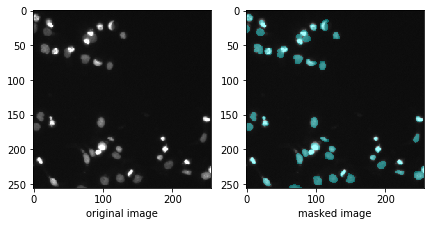

/home/biswajit/Documents/bima/unet/data/train/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4/images/8d05fb18ee0cda107d56735cafa6197a31884e0a5092dc6d41760fb92ae23ab4.png


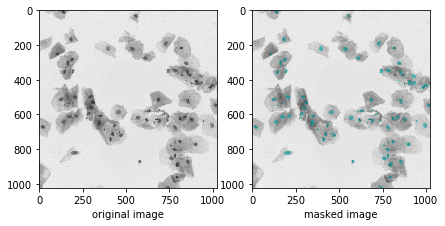

/home/biswajit/Documents/bima/unet/data/train/b98681c74842c4058bd2f88b06063731c26a90da083b1ef348e0ec734c58752b/images/b98681c74842c4058bd2f88b06063731c26a90da083b1ef348e0ec734c58752b.png


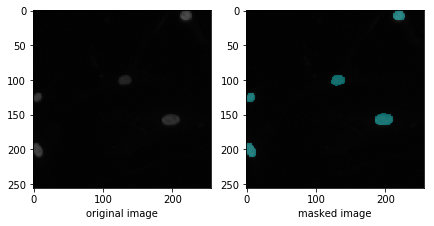

/home/biswajit/Documents/bima/unet/data/train/516a0e20327d6dfcedcf57e3056115e4fb29cdf4cb349003bdfc75c9b7f5c2cf/images/516a0e20327d6dfcedcf57e3056115e4fb29cdf4cb349003bdfc75c9b7f5c2cf.png


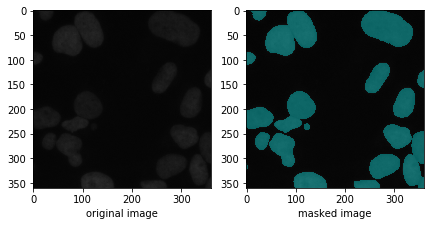

/home/biswajit/Documents/bima/unet/data/train/92f31f591929a30e4309ab75185c96ff4314ce0a7ead2ed2c2171897ad1da0c7/images/92f31f591929a30e4309ab75185c96ff4314ce0a7ead2ed2c2171897ad1da0c7.png


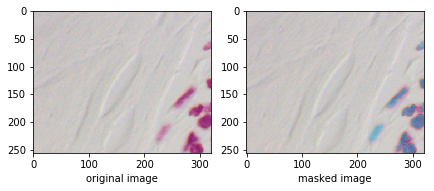

/home/biswajit/Documents/bima/unet/data/train/d1b173875e2261f55014bd27bd7174b9ae1c769338c1b31b5d737e9e60175993/images/d1b173875e2261f55014bd27bd7174b9ae1c769338c1b31b5d737e9e60175993.png


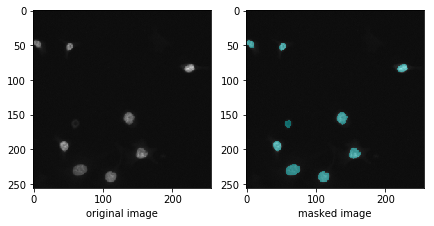

/home/biswajit/Documents/bima/unet/data/train/14cc1424c59808274e123db51292e9dbb5b037ef3e7c767a8c45c9ac733b91bf/images/14cc1424c59808274e123db51292e9dbb5b037ef3e7c767a8c45c9ac733b91bf.png


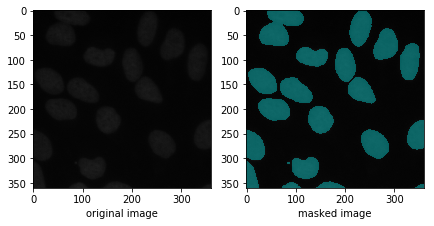

/home/biswajit/Documents/bima/unet/data/train/5488e8df5440ee5161fdfae3aeccd2ee396636430065c90e3f1f73870a975991/images/5488e8df5440ee5161fdfae3aeccd2ee396636430065c90e3f1f73870a975991.png


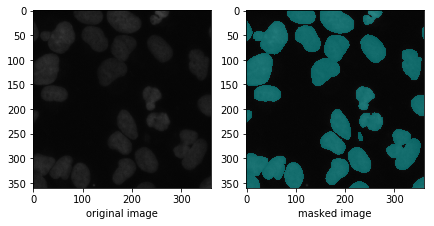

/home/biswajit/Documents/bima/unet/data/train/ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc/images/ed8c31b001a0c23c33402f94a5ee6b0209e0c6419eb52d5d02255513e3a672fc.png


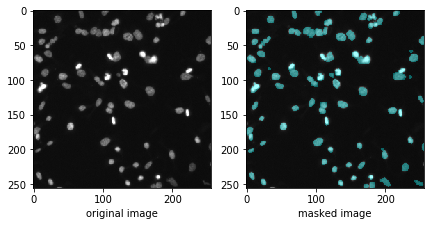

/home/biswajit/Documents/bima/unet/data/train/371a67232f7c871ec11332292c83cd9bb16063b91d58e86f0b76ef8817bc9465/images/371a67232f7c871ec11332292c83cd9bb16063b91d58e86f0b76ef8817bc9465.png


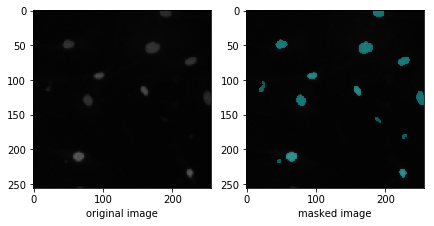

/home/biswajit/Documents/bima/unet/data/train/f0c9f135c62572f3669a75b2c735e4477dc77fac85e653426ee2b3bcfbed7aaf/images/f0c9f135c62572f3669a75b2c735e4477dc77fac85e653426ee2b3bcfbed7aaf.png


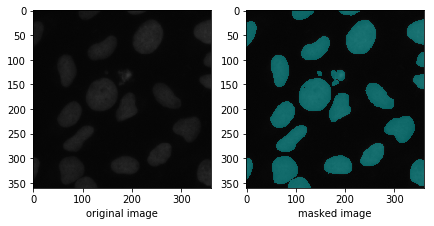

/home/biswajit/Documents/bima/unet/data/train/ce37f6dd0615d45e66e41a8f2ed6fbc0bbe3103a290394ad474207507710eacc/images/ce37f6dd0615d45e66e41a8f2ed6fbc0bbe3103a290394ad474207507710eacc.png


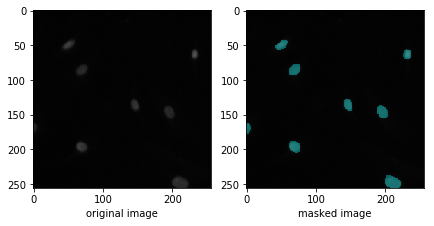

/home/biswajit/Documents/bima/unet/data/train/1f0008060150b5b93084ae2e4dabd160ab80a95ce8071a321b80ec4e33b58aca/images/1f0008060150b5b93084ae2e4dabd160ab80a95ce8071a321b80ec4e33b58aca.png


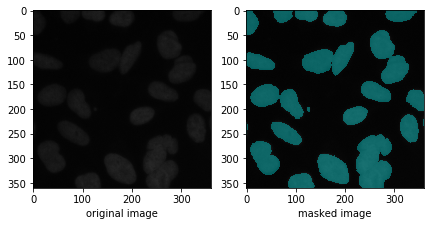

/home/biswajit/Documents/bima/unet/data/train/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc/images/175dbb364bfefc9537931144861c9b6e08934df3992782c669c6fe4234319dfc.png


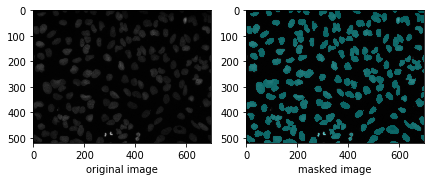

/home/biswajit/Documents/bima/unet/data/train/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243/images/e7a3a7c99483c243742b6cfa74e81cd48f126dcef004016ad0151df6c16a6243.png


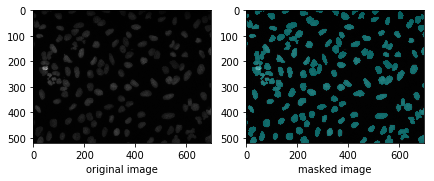

/home/biswajit/Documents/bima/unet/data/train/07761fa39f60dc37022dbbe8d8694595fd5b77ceb2af2a2724768c8e524d6770/images/07761fa39f60dc37022dbbe8d8694595fd5b77ceb2af2a2724768c8e524d6770.png


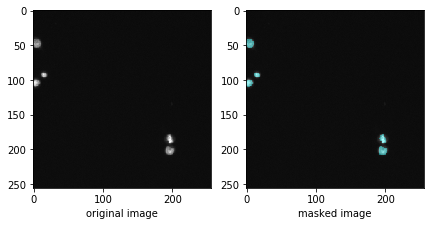

/home/biswajit/Documents/bima/unet/data/train/05a8f65ebd0b30d3b210f30b4d640c847c2e710d0d135e0aeeaccbe1988e3b6e/images/05a8f65ebd0b30d3b210f30b4d640c847c2e710d0d135e0aeeaccbe1988e3b6e.png


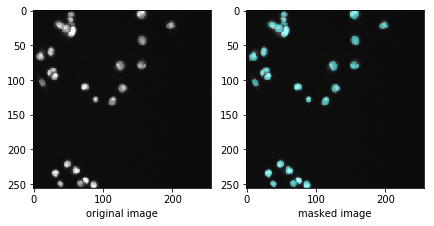

/home/biswajit/Documents/bima/unet/data/train/e66a97b2c77f3d66a7d3cebbc6a36c8c6259368a397f7b67647ed80ad53aa776/images/e66a97b2c77f3d66a7d3cebbc6a36c8c6259368a397f7b67647ed80ad53aa776.png


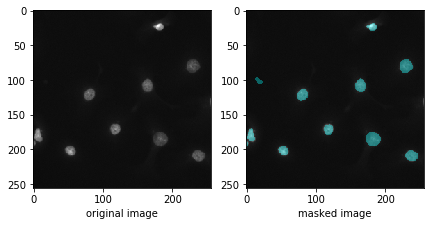

/home/biswajit/Documents/bima/unet/data/train/3582166ee20755856adf4882a8bfacb616fce4247911605a109c4862de421bcd/images/3582166ee20755856adf4882a8bfacb616fce4247911605a109c4862de421bcd.png


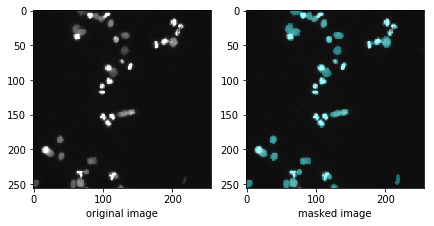

/home/biswajit/Documents/bima/unet/data/train/9774c82396327929fea05e40ae153cabf0107178b2ae3e40a5709b409793887e/images/9774c82396327929fea05e40ae153cabf0107178b2ae3e40a5709b409793887e.png


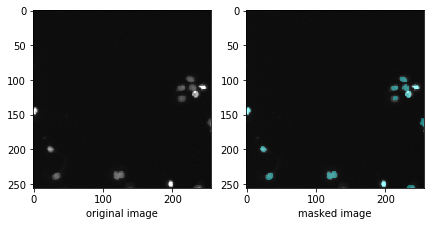

/home/biswajit/Documents/bima/unet/data/train/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3/images/f4c4db3df4ff0de90f44b027fc2e28c16bf7e5c75ea75b0a9762bbb7ac86e7a3.png


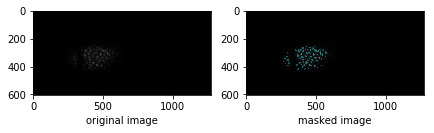

/home/biswajit/Documents/bima/unet/data/train/af8621ef0db8c26b0bce6385bd5609b584bfd678fcf7a234b8a15e6bb05c15ac/images/af8621ef0db8c26b0bce6385bd5609b584bfd678fcf7a234b8a15e6bb05c15ac.png


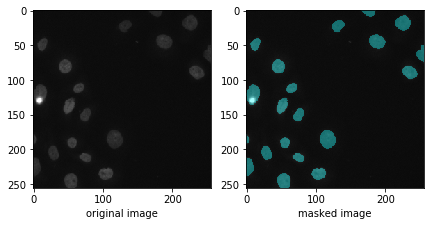

/home/biswajit/Documents/bima/unet/data/train/db45946a4412a2137674ec075b6892ccd682b77826aba618210569bbc65cf2b0/images/db45946a4412a2137674ec075b6892ccd682b77826aba618210569bbc65cf2b0.png


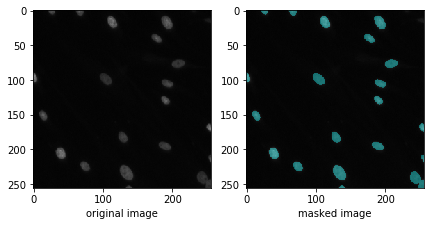

/home/biswajit/Documents/bima/unet/data/train/84eeec681987753029eb83ea5f3ff7e8b5697783cdb2035f2882d40c9a3f1029/images/84eeec681987753029eb83ea5f3ff7e8b5697783cdb2035f2882d40c9a3f1029.png


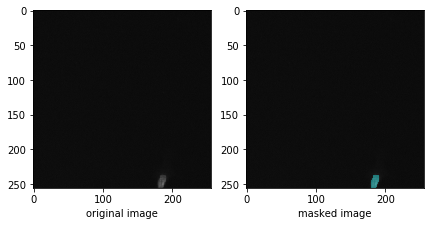

/home/biswajit/Documents/bima/unet/data/train/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04/images/3594684b9ea0e16196f498815508f8d364d55fea2933a2e782122b6f00375d04.png


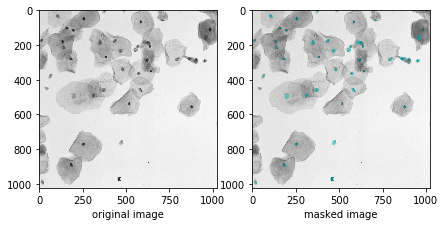

/home/biswajit/Documents/bima/unet/data/train/5bda829acd824821bc1f3f6573cf065d364653d5322f033a4af943f7a6170566/images/5bda829acd824821bc1f3f6573cf065d364653d5322f033a4af943f7a6170566.png


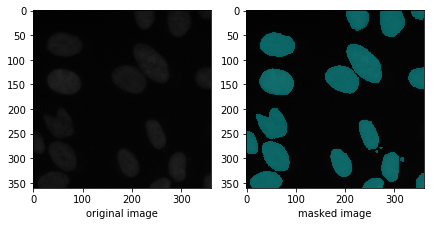

/home/biswajit/Documents/bima/unet/data/train/295ac4ecf2ee0211c065cf5dbb93b1eb8e61347153447209cd110e9c3e355e81/images/295ac4ecf2ee0211c065cf5dbb93b1eb8e61347153447209cd110e9c3e355e81.png


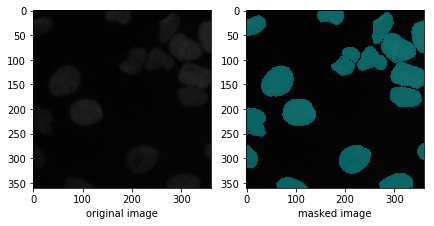

/home/biswajit/Documents/bima/unet/data/train/0c6507d493bf79b2ba248c5cca3d14df8b67328b89efa5f4a32f97a06a88c92c/images/0c6507d493bf79b2ba248c5cca3d14df8b67328b89efa5f4a32f97a06a88c92c.png


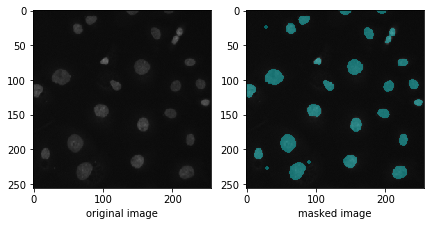

/home/biswajit/Documents/bima/unet/data/train/f20eb4592e7d3cf58d421a9c34832d33adcdcbd0e17b7bf009a013847608da27/images/f20eb4592e7d3cf58d421a9c34832d33adcdcbd0e17b7bf009a013847608da27.png


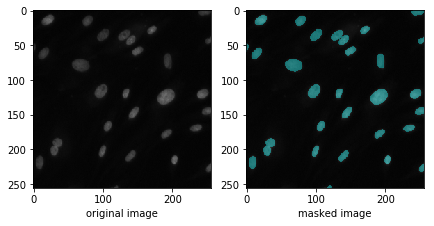

/home/biswajit/Documents/bima/unet/data/train/831218e6a1a54b23d4be56c5799854e7eb978811b89215319dc138900bd563e6/images/831218e6a1a54b23d4be56c5799854e7eb978811b89215319dc138900bd563e6.png


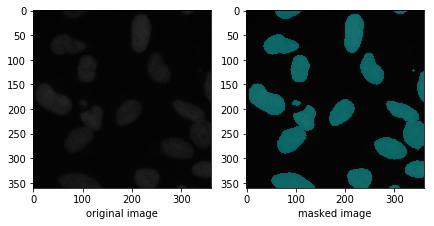

/home/biswajit/Documents/bima/unet/data/train/ddf1bf458312de2895dd9cc5ce7ec9d334ad54c35edc96ad6001d20b1d8588d8/images/ddf1bf458312de2895dd9cc5ce7ec9d334ad54c35edc96ad6001d20b1d8588d8.png


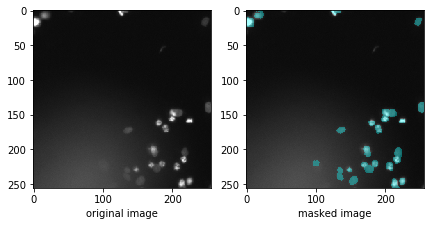

/home/biswajit/Documents/bima/unet/data/train/1740b0a67ca337ea31648b57c81bcfbb841c7bb5cad185199a9f4da596d531b9/images/1740b0a67ca337ea31648b57c81bcfbb841c7bb5cad185199a9f4da596d531b9.png


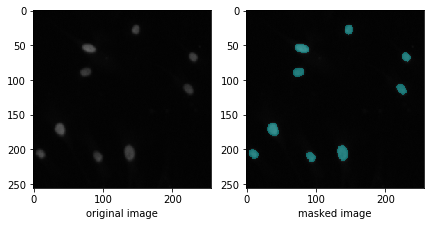

/home/biswajit/Documents/bima/unet/data/train/a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e/images/a0325cb7aa59e9c0a75e64ba26855d8032c46161aa4bca0c01bac5e4a836485e.png


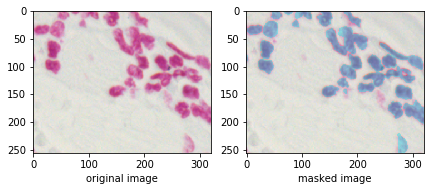

/home/biswajit/Documents/bima/unet/data/train/6eefe1f0d9c2d2c2380db3ecd2113a566ace7dfc917687bb5033b4af5b8293aa/images/6eefe1f0d9c2d2c2380db3ecd2113a566ace7dfc917687bb5033b4af5b8293aa.png


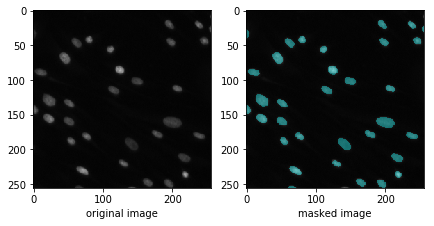

/home/biswajit/Documents/bima/unet/data/train/e4fc936ba57a936aaa5941ccc70946ab18fcebcb6e8d85a097c584aff9ca4d88/images/e4fc936ba57a936aaa5941ccc70946ab18fcebcb6e8d85a097c584aff9ca4d88.png


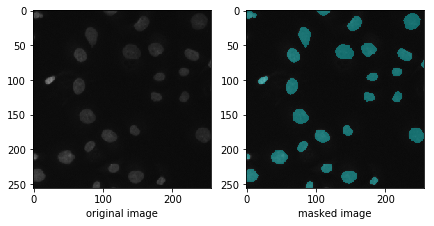

/home/biswajit/Documents/bima/unet/data/train/a6e81120d1cb9f71f8a25f90a5d56c4b714a642fc496a705e38921fd90a3f69c/images/a6e81120d1cb9f71f8a25f90a5d56c4b714a642fc496a705e38921fd90a3f69c.png


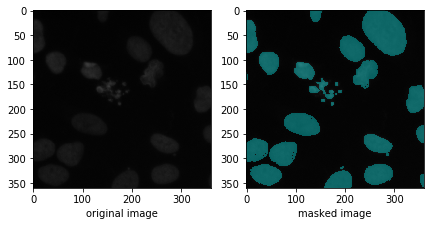

/home/biswajit/Documents/bima/unet/data/train/4b274461c6d001a7a9aeaf5952b40ac4934d1be96b9c176edfd628a8f77e6df2/images/4b274461c6d001a7a9aeaf5952b40ac4934d1be96b9c176edfd628a8f77e6df2.png


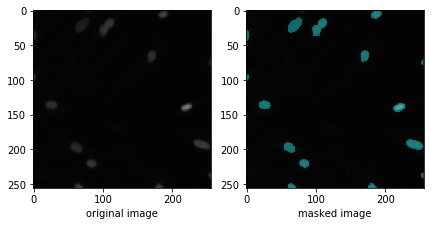

/home/biswajit/Documents/bima/unet/data/train/8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845/images/8055957570d7b38f0acecdb56f3078a963a1a7307ca03fcca62212e0e95e5845.png


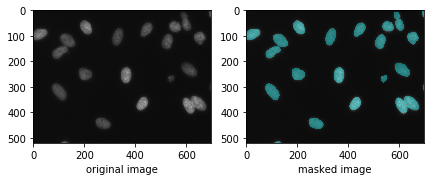

/home/biswajit/Documents/bima/unet/data/train/cab4875269f44a701c5e58190a1d2f6fcb577ea79d842522dcab20ccb39b7ad2/images/cab4875269f44a701c5e58190a1d2f6fcb577ea79d842522dcab20ccb39b7ad2.png


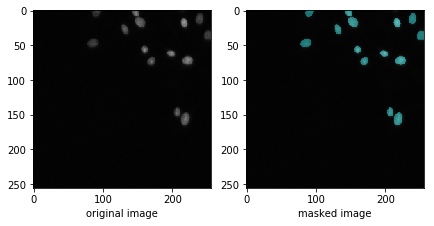

/home/biswajit/Documents/bima/unet/data/train/514ccfc78cb55988a238d3ac9dc83460aa88382c95d56bcc0559962d9fe481ef/images/514ccfc78cb55988a238d3ac9dc83460aa88382c95d56bcc0559962d9fe481ef.png


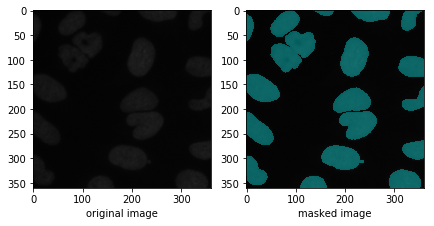

/home/biswajit/Documents/bima/unet/data/train/3ca8181367fc1258a418f7bf5044533c83e02a59c1a96def043295c429c297a8/images/3ca8181367fc1258a418f7bf5044533c83e02a59c1a96def043295c429c297a8.png


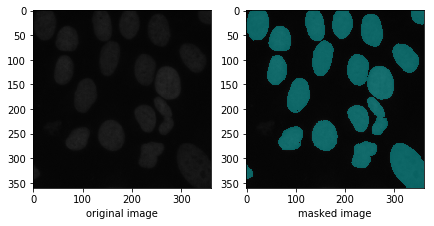

/home/biswajit/Documents/bima/unet/data/train/75120baa6abcbfe750a4eb223b8c10ae6bc3bebdda7b00d9a78bc2472fa28625/images/75120baa6abcbfe750a4eb223b8c10ae6bc3bebdda7b00d9a78bc2472fa28625.png


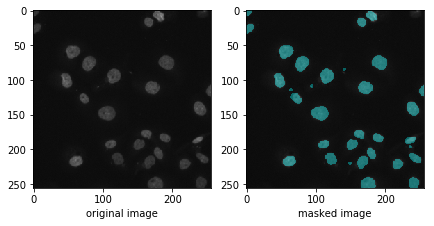

/home/biswajit/Documents/bima/unet/data/train/45c3bdef1819ba7029990e159f61543ed25781d13fb4dc5d4de52e803debd7d3/images/45c3bdef1819ba7029990e159f61543ed25781d13fb4dc5d4de52e803debd7d3.png


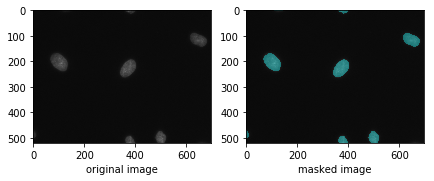

/home/biswajit/Documents/bima/unet/data/train/5953af5080d981b554529971903d8bee9871457a4361b51f04ba04f43793dd8f/images/5953af5080d981b554529971903d8bee9871457a4361b51f04ba04f43793dd8f.png


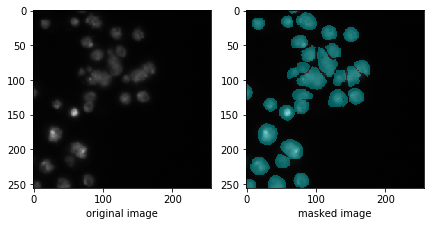

/home/biswajit/Documents/bima/unet/data/train/2d53d7ec0c579fffd6710c956288537d46c719a93c6a04ac0d6550f75a6a6493/images/2d53d7ec0c579fffd6710c956288537d46c719a93c6a04ac0d6550f75a6a6493.png


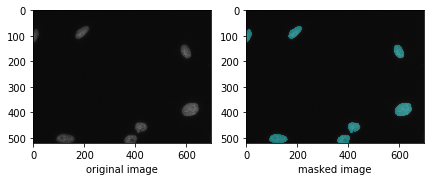

/home/biswajit/Documents/bima/unet/data/train/564fa390d9a9c26f986bf860d9091cbd84244bc1c8e3c9369f2f2e5b5fd99b92/images/564fa390d9a9c26f986bf860d9091cbd84244bc1c8e3c9369f2f2e5b5fd99b92.png


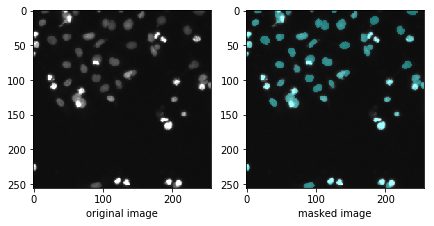

/home/biswajit/Documents/bima/unet/data/train/c9f305be17312bdb9530fb4f1adc6d29730ddbe0e74730cbf031de174bf437b7/images/c9f305be17312bdb9530fb4f1adc6d29730ddbe0e74730cbf031de174bf437b7.png


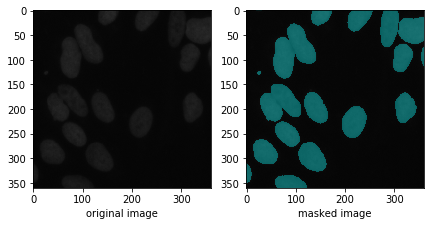

/home/biswajit/Documents/bima/unet/data/train/4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9d06d60ebe34951dca4/images/4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9d06d60ebe34951dca4.png


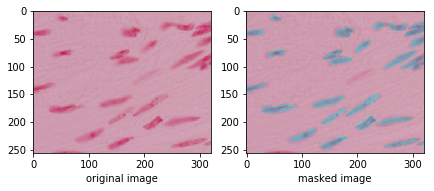

/home/biswajit/Documents/bima/unet/data/train/9ebcfaf2322932d464f15b5662cae4d669b2d785b8299556d73fffcae8365d32/images/9ebcfaf2322932d464f15b5662cae4d669b2d785b8299556d73fffcae8365d32.png


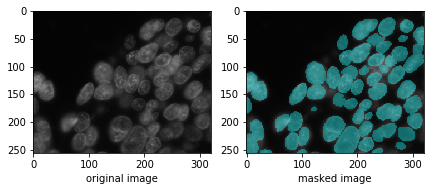

/home/biswajit/Documents/bima/unet/data/train/b3bfd873fca7ff9b2e90f507dfdbe165bb8c153399b6ba5829aa59bae677a91d/images/b3bfd873fca7ff9b2e90f507dfdbe165bb8c153399b6ba5829aa59bae677a91d.png


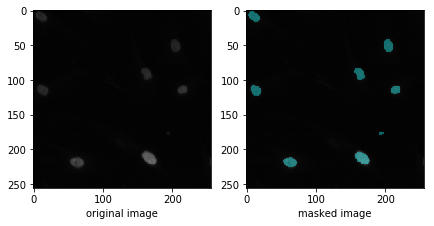

/home/biswajit/Documents/bima/unet/data/train/79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324/images/79dfcbc9361edd3a1ffe81a5bdaa22a197ad1341f3fa64b86a646c2607d6b324.png


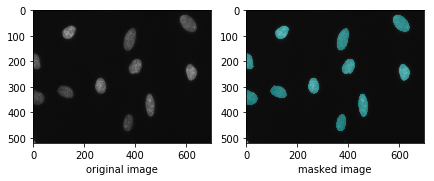

/home/biswajit/Documents/bima/unet/data/train/7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105/images/7aae06bc4558829473071defec0b7ab3bfa9c5005548a13da95596bb6a66d105.png


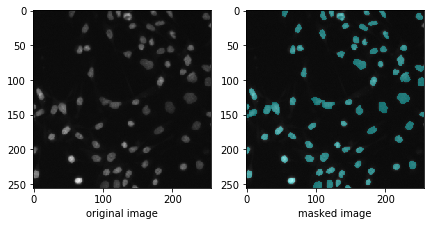

/home/biswajit/Documents/bima/unet/data/train/0e5edb072788c7b1da8829b02a49ba25668b09f7201cf2b70b111fc3b853d14f/images/0e5edb072788c7b1da8829b02a49ba25668b09f7201cf2b70b111fc3b853d14f.png


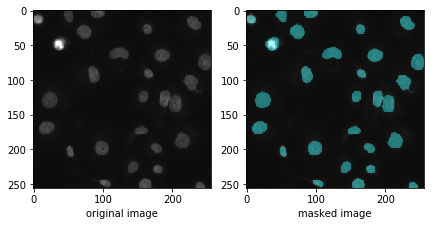

/home/biswajit/Documents/bima/unet/data/train/c043d5ac9dd466052e53491d0d513b0684f493d320b820f6dc2e05330ce58ec3/images/c043d5ac9dd466052e53491d0d513b0684f493d320b820f6dc2e05330ce58ec3.png


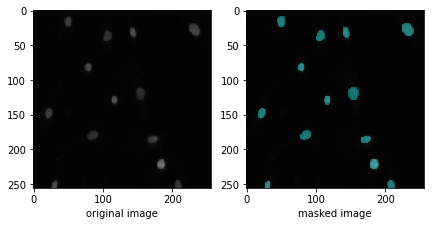

/home/biswajit/Documents/bima/unet/data/train/57bd029b19c1b382bef9db3ac14f13ea85e36a6053b92e46caedee95c05847ab/images/57bd029b19c1b382bef9db3ac14f13ea85e36a6053b92e46caedee95c05847ab.png


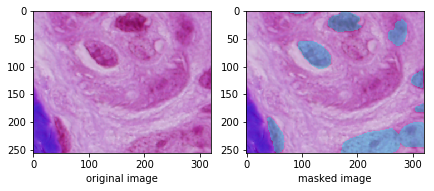

/home/biswajit/Documents/bima/unet/data/train/2ab91a4408860ae8339689ed9f87aa9359de1bdd4ca5c2eab7fff7724dbd6707/images/2ab91a4408860ae8339689ed9f87aa9359de1bdd4ca5c2eab7fff7724dbd6707.png


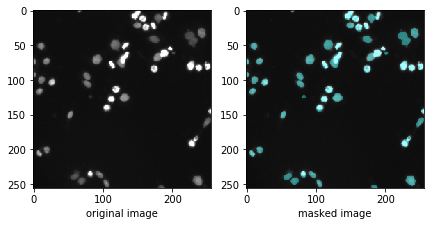

/home/biswajit/Documents/bima/unet/data/train/e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0/images/e81c758e1ca177b0942ecad62cf8d321ffc315376135bcbed3df932a6e5b40c0.png


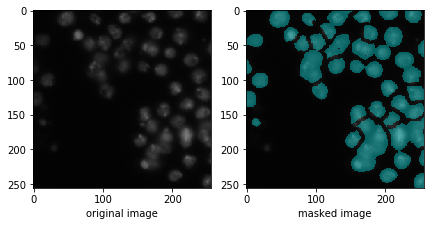

/home/biswajit/Documents/bima/unet/data/train/ec486143ecfec847c22cd8cbc207d85312bcf38e61c9b9a805e0d12add62da8d/images/ec486143ecfec847c22cd8cbc207d85312bcf38e61c9b9a805e0d12add62da8d.png


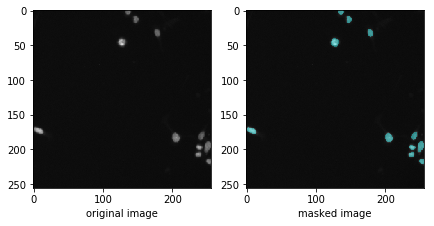

/home/biswajit/Documents/bima/unet/data/train/a246bcaa64af48ee5ca181cd594c0fc43466e7614406eb8bc01199a16ebc95d0/images/a246bcaa64af48ee5ca181cd594c0fc43466e7614406eb8bc01199a16ebc95d0.png


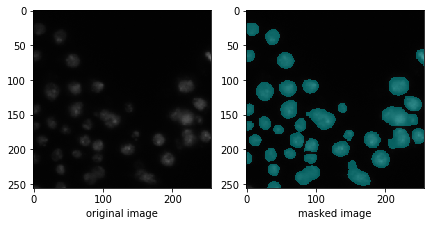

/home/biswajit/Documents/bima/unet/data/train/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089/images/9620c33d8ef2772dbc5bd152429f507bd7fafb27e12109003292b671e556b089.png


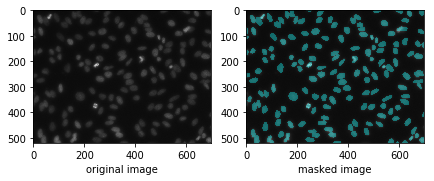

/home/biswajit/Documents/bima/unet/data/train/a815a986800a95de0957116c6585deea8ffb6ee09ad00ccc687306937ac698d0/images/a815a986800a95de0957116c6585deea8ffb6ee09ad00ccc687306937ac698d0.png


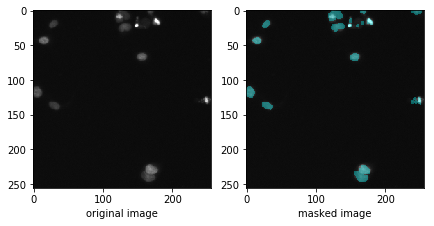

/home/biswajit/Documents/bima/unet/data/train/86f9087eb1d0875ffb1a28cca7645b14d6c66f995c7d96aa13969d2f8115d533/images/86f9087eb1d0875ffb1a28cca7645b14d6c66f995c7d96aa13969d2f8115d533.png


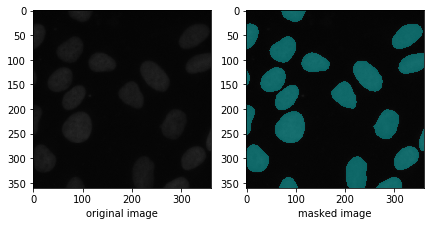

/home/biswajit/Documents/bima/unet/data/train/8f27ebc74164eddfe989a98a754dcf5a9c85ef599a1321de24bcf097df1814ca/images/8f27ebc74164eddfe989a98a754dcf5a9c85ef599a1321de24bcf097df1814ca.png


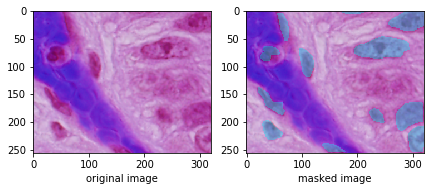

/home/biswajit/Documents/bima/unet/data/train/f9ea1a1159c33f39bbe5f18bb278d961188b40508277eab7c0b4b91219b37b5d/images/f9ea1a1159c33f39bbe5f18bb278d961188b40508277eab7c0b4b91219b37b5d.png


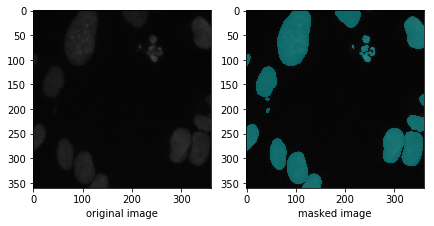

/home/biswajit/Documents/bima/unet/data/train/442c4eb0185698fe7d148c108a46f74abd399aecda2f4f22981a1671cd95dd7d/images/442c4eb0185698fe7d148c108a46f74abd399aecda2f4f22981a1671cd95dd7d.png


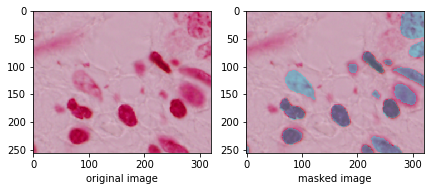

/home/biswajit/Documents/bima/unet/data/train/f487cc82271cf84b4414552aa8b0a9d82d902451ebe8e8bc639d4121c1672ff7/images/f487cc82271cf84b4414552aa8b0a9d82d902451ebe8e8bc639d4121c1672ff7.png


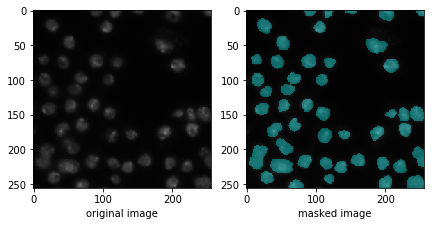

/home/biswajit/Documents/bima/unet/data/train/f43169e3d8b4f71e687945b9e72cbfdfe2e40e68842568e6a30c60d64c1378b6/images/f43169e3d8b4f71e687945b9e72cbfdfe2e40e68842568e6a30c60d64c1378b6.png


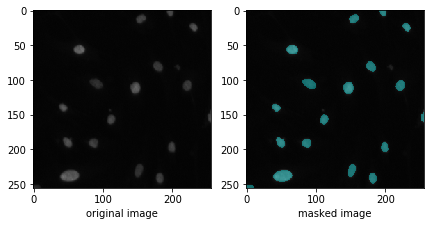

/home/biswajit/Documents/bima/unet/data/train/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf/images/2246874c8b5ba218d01ad8153a201ad4660195f3e4c65da6b9d4ccaf82cb7edf.png


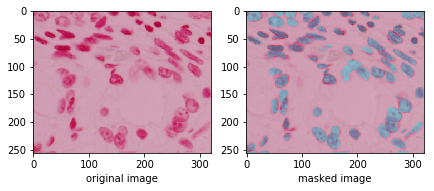

/home/biswajit/Documents/bima/unet/data/train/fc9269fb2e651cd4a32b65ae164f79b0a2ea823e0a83508c85d7985a6bed43cf/images/fc9269fb2e651cd4a32b65ae164f79b0a2ea823e0a83508c85d7985a6bed43cf.png


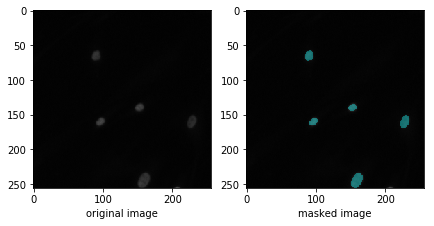

/home/biswajit/Documents/bima/unet/data/train/813f41ef376c3cbcc9d6e2ce6a51c2ee068226d1c1b13404eb238dcfdd447c97/images/813f41ef376c3cbcc9d6e2ce6a51c2ee068226d1c1b13404eb238dcfdd447c97.png


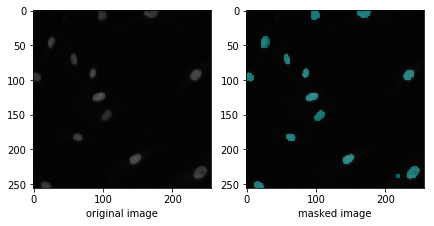

/home/biswajit/Documents/bima/unet/data/train/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94/images/4590d7d47f521df62f3bcb0bf74d1bca861d94ade614d8afc912d1009d607b94.png


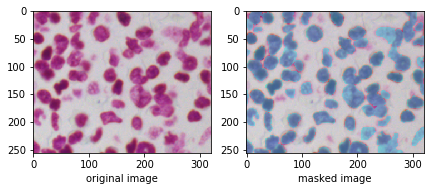

/home/biswajit/Documents/bima/unet/data/train/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51/images/449a9c32e53a37c8a86e01c199155c8da3958b631088e10f6fe43c2119defe51.png


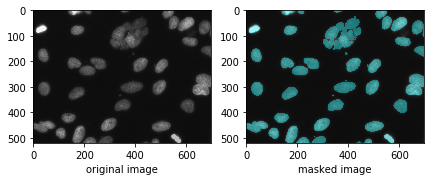

/home/biswajit/Documents/bima/unet/data/train/3441821ebea04face181c9e2f4d0d09727c764827ac51b9e7fbadbebabeab225/images/3441821ebea04face181c9e2f4d0d09727c764827ac51b9e7fbadbebabeab225.png


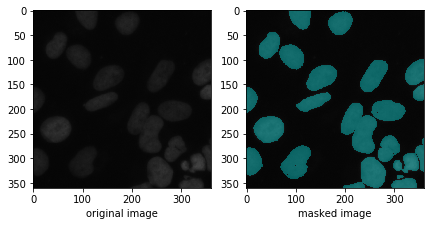

/home/biswajit/Documents/bima/unet/data/train/fd8065bcb1afdbed19e028465d5d00cd2ecadc4558de05c6fa28bea3c817aa22/images/fd8065bcb1afdbed19e028465d5d00cd2ecadc4558de05c6fa28bea3c817aa22.png


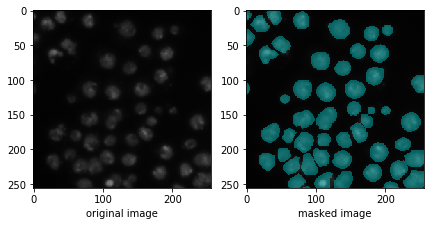

/home/biswajit/Documents/bima/unet/data/train/1b2bf5933b0fb82918d278983bee66e9532b53807c3638efd9af66d20a2bae88/images/1b2bf5933b0fb82918d278983bee66e9532b53807c3638efd9af66d20a2bae88.png


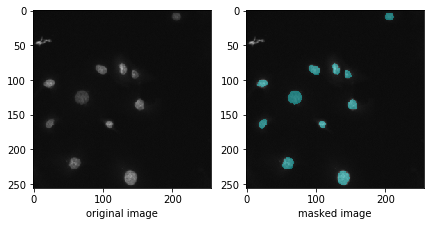

/home/biswajit/Documents/bima/unet/data/train/1e8408fbb1619e7a0bcdd0bcd21fae57e7cb1f297d4c79787a9d0f5695d77073/images/1e8408fbb1619e7a0bcdd0bcd21fae57e7cb1f297d4c79787a9d0f5695d77073.png


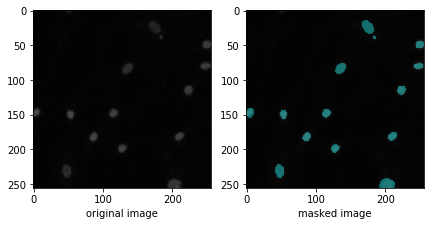

/home/biswajit/Documents/bima/unet/data/train/e4537e7893e631f3ba6ae5b1023e24b233c78249a31c2f5e561f6c4cad88fcf6/images/e4537e7893e631f3ba6ae5b1023e24b233c78249a31c2f5e561f6c4cad88fcf6.png


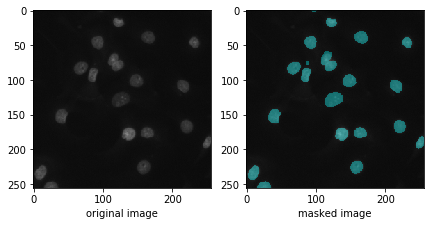

/home/biswajit/Documents/bima/unet/data/train/a1777737270c5f96c4523dff76e4097756f8f7d4c9d59bac079e31f9510deabd/images/a1777737270c5f96c4523dff76e4097756f8f7d4c9d59bac079e31f9510deabd.png


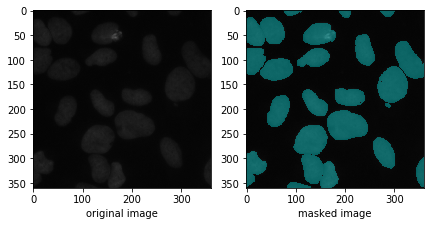

/home/biswajit/Documents/bima/unet/data/train/bff985591dd5d6303018a6e9a3dcfb336771a414ad4605c24ce1c1155fc86a96/images/bff985591dd5d6303018a6e9a3dcfb336771a414ad4605c24ce1c1155fc86a96.png


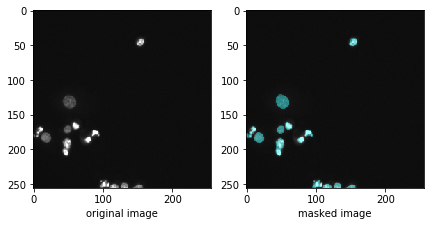

/home/biswajit/Documents/bima/unet/data/train/89be66f88612aae541f5843abcd9c015832b5d6c54a28103b3019f7f38df8a6d/images/89be66f88612aae541f5843abcd9c015832b5d6c54a28103b3019f7f38df8a6d.png


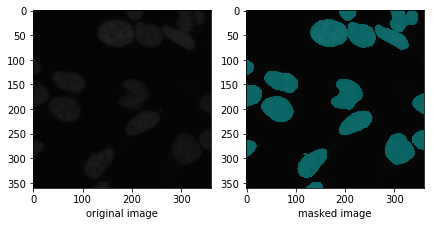

/home/biswajit/Documents/bima/unet/data/train/98c5ead89cd066637efd5c93a6edc55c85908eb66807471f0d246d5457341f9c/images/98c5ead89cd066637efd5c93a6edc55c85908eb66807471f0d246d5457341f9c.png


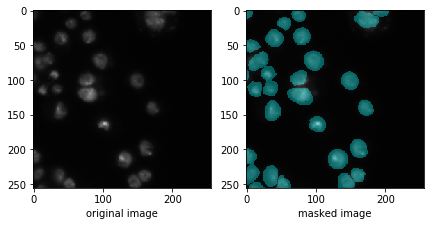

/home/biswajit/Documents/bima/unet/data/train/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051/images/65c8527c16a016191118e8adc3d307fe3a73d37cbe05597a95aebd75daf8d051.png


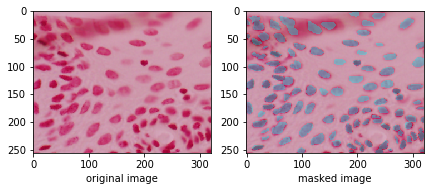

/home/biswajit/Documents/bima/unet/data/train/930f246a8e4ff273a72a6e4b3cf8e8caff94fca4eaf1dbe6f93ba37b8195c0a0/images/930f246a8e4ff273a72a6e4b3cf8e8caff94fca4eaf1dbe6f93ba37b8195c0a0.png


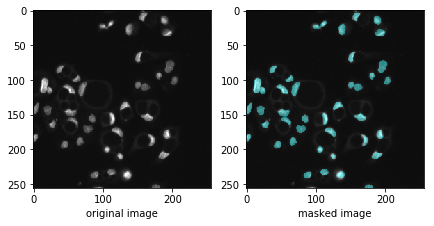

/home/biswajit/Documents/bima/unet/data/train/c00ae67f72816daee468474026e30705003b2d3501f123579a4f0a6366b66aa1/images/c00ae67f72816daee468474026e30705003b2d3501f123579a4f0a6366b66aa1.png


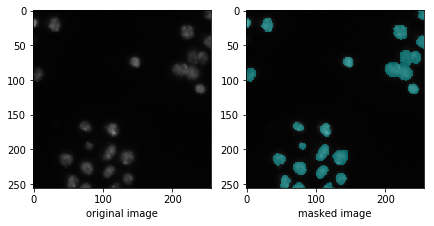

/home/biswajit/Documents/bima/unet/data/train/29ea4f6eb4545f43868a9b40a60000426bf8dfd9d062546656a37bd2a2aaf9ec/images/29ea4f6eb4545f43868a9b40a60000426bf8dfd9d062546656a37bd2a2aaf9ec.png


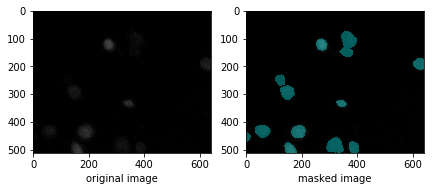

/home/biswajit/Documents/bima/unet/data/train/1d5f4717e179a03675a5aac3fc1c862fb442ddc3e373923016fd6b1430da889b/images/1d5f4717e179a03675a5aac3fc1c862fb442ddc3e373923016fd6b1430da889b.png


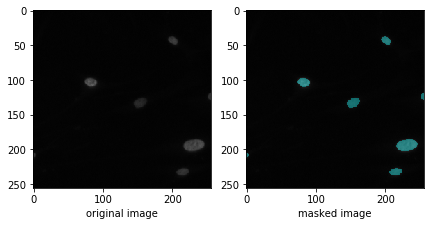

/home/biswajit/Documents/bima/unet/data/train/5908488d940e846cc121c768758da9b1bd5b9922417e20c9101a4e254fa98af8/images/5908488d940e846cc121c768758da9b1bd5b9922417e20c9101a4e254fa98af8.png


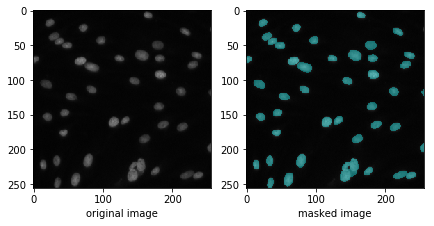

/home/biswajit/Documents/bima/unet/data/train/64eeef16fdc4e26523d27bfa71a1d38d2cb2e4fa116c0d0ea56b1322f806f0b9/images/64eeef16fdc4e26523d27bfa71a1d38d2cb2e4fa116c0d0ea56b1322f806f0b9.png


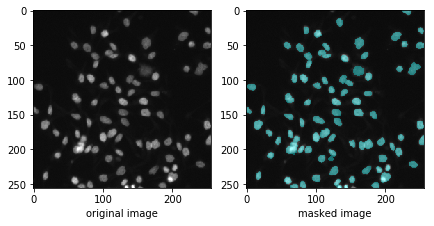

/home/biswajit/Documents/bima/unet/data/train/c620631271a56407d6d69fa1a69451ca99c50dcc30e29db04cf6fb7cacbde8cb/images/c620631271a56407d6d69fa1a69451ca99c50dcc30e29db04cf6fb7cacbde8cb.png


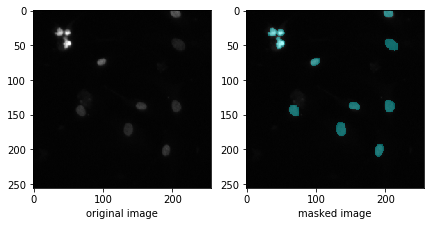

/home/biswajit/Documents/bima/unet/data/train/40bcdad218ac5f0885fc247d88fcad9f729f55c81c79d241a8f1559b6d8c0574/images/40bcdad218ac5f0885fc247d88fcad9f729f55c81c79d241a8f1559b6d8c0574.png


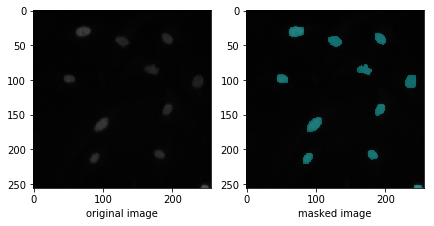

/home/biswajit/Documents/bima/unet/data/train/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc/images/49edc2f7715100fb0390916e52b3fd11a921f02e59509dc987f67840a36250fc.png


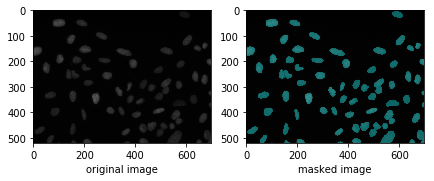

/home/biswajit/Documents/bima/unet/data/train/1d02c4b5921e916b9ddfb2f741fd6cf8d0e571ad51eb20e021c826b5fb87350e/images/1d02c4b5921e916b9ddfb2f741fd6cf8d0e571ad51eb20e021c826b5fb87350e.png


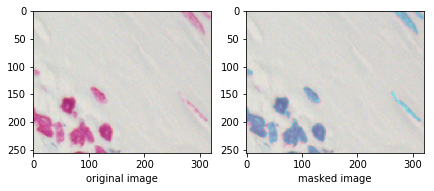

/home/biswajit/Documents/bima/unet/data/train/a0de55384fada5cbc46bd7a41f6feeef93b67d088497c7316079ccec39c2a834/images/a0de55384fada5cbc46bd7a41f6feeef93b67d088497c7316079ccec39c2a834.png


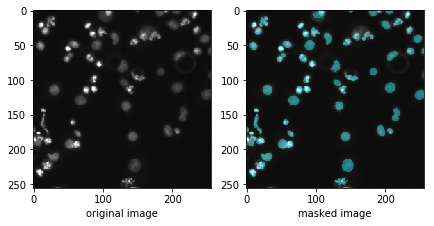

/home/biswajit/Documents/bima/unet/data/train/9e4f8ec60a0d622a02c0e16eedcc0101f88ddefbcec2383946c4572b57a1e43a/images/9e4f8ec60a0d622a02c0e16eedcc0101f88ddefbcec2383946c4572b57a1e43a.png


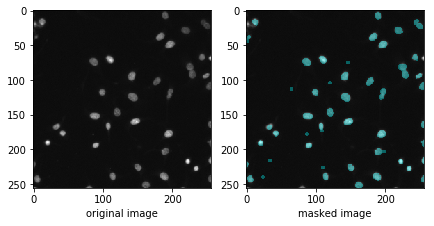

/home/biswajit/Documents/bima/unet/data/train/e2d22d3d283915df8350d039278e314a23e6e8f2b41bdfc16df849e22dd13b36/images/e2d22d3d283915df8350d039278e314a23e6e8f2b41bdfc16df849e22dd13b36.png


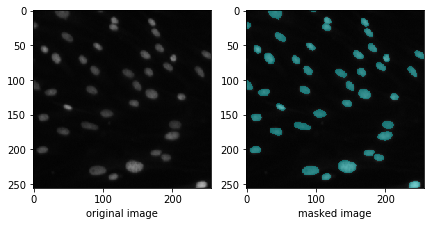

/home/biswajit/Documents/bima/unet/data/train/f35ab34528e3e2d2589d24cbffc0e10024dfc474a68585d0b5feb7b05aa0067f/images/f35ab34528e3e2d2589d24cbffc0e10024dfc474a68585d0b5feb7b05aa0067f.png


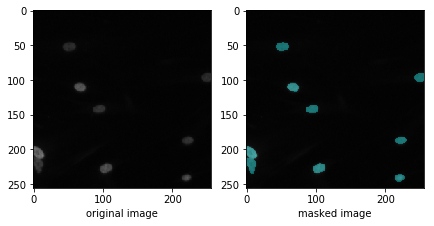

/home/biswajit/Documents/bima/unet/data/train/c1afe66cd139f996fd984f5f2622903730ec2f1192d90608154f07f7ef6cdb4b/images/c1afe66cd139f996fd984f5f2622903730ec2f1192d90608154f07f7ef6cdb4b.png


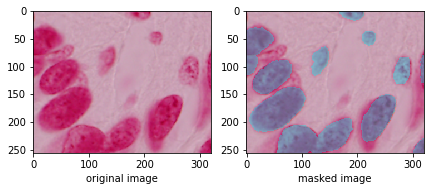

/home/biswajit/Documents/bima/unet/data/train/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614/images/708eb41a3fc8f2b6cd1f529cdf38dc4ad5d5f00ad30bdcba92884f37ff78d614.png


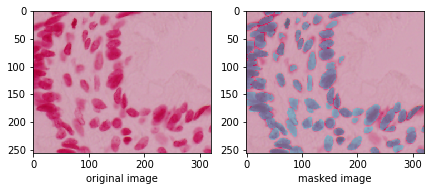

/home/biswajit/Documents/bima/unet/data/train/b6d50fa22380ae3a7e8c52c5bc44a254e7b2596fd8927980dbe2c160cb5689b5/images/b6d50fa22380ae3a7e8c52c5bc44a254e7b2596fd8927980dbe2c160cb5689b5.png


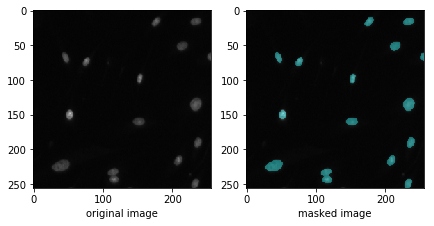

/home/biswajit/Documents/bima/unet/data/train/777f7c4269279951ae05b56e806745e613297d411d048c0bce8964afd7d71a4b/images/777f7c4269279951ae05b56e806745e613297d411d048c0bce8964afd7d71a4b.png


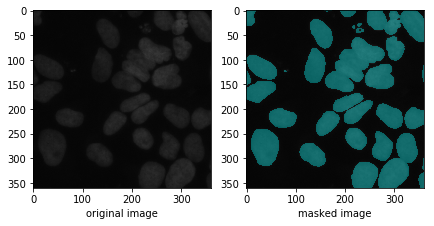

/home/biswajit/Documents/bima/unet/data/train/8e507d58f4c27cd2a82bee79fe27b069befd62a46fdaed20970a95a2ba819c7b/images/8e507d58f4c27cd2a82bee79fe27b069befd62a46fdaed20970a95a2ba819c7b.png


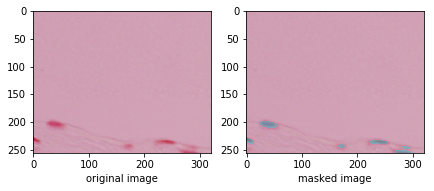

/home/biswajit/Documents/bima/unet/data/train/573a657d5e5fcb9574a758b0ab34b09c79d7ba374ceb71227c3dc88f009a3f6b/images/573a657d5e5fcb9574a758b0ab34b09c79d7ba374ceb71227c3dc88f009a3f6b.png


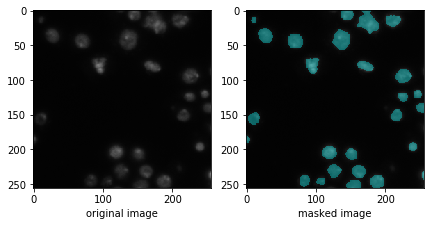

/home/biswajit/Documents/bima/unet/data/train/d2ce593bddf9998ce3b76328c0151d0ba4b644c293aca7f6254e521c448b305f/images/d2ce593bddf9998ce3b76328c0151d0ba4b644c293aca7f6254e521c448b305f.png


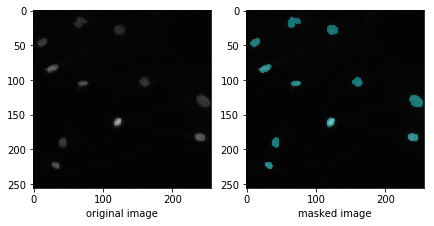

/home/biswajit/Documents/bima/unet/data/train/2817299fd3b88670e86a9db5651ba24333c299d1d41e5491aabfcd95aee84174/images/2817299fd3b88670e86a9db5651ba24333c299d1d41e5491aabfcd95aee84174.png


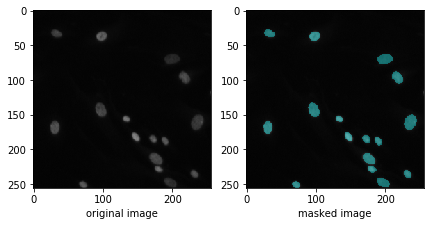

/home/biswajit/Documents/bima/unet/data/train/3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940/images/3bfa8b3b01fd24a28477f103063d17368a7398b27331e020f3a0ef59bf68c940.png


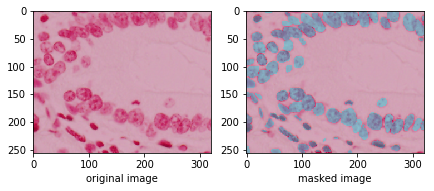

/home/biswajit/Documents/bima/unet/data/train/a6593632dcbbe4c9e9429a9cec573d26fd8c91a47d554d315f25e7c2e0280ee3/images/a6593632dcbbe4c9e9429a9cec573d26fd8c91a47d554d315f25e7c2e0280ee3.png


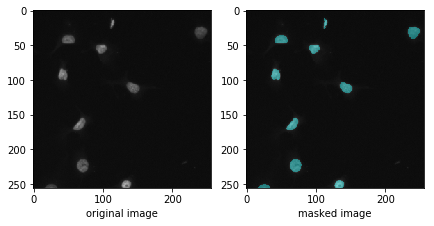

/home/biswajit/Documents/bima/unet/data/train/fdda64c47361b0d1a146e5b7b48dc6b7de615ea80b31f01227a3b16469589528/images/fdda64c47361b0d1a146e5b7b48dc6b7de615ea80b31f01227a3b16469589528.png


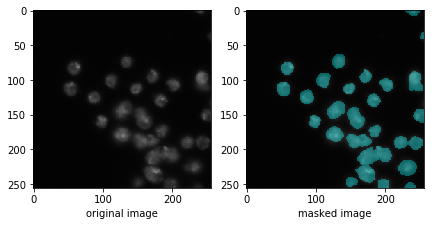

/home/biswajit/Documents/bima/unet/data/train/9cbc0700317361236a9fca2eb1f8f79e3a7da17b1970c179cf453921a6136001/images/9cbc0700317361236a9fca2eb1f8f79e3a7da17b1970c179cf453921a6136001.png


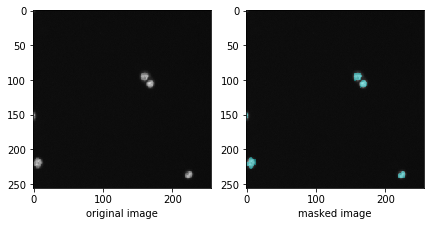

/home/biswajit/Documents/bima/unet/data/train/337b6eed0726f07531cd467cd62b6676c31a8c9e716bdbc49433986c022252cf/images/337b6eed0726f07531cd467cd62b6676c31a8c9e716bdbc49433986c022252cf.png


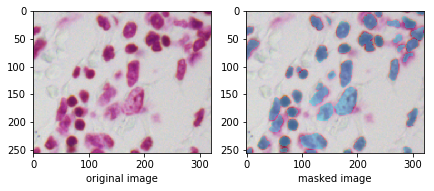

/home/biswajit/Documents/bima/unet/data/train/709e094e39629a9ca21e187f007b331074694e443db40289447c1111f7e267e7/images/709e094e39629a9ca21e187f007b331074694e443db40289447c1111f7e267e7.png


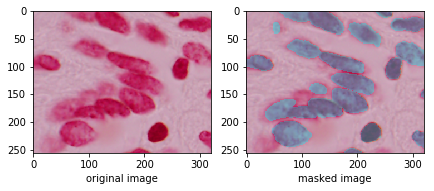

/home/biswajit/Documents/bima/unet/data/train/abd8dde78f8d37b68b28da67459371ed65f0a575523e94bc4ecbc88e6fedf0d0/images/abd8dde78f8d37b68b28da67459371ed65f0a575523e94bc4ecbc88e6fedf0d0.png


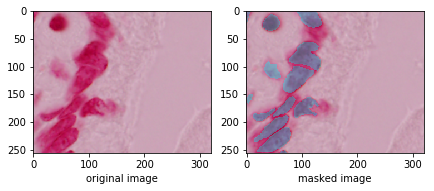

/home/biswajit/Documents/bima/unet/data/train/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0/images/d52958107d0b1f0288f50f346a833df3df485b92d5516cfcb536e73ab7adafd0.png


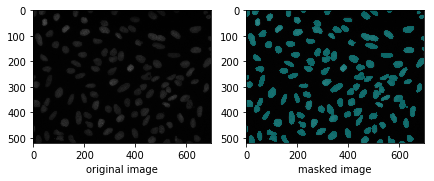

/home/biswajit/Documents/bima/unet/data/train/ff3407842ada5bc18be79ae453e5bdaa1b68afc842fc22fa618ac6e6599d0bb3/images/ff3407842ada5bc18be79ae453e5bdaa1b68afc842fc22fa618ac6e6599d0bb3.png


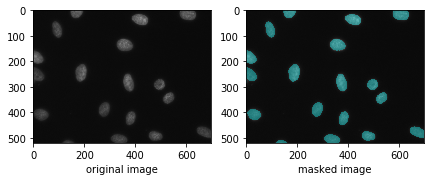

/home/biswajit/Documents/bima/unet/data/train/220b37f4ca7cab486d2b71cd87a46ee7411a5aa142799d96ed98015ab5ba538a/images/220b37f4ca7cab486d2b71cd87a46ee7411a5aa142799d96ed98015ab5ba538a.png


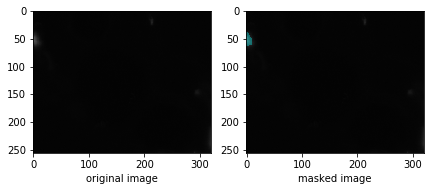

/home/biswajit/Documents/bima/unet/data/train/12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e/images/12f89395ad5d21491ab9cec137e247652451d283064773507d7dc362243c5b8e.png


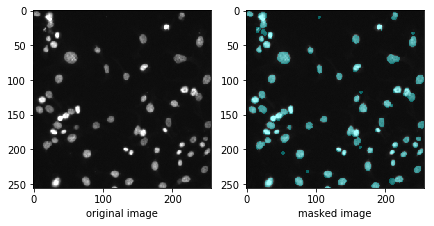

/home/biswajit/Documents/bima/unet/data/train/673baf65ae5c571d6be452eb41e79ef3fc2eb3fd238e621c6b7621763b429989/images/673baf65ae5c571d6be452eb41e79ef3fc2eb3fd238e621c6b7621763b429989.png


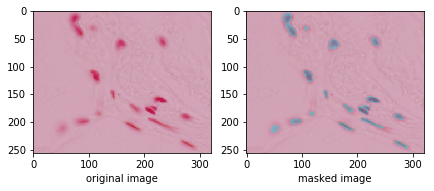

/home/biswajit/Documents/bima/unet/data/train/66236902b874b7e4b3891db63a69f6d56f6edcec6aca7ba3c6871d73e7b4c34f/images/66236902b874b7e4b3891db63a69f6d56f6edcec6aca7ba3c6871d73e7b4c34f.png


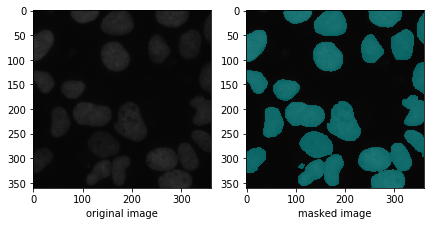

/home/biswajit/Documents/bima/unet/data/train/91cc2e0d4d6e2c1ad59a8d63bcbe3e2ea8bc7f8e642e942a0113450181e73379/images/91cc2e0d4d6e2c1ad59a8d63bcbe3e2ea8bc7f8e642e942a0113450181e73379.png


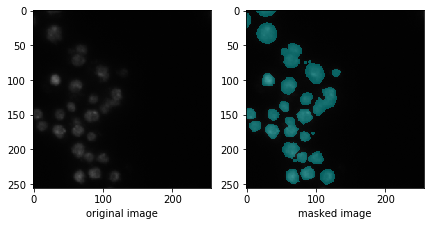

/home/biswajit/Documents/bima/unet/data/train/72e8c49dea44787114fd191f9e97e260f961c6e7ae4715bc95cc91db8d91a4e3/images/72e8c49dea44787114fd191f9e97e260f961c6e7ae4715bc95cc91db8d91a4e3.png


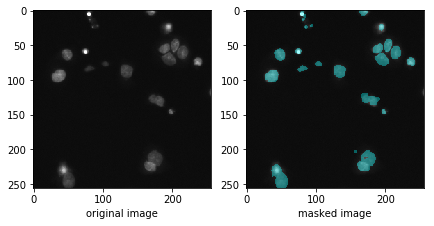

/home/biswajit/Documents/bima/unet/data/train/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c/images/a891bbc89143bca7a717386144eb061ec2d599cba24681389bcb3a2fedb8ff8c.png


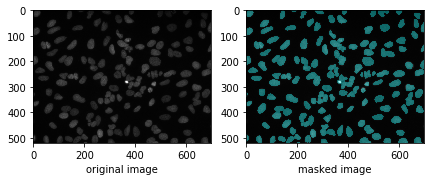

/home/biswajit/Documents/bima/unet/data/train/05040e2e959c3f5632558fc9683fec88f0010026c555b499066346f67fdd0e13/images/05040e2e959c3f5632558fc9683fec88f0010026c555b499066346f67fdd0e13.png


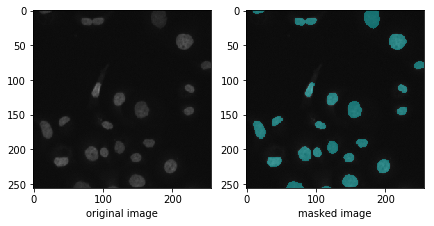

/home/biswajit/Documents/bima/unet/data/train/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d/images/ad473063dab4bf4f2461d9a99a9c0166d4871f156516d9e0a523484e7cf2258d.png


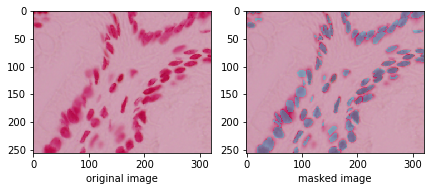

/home/biswajit/Documents/bima/unet/data/train/81e2dd950e6df28a4fe202a40afa98b202981f65a5ca05b389749290eb87c883/images/81e2dd950e6df28a4fe202a40afa98b202981f65a5ca05b389749290eb87c883.png


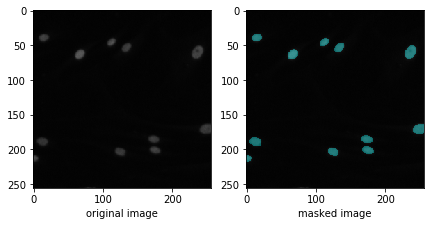

/home/biswajit/Documents/bima/unet/data/train/c6de542205b891eed5c40e6d8ae3d03a6ca39b26dc445b4dbc64340d4d64dd2d/images/c6de542205b891eed5c40e6d8ae3d03a6ca39b26dc445b4dbc64340d4d64dd2d.png


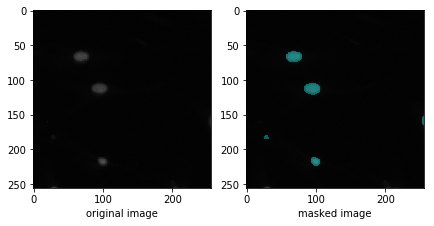

/home/biswajit/Documents/bima/unet/data/train/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423/images/b214800de5ed4cc558f44d569495970f93c8c047f8e464c51d4bd5c276118423.png


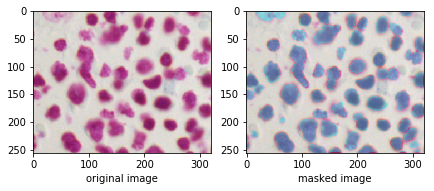

/home/biswajit/Documents/bima/unet/data/train/6fc83b33896f58a4a067d8fdcf51f15d4ae9be05d8c3815d23336f1f2a8c45a1/images/6fc83b33896f58a4a067d8fdcf51f15d4ae9be05d8c3815d23336f1f2a8c45a1.png


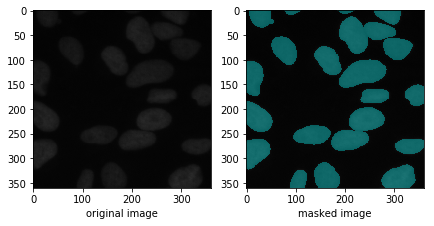

/home/biswajit/Documents/bima/unet/data/train/06350c7cc618be442c15706db7a68e91f313758d224de4608f9b960106d4f9ca/images/06350c7cc618be442c15706db7a68e91f313758d224de4608f9b960106d4f9ca.png


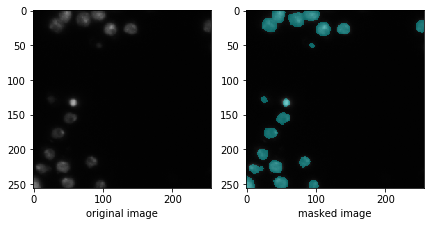

/home/biswajit/Documents/bima/unet/data/train/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81/images/f29fd9c52e04403cd2c7d43b6fe2479292e53b2f61969d25256d2d2aca7c6a81.png


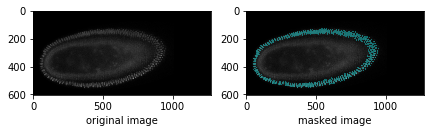

/home/biswajit/Documents/bima/unet/data/train/2dd9d8c797fc695665326fc8fd0eb5cd292139fa478ccb5acb7fb352f7030063/images/2dd9d8c797fc695665326fc8fd0eb5cd292139fa478ccb5acb7fb352f7030063.png


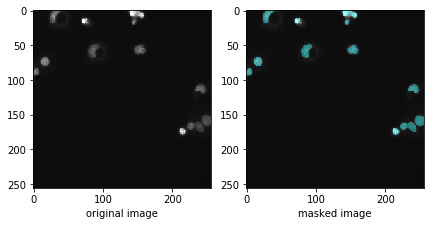

/home/biswajit/Documents/bima/unet/data/train/d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc/images/d6a880b1f6056f3086679de5c810e7af87cdf3bbbd0533a83e3681817fce40fc.png


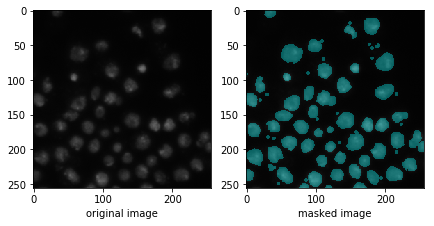

/home/biswajit/Documents/bima/unet/data/train/b909aa8f6f4bec37c3fb6ff5a85d166162d07983506fcc57be742b0f9dbafbf7/images/b909aa8f6f4bec37c3fb6ff5a85d166162d07983506fcc57be742b0f9dbafbf7.png


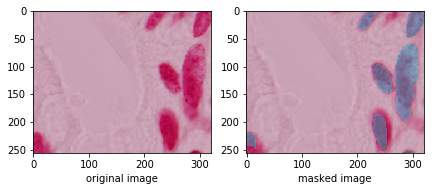

/home/biswajit/Documents/bima/unet/data/train/1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b/images/1400420310c9094361a8a243545187f1d4c2365e081b3bb08c5fa29c7491a55b.png


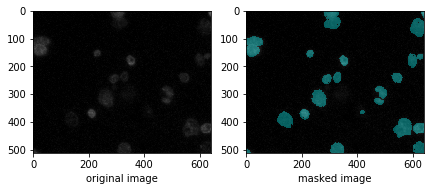

/home/biswajit/Documents/bima/unet/data/train/df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2/images/df53d0b6c2c4e45d759b2c474011e2b2b32552cd100ca4b22388ab9ca1750ee2.png


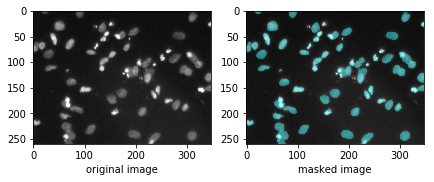

/home/biswajit/Documents/bima/unet/data/train/a90401357d50e1376354ae6e5f56a2e4dff3fdb5a4e8d50316673b2b8f1f293b/images/a90401357d50e1376354ae6e5f56a2e4dff3fdb5a4e8d50316673b2b8f1f293b.png


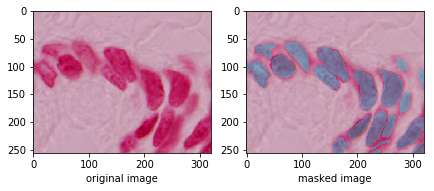

/home/biswajit/Documents/bima/unet/data/train/9c95eae11da041189e84cda20bdfb75716a6594684de4b6ce12a9aaadbb874c9/images/9c95eae11da041189e84cda20bdfb75716a6594684de4b6ce12a9aaadbb874c9.png


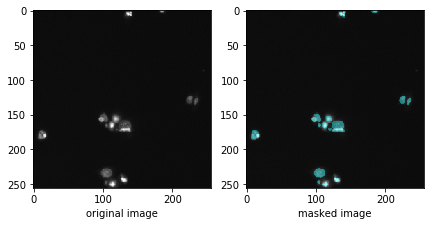

/home/biswajit/Documents/bima/unet/data/train/23830d0e51245fc0c9e410efa4c17d2a7d83a0104a3777130119ab892de47a4e/images/23830d0e51245fc0c9e410efa4c17d2a7d83a0104a3777130119ab892de47a4e.png


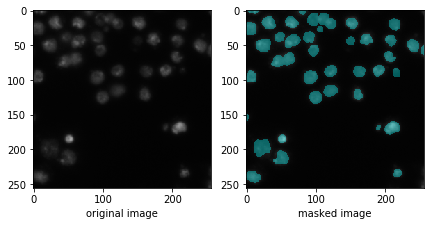

/home/biswajit/Documents/bima/unet/data/train/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d/images/a65bbfc5673e8053b6ce49f39c79cf3a846fe5cc46dd93105f74fb07cf44606d.png


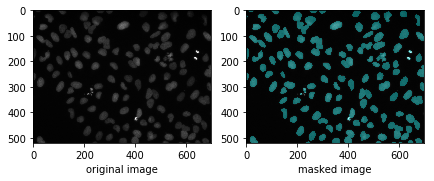

/home/biswajit/Documents/bima/unet/data/train/af576e8ec3a8d0b57eb6a311299e9e4fd2047970d3dd9d6f52e54ea6a91109da/images/af576e8ec3a8d0b57eb6a311299e9e4fd2047970d3dd9d6f52e54ea6a91109da.png


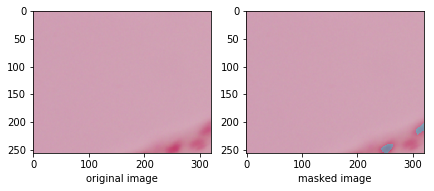

/home/biswajit/Documents/bima/unet/data/train/3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51/images/3477024fd843e46097840360f9cdee24b76bf5c593ed27a9aee7a5728a06aa51.png


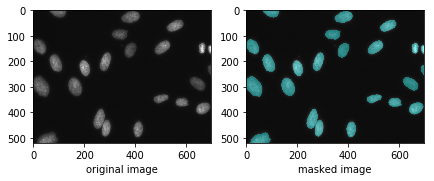

/home/biswajit/Documents/bima/unet/data/train/f534b43bf37ff946a310a0f08315d76c3fb3394681cf523acef7c0682240072a/images/f534b43bf37ff946a310a0f08315d76c3fb3394681cf523acef7c0682240072a.png


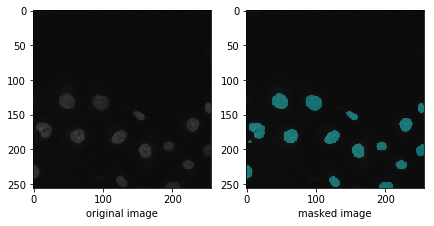

/home/biswajit/Documents/bima/unet/data/train/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc/images/53ad09e4348767bece0165884bf40c10b72ae18444e3f414a850442f02385efc.png


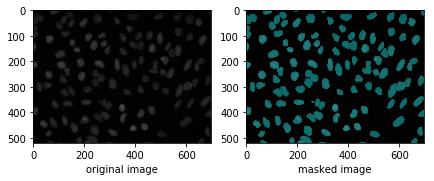

/home/biswajit/Documents/bima/unet/data/train/19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a/images/19f0653c33982a416feed56e5d1ce6849fd83314fd19dfa1c5b23c6b66e9868a.png


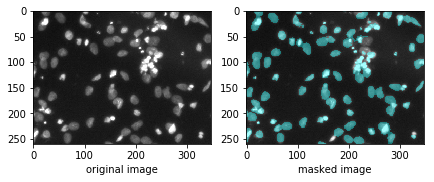

/home/biswajit/Documents/bima/unet/data/train/aa47f0b303b1d525b52452ae3a8553b2d61d719a28aee547e2ef1fc6730a078f/images/aa47f0b303b1d525b52452ae3a8553b2d61d719a28aee547e2ef1fc6730a078f.png


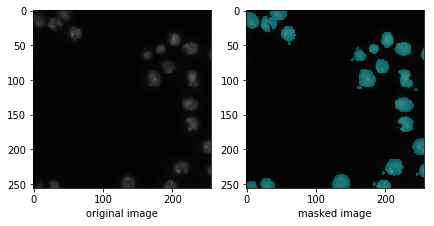

/home/biswajit/Documents/bima/unet/data/train/3a508d2dc03db46e7f97a2a30eabb62ab2886f3cedfea303de8f6a42e50d20eb/images/3a508d2dc03db46e7f97a2a30eabb62ab2886f3cedfea303de8f6a42e50d20eb.png


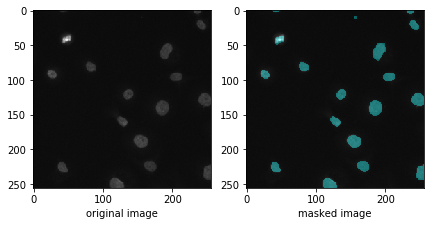

/home/biswajit/Documents/bima/unet/data/train/97158b2fe38783d88d4e44ba1b7bc6c84f225f8b35fcccc2f9265c65f14e7c8b/images/97158b2fe38783d88d4e44ba1b7bc6c84f225f8b35fcccc2f9265c65f14e7c8b.png


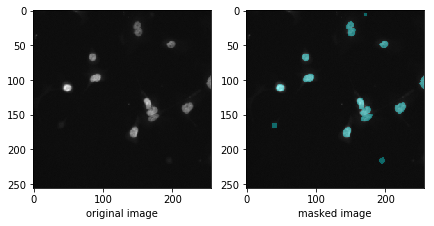

/home/biswajit/Documents/bima/unet/data/train/20468e8779c43e089dc0ff30f25e6cf3872d5aa6a0fdad6f8aca382da43e8582/images/20468e8779c43e089dc0ff30f25e6cf3872d5aa6a0fdad6f8aca382da43e8582.png


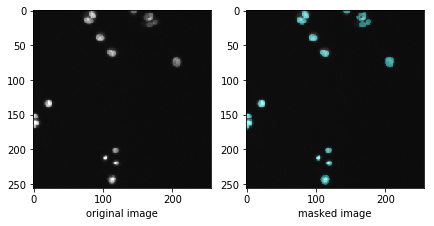

/home/biswajit/Documents/bima/unet/data/train/c7d546766518703580f63d5d8f11d54971044753f53c0b257d19c2f99d4bfdd0/images/c7d546766518703580f63d5d8f11d54971044753f53c0b257d19c2f99d4bfdd0.png


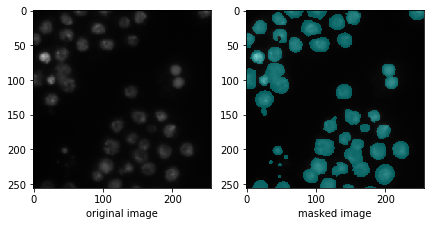

/home/biswajit/Documents/bima/unet/data/train/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0/images/4596961c789d3b41916492918797724fe75128239fefc516c3ee75322b7926f0.png


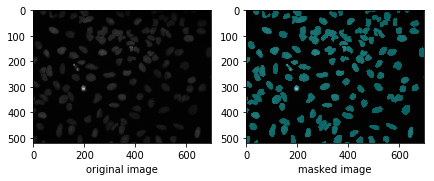

/home/biswajit/Documents/bima/unet/data/train/72b18a405555ad491721e29454e5cd325055ce81a9e78524b56f2c058a4d2327/images/72b18a405555ad491721e29454e5cd325055ce81a9e78524b56f2c058a4d2327.png


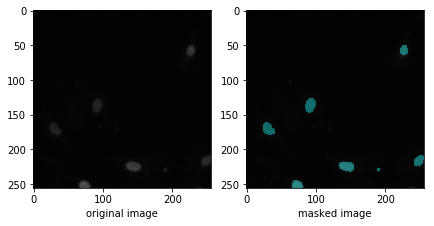

/home/biswajit/Documents/bima/unet/data/train/c53326fe49fc26b7fe602b9d8c0c2da2cb157690b44c2b9351a93f8d9bd8043d/images/c53326fe49fc26b7fe602b9d8c0c2da2cb157690b44c2b9351a93f8d9bd8043d.png


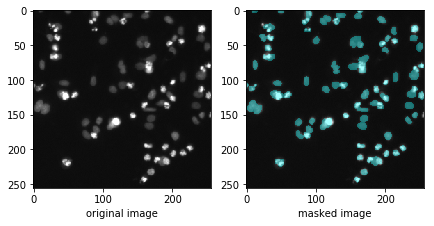

/home/biswajit/Documents/bima/unet/data/train/e5a7b8a9924b26b3abf039255a8a3bb00258f4966f68ff3349560b4350af9367/images/e5a7b8a9924b26b3abf039255a8a3bb00258f4966f68ff3349560b4350af9367.png


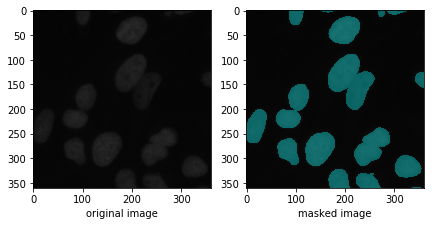

/home/biswajit/Documents/bima/unet/data/train/bbce7ebc40323a0eff6574d0c3842f50f907f55fbfb46c777f0ed9a49e98ff9b/images/bbce7ebc40323a0eff6574d0c3842f50f907f55fbfb46c777f0ed9a49e98ff9b.png


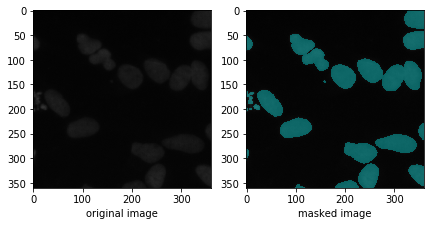

/home/biswajit/Documents/bima/unet/data/train/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0/images/98a463483fe3a56deacc8bc00ab8aa62668bd40ad0c70bbe7deb10d3e4aeb0c0.png


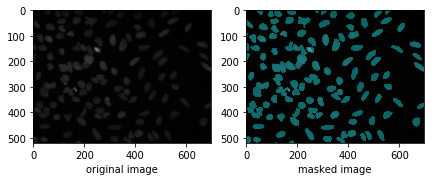

/home/biswajit/Documents/bima/unet/data/train/06c779330d6d3447be21df2b9f05d1088f5b3b50dc48724fc130b1fd2896a68c/images/06c779330d6d3447be21df2b9f05d1088f5b3b50dc48724fc130b1fd2896a68c.png


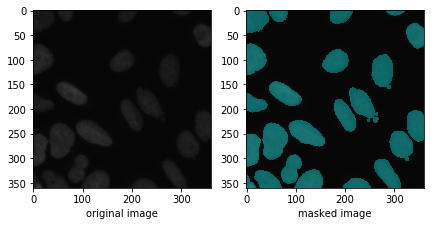

/home/biswajit/Documents/bima/unet/data/train/b3b1626f8ad156acb2963d1faa6a368f9378a266c3b90d9321087fdc5b3032b4/images/b3b1626f8ad156acb2963d1faa6a368f9378a266c3b90d9321087fdc5b3032b4.png


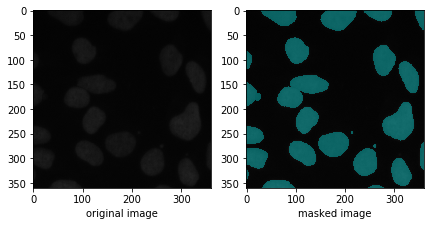

/home/biswajit/Documents/bima/unet/data/train/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2/images/e52960d31f8bddf85400259beb4521383f5ceface1080be3429f2f926cc9b5c2.png


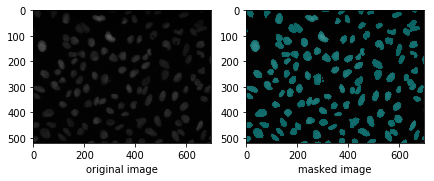

/home/biswajit/Documents/bima/unet/data/train/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450/images/76a372bfd3fad3ea30cb163b560e52607a8281f5b042484c3a0fc6d0aa5a7450.png


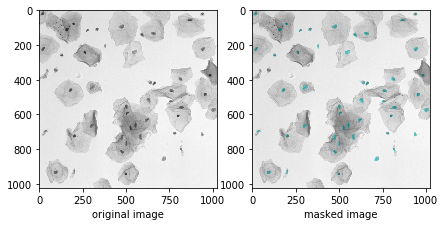

/home/biswajit/Documents/bima/unet/data/train/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731/images/a90cad45551d62c5cfa89517df8eb5e8f2f87f1a6e6678e606907afcbad91731.png


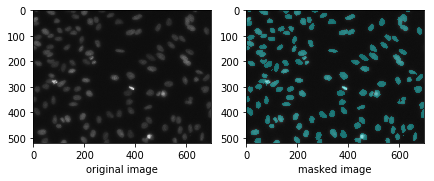

/home/biswajit/Documents/bima/unet/data/train/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e/images/9bb6e39d5f4415bc7554842ee5d1280403a602f2ba56122b87f453a62d37c06e.png


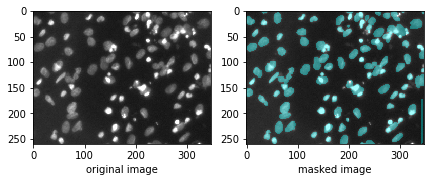

/home/biswajit/Documents/bima/unet/data/train/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c/images/80632d6be60c8462e50d51bcf5caf15308931603095d6b5e772a115cd0d0470c.png


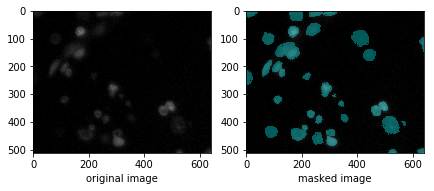

/home/biswajit/Documents/bima/unet/data/train/d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28/images/d35f25c8e3f7fca5232fc4d5e3faf14b025b20b3731af77fe971a5e2e9d69d28.png


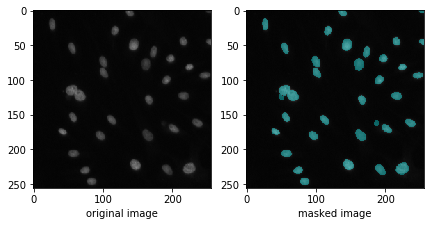

/home/biswajit/Documents/bima/unet/data/train/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0/images/3ebd2ab34ba86e515feb79ffdeb7fc303a074a98ba39949b905dbde3ff4b7ec0.png


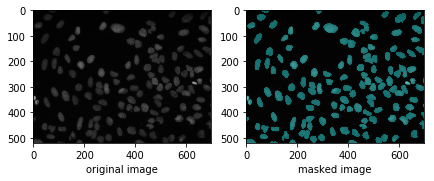

/home/biswajit/Documents/bima/unet/data/train/2cfa857e63be1b418c91ad5ea1f8d136fd1b80fc856e1d4277274c3dea28011c/images/2cfa857e63be1b418c91ad5ea1f8d136fd1b80fc856e1d4277274c3dea28011c.png


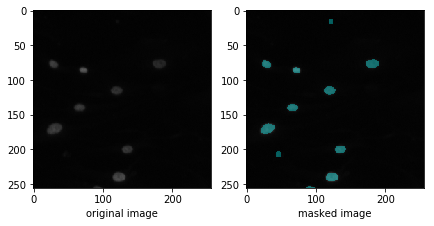

/home/biswajit/Documents/bima/unet/data/train/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d/images/bb8ebf465c968a5f6f715de5d9e2e664afd1bcaa533e0e3352ecea1cc5b6fb0d.png


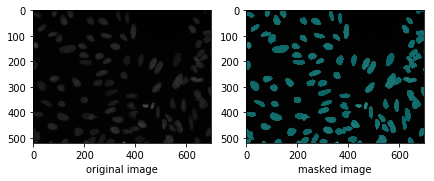

/home/biswajit/Documents/bima/unet/data/train/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83/images/e49fc2b4f1f39d481a6525225ab3f688be5c87f56884456ad54c953315efae83.png


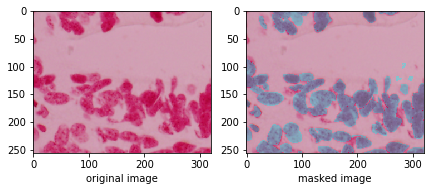

/home/biswajit/Documents/bima/unet/data/train/dae976f161fe42dc58dee87d4bf2eb9f65736597cab0114138641b2a39a5c42b/images/dae976f161fe42dc58dee87d4bf2eb9f65736597cab0114138641b2a39a5c42b.png


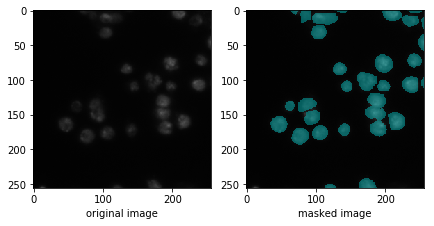

/home/biswajit/Documents/bima/unet/data/train/4193474b2f1c72f735b13633b219d9cabdd43c21d9c2bb4dfc4809f104ba4c06/images/4193474b2f1c72f735b13633b219d9cabdd43c21d9c2bb4dfc4809f104ba4c06.png


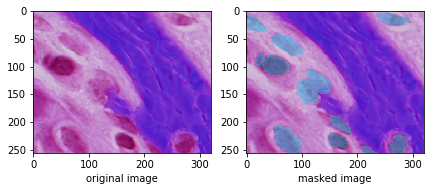

/home/biswajit/Documents/bima/unet/data/train/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844/images/da5f98f2b8a64eee735a398de48ed42cd31bf17a6063db46a9e0783ac13cd844.png


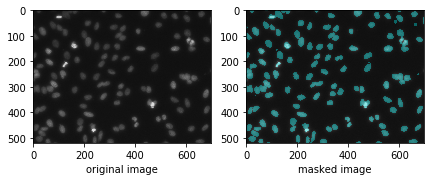

/home/biswajit/Documents/bima/unet/data/train/0bf33d3db4282d918ec3da7112d0bf0427d4eafe74b3ee0bb419770eefe8d7d6/images/0bf33d3db4282d918ec3da7112d0bf0427d4eafe74b3ee0bb419770eefe8d7d6.png


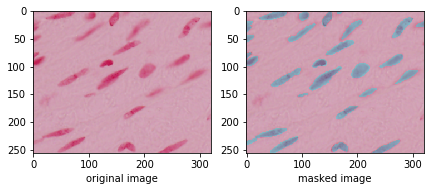

/home/biswajit/Documents/bima/unet/data/train/7773ac91af61ed041701b7c3b649598e3707cf04c0577f464fd31be687f538fe/images/7773ac91af61ed041701b7c3b649598e3707cf04c0577f464fd31be687f538fe.png


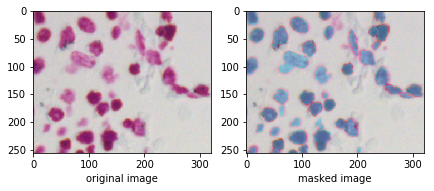

/home/biswajit/Documents/bima/unet/data/train/6034456567632f4b48dc3dfbb98534b5953c151990f4235df6c912c0a9c08397/images/6034456567632f4b48dc3dfbb98534b5953c151990f4235df6c912c0a9c08397.png


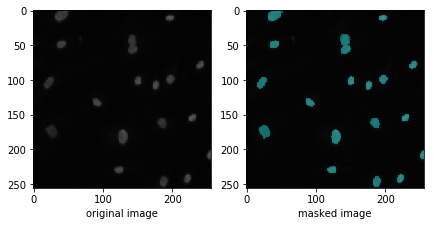

/home/biswajit/Documents/bima/unet/data/train/87ea72894f6534b28e740cc34cf5c9eb75d0d8902687fce5fcc08a92e9f41386/images/87ea72894f6534b28e740cc34cf5c9eb75d0d8902687fce5fcc08a92e9f41386.png


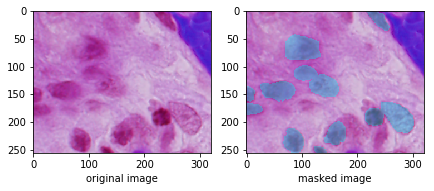

/home/biswajit/Documents/bima/unet/data/train/6b0ac2ab04c09dced54058ec504a4947f8ecd5727dfca7e0b3f69de71d0d31c7/images/6b0ac2ab04c09dced54058ec504a4947f8ecd5727dfca7e0b3f69de71d0d31c7.png


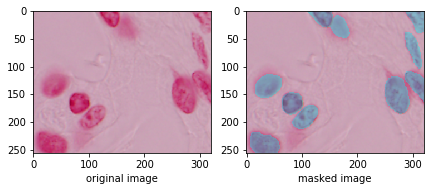

/home/biswajit/Documents/bima/unet/data/train/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12/images/54793624413c7d0e048173f7aeee85de3277f7e8d47c82e0a854fe43e879cd12.png


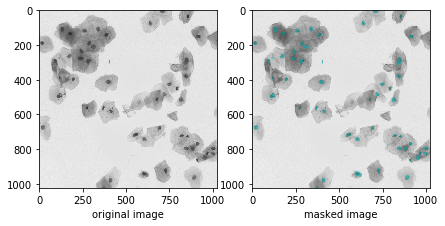

/home/biswajit/Documents/bima/unet/data/train/9bf9f3dcadeb152a9a26b23e2fb199dcf9b2b17660b1646326f5b10cbf51eaee/images/9bf9f3dcadeb152a9a26b23e2fb199dcf9b2b17660b1646326f5b10cbf51eaee.png


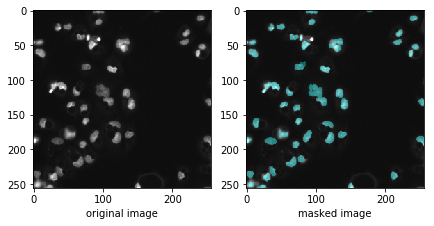

/home/biswajit/Documents/bima/unet/data/train/d1ba6089cae2f90cb7275ece10ca393c25f60ea17e5c9c3cea2399d31fd41869/images/d1ba6089cae2f90cb7275ece10ca393c25f60ea17e5c9c3cea2399d31fd41869.png


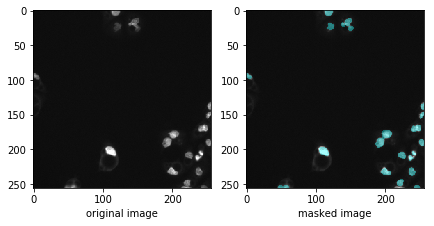

/home/biswajit/Documents/bima/unet/data/train/6bc8cda54f5b66a2a27d962ac219f8075bf7cc43b87ba0c9e776404370429e80/images/6bc8cda54f5b66a2a27d962ac219f8075bf7cc43b87ba0c9e776404370429e80.png


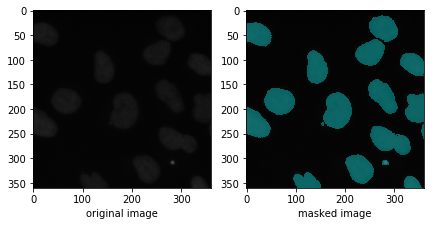

/home/biswajit/Documents/bima/unet/data/train/0532c64c2fd0c4d3188cc751cdfd566b1cfba3d269358717295bab1504c7c275/images/0532c64c2fd0c4d3188cc751cdfd566b1cfba3d269358717295bab1504c7c275.png


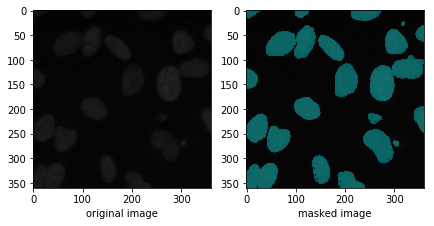

/home/biswajit/Documents/bima/unet/data/train/237802ac5005f9cf782367156c46c383efd9e05088e5768ca883cbbe24abadb1/images/237802ac5005f9cf782367156c46c383efd9e05088e5768ca883cbbe24abadb1.png


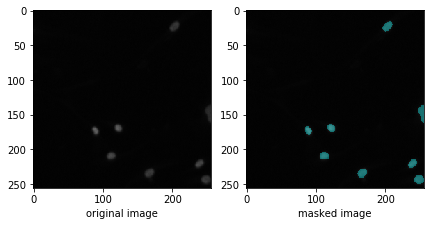

/home/biswajit/Documents/bima/unet/data/train/3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff/images/3852c7e45bd885b9537e276861ab50b99bb42f0f8e717d2f88174c62862ca3ff.png


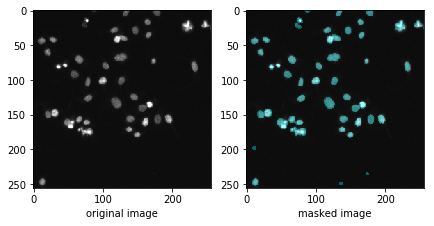

/home/biswajit/Documents/bima/unet/data/train/d7ec8003735996458b56ccb8ae34d080eb2a6adabef931323239632515b4b220/images/d7ec8003735996458b56ccb8ae34d080eb2a6adabef931323239632515b4b220.png


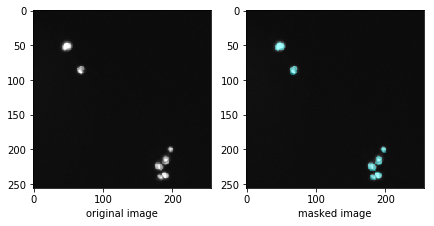

/home/biswajit/Documents/bima/unet/data/train/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464/images/4e1c889de3764694d0dea41e5682fedb265eaf2cdbe72ff6c1f518747d709464.png


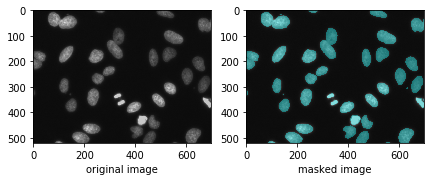

/home/biswajit/Documents/bima/unet/data/train/6bd18a218d25247dc456aed124c066a6397fb93086e860e4d04014bfa9c9555d/images/6bd18a218d25247dc456aed124c066a6397fb93086e860e4d04014bfa9c9555d.png


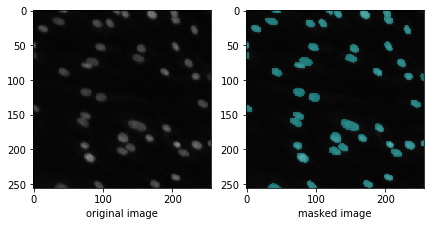

/home/biswajit/Documents/bima/unet/data/train/317832f90f02c5e916b2ac0f3bcb8da9928d8e400b747b2c68e544e56adacf6b/images/317832f90f02c5e916b2ac0f3bcb8da9928d8e400b747b2c68e544e56adacf6b.png


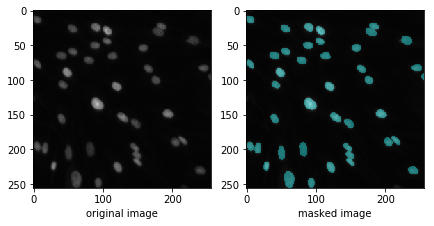

/home/biswajit/Documents/bima/unet/data/train/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622/images/6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbacd3acdc9de830ee5622.png


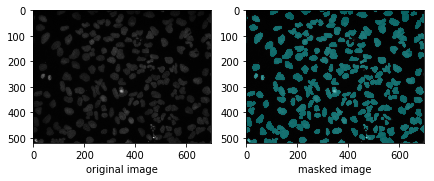

/home/biswajit/Documents/bima/unet/data/train/c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06/images/c3bec1066aae20f48b82975e7e8b684cd67635a8baf211e4d9e3e13bc54c5d06.png


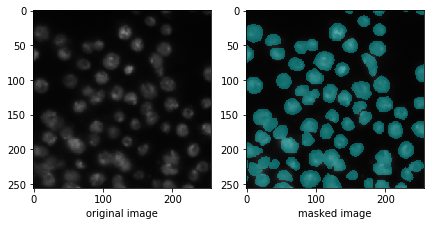

/home/biswajit/Documents/bima/unet/data/train/7978812d0e2e034ee1f9c141f019705582fcaa290e4a01c6c75a62753285cb23/images/7978812d0e2e034ee1f9c141f019705582fcaa290e4a01c6c75a62753285cb23.png


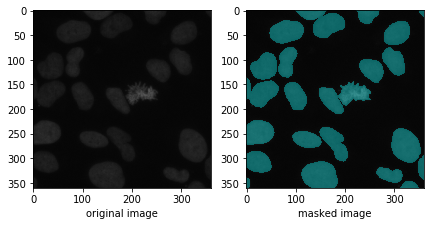

/home/biswajit/Documents/bima/unet/data/train/b8fdc02d915206bb2564e1f7da962f2b9d9d491b11afa00a76622b7932366480/images/b8fdc02d915206bb2564e1f7da962f2b9d9d491b11afa00a76622b7932366480.png


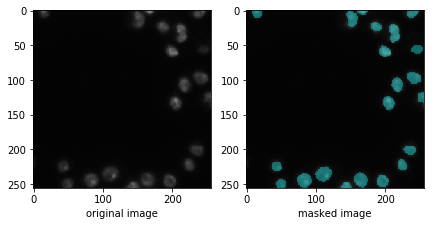

/home/biswajit/Documents/bima/unet/data/train/fc5452f612a0f972fe55cc677055ede662af6723b5c1615ad539b8a4bd279bdb/images/fc5452f612a0f972fe55cc677055ede662af6723b5c1615ad539b8a4bd279bdb.png


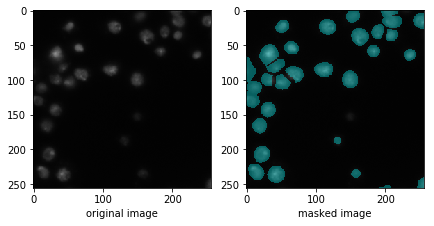

/home/biswajit/Documents/bima/unet/data/train/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de/images/fc22db33a2495f58f118bc182c0087e140df14ccb8dad51373e1a54381f683de.png


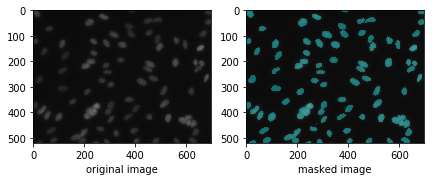

/home/biswajit/Documents/bima/unet/data/train/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1/images/a5e695fce80dc03efb6665a9ec14500ab47f4ee9f6437531388dd3cc32c90db1.png


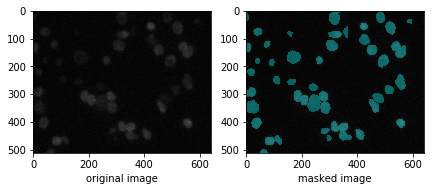

/home/biswajit/Documents/bima/unet/data/train/e5aeb5b3577abbebe8982b5dd7d22c4257250ad3000661a42f38bf9248d291fd/images/e5aeb5b3577abbebe8982b5dd7d22c4257250ad3000661a42f38bf9248d291fd.png


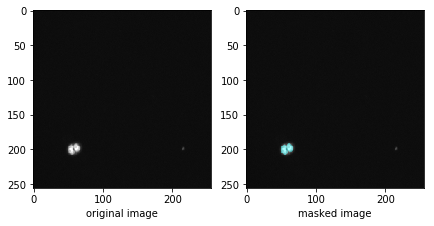

/home/biswajit/Documents/bima/unet/data/train/d256b32adda37f2301c9e46f34b7f9a36cce273256369ceb5dc2c73c3007e3c4/images/d256b32adda37f2301c9e46f34b7f9a36cce273256369ceb5dc2c73c3007e3c4.png


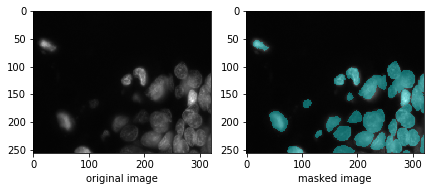

/home/biswajit/Documents/bima/unet/data/train/c6216cdc42f61bc345434986db42e2ef9b9741aee3210b7a808e952e319d2305/images/c6216cdc42f61bc345434986db42e2ef9b9741aee3210b7a808e952e319d2305.png


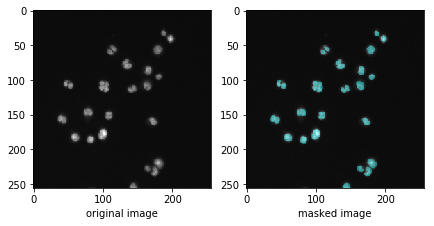

/home/biswajit/Documents/bima/unet/data/train/2c61fdcb36fd1b2944895af6204279e9f6c164ba894198b40c8b7a3c9bf500ea/images/2c61fdcb36fd1b2944895af6204279e9f6c164ba894198b40c8b7a3c9bf500ea.png


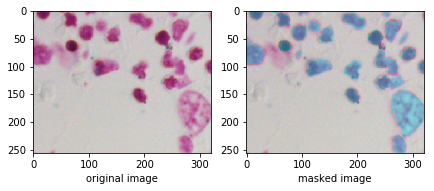

/home/biswajit/Documents/bima/unet/data/train/30311520606ec99b6a810ae1a9a753df991777d374212423bb075c408a98ed74/images/30311520606ec99b6a810ae1a9a753df991777d374212423bb075c408a98ed74.png


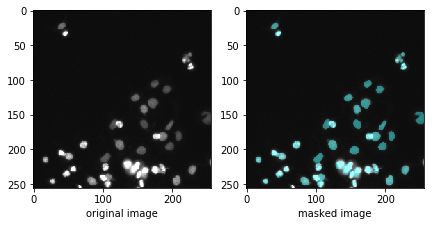

/home/biswajit/Documents/bima/unet/data/train/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169/images/ecb36c90cdd20245d89173c106f3c6a2d124d07bdea0ae202fb1efa49b0cd169.png


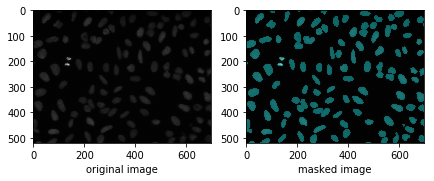

/home/biswajit/Documents/bima/unet/data/train/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1/images/6b61ab2e3ff0e2c7a55fd71e290b51e142555cf82bc7574fc27326735e8acbd1.png


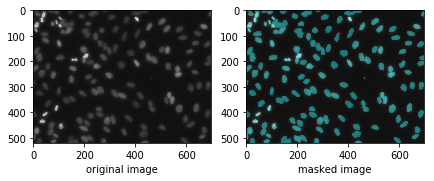

/home/biswajit/Documents/bima/unet/data/train/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317/images/7f2b154541166210f468d89bb0a7184f10e51168a181dbb8b686c14654ffa317.png


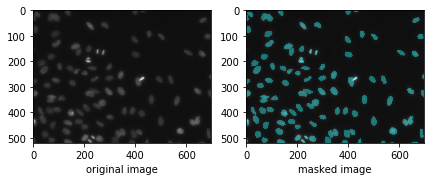

/home/biswajit/Documents/bima/unet/data/train/1b6044e4858a9b7cee9b0028d8e54fbc8fb72e6c4424ab5b9f3859bfc72b33c5/images/1b6044e4858a9b7cee9b0028d8e54fbc8fb72e6c4424ab5b9f3859bfc72b33c5.png


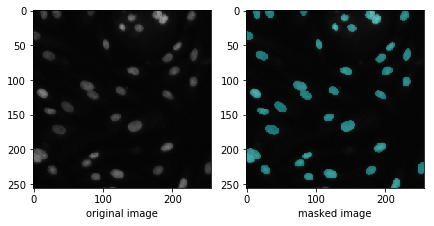

In [5]:
for img_p, msk_p in image_onemask_paths:
    print(img_p)
    plots.show_img_msk_frompath(img_p, msk_p)

In [6]:
img, msk = [utils.open_image(item) for item in image_onemask_paths[0]]

Check: if a gray image is stored in RBG format then all the arrays corresponding to the 3 channels are similar

In [7]:
assert all([b==g==r for b,g,r in msk.reshape(-1,3)])

### Type of images:
1. black background white foreground
2. cyan background purple foreground
3. grey background with ghost cells with small black nuclei as foreground
4. pink background purple foreground
5. some images have overlapping nuclei
6. white background purple foreground
7. some images are zoomed images in purple-white background with darker purple foreground

Lets look at test images

In [8]:
image_onemask_paths_test = utils.get_image_onemask_paths(TEST_DIR, onemask=False)

/home/biswajit/Documents/bima/unet/data/test/31f1fbe85b8899258ea5bcf5f93f7ac8238660c386aeab40649c715bd2e38a0a/images/31f1fbe85b8899258ea5bcf5f93f7ac8238660c386aeab40649c715bd2e38a0a.png


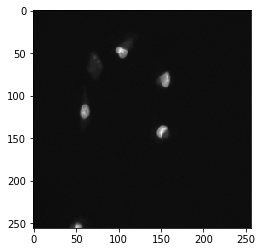

/home/biswajit/Documents/bima/unet/data/test/1ef68e93964c2d9230100c1347c328f6385a7bc027879dc3d4c055e6fe80cb3c/images/1ef68e93964c2d9230100c1347c328f6385a7bc027879dc3d4c055e6fe80cb3c.png


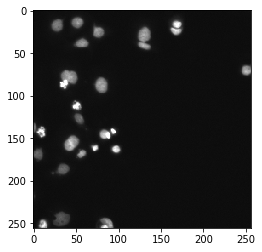

/home/biswajit/Documents/bima/unet/data/test/eea70a7948d25a9a791dbcb39228af4ea4049fe5ebdee9c04884be8cca3da835/images/eea70a7948d25a9a791dbcb39228af4ea4049fe5ebdee9c04884be8cca3da835.png


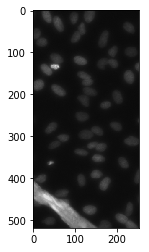

/home/biswajit/Documents/bima/unet/data/test/0f1f896d9ae5a04752d3239c690402c022db4d72c0d2c087d73380896f72c466/images/0f1f896d9ae5a04752d3239c690402c022db4d72c0d2c087d73380896f72c466.png


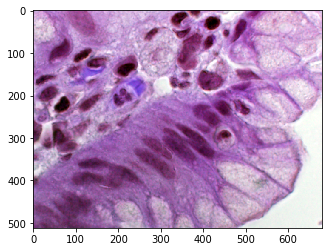

/home/biswajit/Documents/bima/unet/data/test/17b9bf4356db24967c4677b8376ac38f826de73a88b93a8d73a8b452e399cdff/images/17b9bf4356db24967c4677b8376ac38f826de73a88b93a8d73a8b452e399cdff.png


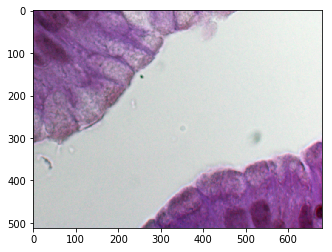

/home/biswajit/Documents/bima/unet/data/test/f0d0ab13ff53adc3c4d57e95a5f83d80b06f2cbc0bf002b52cf7b496612e0ce4/images/f0d0ab13ff53adc3c4d57e95a5f83d80b06f2cbc0bf002b52cf7b496612e0ce4.png


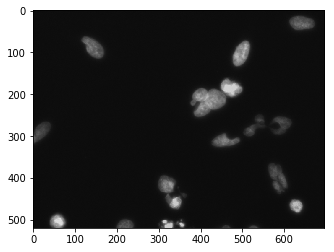

/home/biswajit/Documents/bima/unet/data/test/648c8ffa496e1716017906d0bf135debfc93386ae86aa3d4adbda9a505985fd9/images/648c8ffa496e1716017906d0bf135debfc93386ae86aa3d4adbda9a505985fd9.png


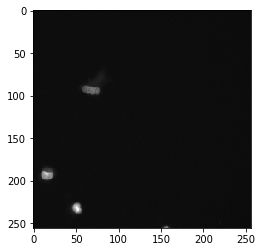

/home/biswajit/Documents/bima/unet/data/test/fac507fa4d1649e8b24c195d990f1fc3ca3633d917839e1751a9d412a14ab5e3/images/fac507fa4d1649e8b24c195d990f1fc3ca3633d917839e1751a9d412a14ab5e3.png


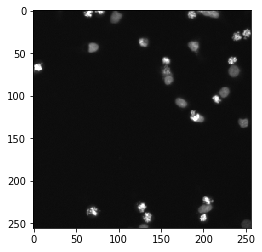

/home/biswajit/Documents/bima/unet/data/test/b83d1d77935b6cfd44105b54600ffc4b6bd82de57dec65571bcb117fa8398ba3/images/b83d1d77935b6cfd44105b54600ffc4b6bd82de57dec65571bcb117fa8398ba3.png


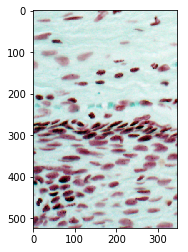

/home/biswajit/Documents/bima/unet/data/test/336d3e4105766f8ad328a7ee9571e743f376f8cbcf6a969ca7e353fe3235c523/images/336d3e4105766f8ad328a7ee9571e743f376f8cbcf6a969ca7e353fe3235c523.png


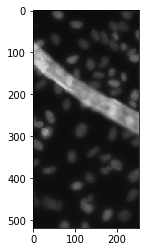

/home/biswajit/Documents/bima/unet/data/test/4727d94c6a57ed484270fdd8bbc6e3d5f2f15d5476794a4e37a40f2309a091e2/images/4727d94c6a57ed484270fdd8bbc6e3d5f2f15d5476794a4e37a40f2309a091e2.png


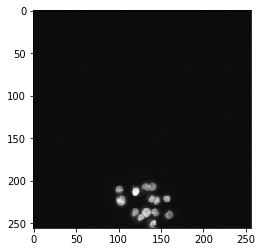

/home/biswajit/Documents/bima/unet/data/test/550450e4bff4036fd671decdc5d42fec23578198d6a2fd79179c4368b9d6da18/images/550450e4bff4036fd671decdc5d42fec23578198d6a2fd79179c4368b9d6da18.png


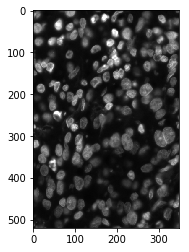

/home/biswajit/Documents/bima/unet/data/test/e17b7aedd251a016c01ef9158e6e4aa940d9f1b35942d86028dc1222192a9258/images/e17b7aedd251a016c01ef9158e6e4aa940d9f1b35942d86028dc1222192a9258.png


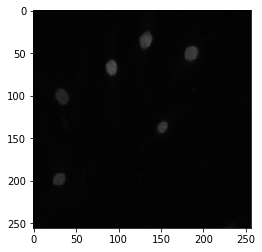

/home/biswajit/Documents/bima/unet/data/test/9ab2d381f90b485a68b82bc07f94397a0373e3215ad20935a958738e55f3cfc2/images/9ab2d381f90b485a68b82bc07f94397a0373e3215ad20935a958738e55f3cfc2.png


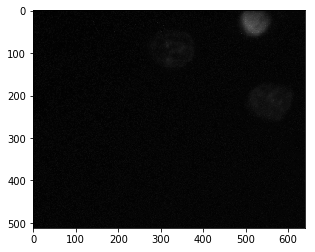

/home/biswajit/Documents/bima/unet/data/test/53df5150ee56253fe5bc91a9230d377bb21f1300f443ba45a758bcb01a15c0e4/images/53df5150ee56253fe5bc91a9230d377bb21f1300f443ba45a758bcb01a15c0e4.png


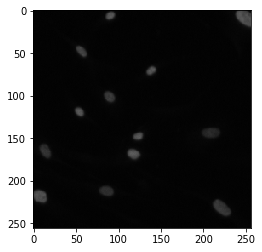

/home/biswajit/Documents/bima/unet/data/test/7f4cbe0b36b5d09466476a7d4e01f4f976c67872d549f4ff47b3e1e3a2b403af/images/7f4cbe0b36b5d09466476a7d4e01f4f976c67872d549f4ff47b3e1e3a2b403af.png


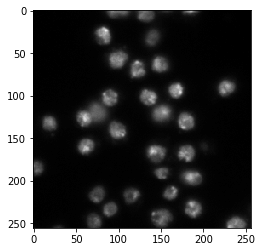

/home/biswajit/Documents/bima/unet/data/test/fe9adb627a6f45747c5a8223b671774791ededf9364f6544be487c540107fa4f/images/fe9adb627a6f45747c5a8223b671774791ededf9364f6544be487c540107fa4f.png


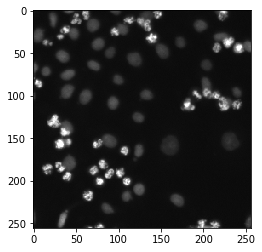

/home/biswajit/Documents/bima/unet/data/test/0999dab07b11bc85fb8464fc36c947fbd8b5d6ec49817361cb780659ca805eac/images/0999dab07b11bc85fb8464fc36c947fbd8b5d6ec49817361cb780659ca805eac.png


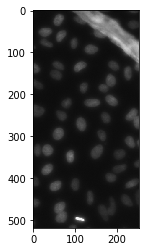

/home/biswajit/Documents/bima/unet/data/test/0a849e0eb15faa8a6d7329c3dd66aabe9a294cccb52ed30a90c8ca99092ae732/images/0a849e0eb15faa8a6d7329c3dd66aabe9a294cccb52ed30a90c8ca99092ae732.png


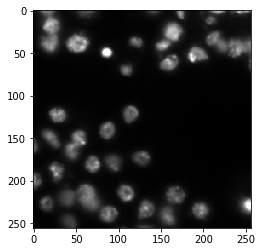

/home/biswajit/Documents/bima/unet/data/test/52b267e20519174e3ce1e1994b5d677804b16bc670aa5f6ffb6344a0fdf63fde/images/52b267e20519174e3ce1e1994b5d677804b16bc670aa5f6ffb6344a0fdf63fde.png


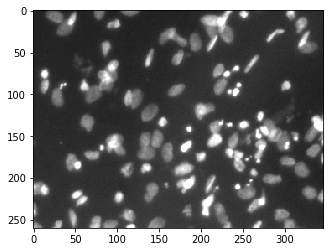

/home/biswajit/Documents/bima/unet/data/test/43a71aeb641faa18742cb826772a8566c6c947d7050f9ab15459de6cc2b3b6af/images/43a71aeb641faa18742cb826772a8566c6c947d7050f9ab15459de6cc2b3b6af.png


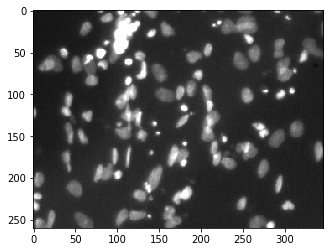

/home/biswajit/Documents/bima/unet/data/test/4be73d68f433869188fe5e7f09c7f681ed51003da6aa5d19ce368726d8e271ee/images/4be73d68f433869188fe5e7f09c7f681ed51003da6aa5d19ce368726d8e271ee.png


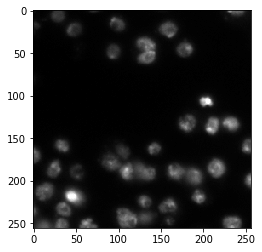

/home/biswajit/Documents/bima/unet/data/test/9f17aea854db13015d19b34cb2022cfdeda44133323fcd6bb3545f7b9404d8ab/images/9f17aea854db13015d19b34cb2022cfdeda44133323fcd6bb3545f7b9404d8ab.png


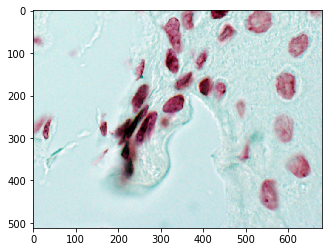

/home/biswajit/Documents/bima/unet/data/test/d6eb7ce7723e2f6dc13b90b41a29ded27dbd815bad633fdf582447c686018896/images/d6eb7ce7723e2f6dc13b90b41a29ded27dbd815bad633fdf582447c686018896.png


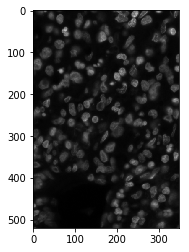

/home/biswajit/Documents/bima/unet/data/test/1747f62148a919c8feb6d607faeebdf504b5e2ad42b6b1710b1189c37ebcdb2c/images/1747f62148a919c8feb6d607faeebdf504b5e2ad42b6b1710b1189c37ebcdb2c.png


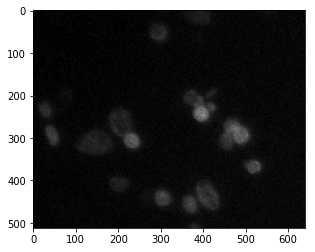

/home/biswajit/Documents/bima/unet/data/test/259b35151d4a7a5ffdd7ab7f171b142db8cfe40beeee67277fac6adca4d042c4/images/259b35151d4a7a5ffdd7ab7f171b142db8cfe40beeee67277fac6adca4d042c4.png


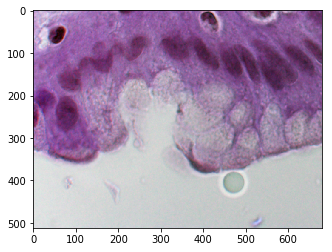

/home/biswajit/Documents/bima/unet/data/test/51c70bb8a299943b27f8b354571272692d8f2705036a1a9562156c76da5f025b/images/51c70bb8a299943b27f8b354571272692d8f2705036a1a9562156c76da5f025b.png


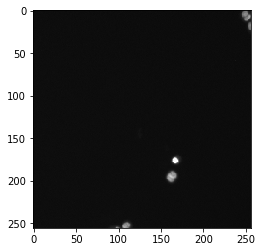

/home/biswajit/Documents/bima/unet/data/test/ade080c6618cbbb0a25680cf847f312b5e19b22bfe1cafec0436987ebe5b1e7e/images/ade080c6618cbbb0a25680cf847f312b5e19b22bfe1cafec0436987ebe5b1e7e.png


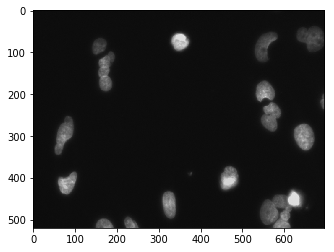

/home/biswajit/Documents/bima/unet/data/test/519dc0d672d1c295fc69b629af8721ccb1a1f136d1976685a68487e62547ffe0/images/519dc0d672d1c295fc69b629af8721ccb1a1f136d1976685a68487e62547ffe0.png


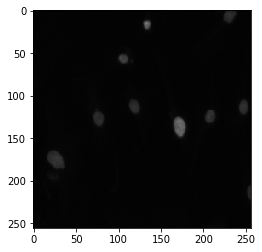

/home/biswajit/Documents/bima/unet/data/test/472b1c5ff988dadc209faea92499bc07f305208dbda29d16262b3d543ac91c71/images/472b1c5ff988dadc209faea92499bc07f305208dbda29d16262b3d543ac91c71.png


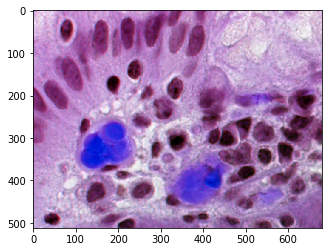

/home/biswajit/Documents/bima/unet/data/test/d616d323a9eeb9da1b66f8d5df671d63c092c9919cb2c0b223e29c63257c944d/images/d616d323a9eeb9da1b66f8d5df671d63c092c9919cb2c0b223e29c63257c944d.png


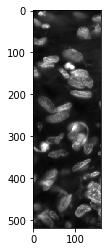

/home/biswajit/Documents/bima/unet/data/test/1962d0c5faf3e85cda80e0578e0cb7aca50826d781620e5c1c4cc586bc69f81a/images/1962d0c5faf3e85cda80e0578e0cb7aca50826d781620e5c1c4cc586bc69f81a.png


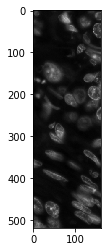

/home/biswajit/Documents/bima/unet/data/test/4f949bd8d914bbfa06f40d6a0e2b5b75c38bf53dbcbafc48c97f105bee4f8fac/images/4f949bd8d914bbfa06f40d6a0e2b5b75c38bf53dbcbafc48c97f105bee4f8fac.png


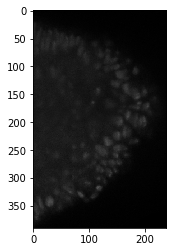

/home/biswajit/Documents/bima/unet/data/test/0e132f71c8b4875c3c2dd7a22997468a3e842b46aa9bd47cf7b0e8b7d63f0925/images/0e132f71c8b4875c3c2dd7a22997468a3e842b46aa9bd47cf7b0e8b7d63f0925.png


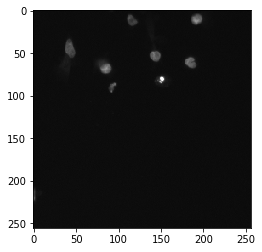

/home/biswajit/Documents/bima/unet/data/test/a984e7fb886aa02e29d112766d3ce26a4f78eac540ce7bbdbd42af2761928f6d/images/a984e7fb886aa02e29d112766d3ce26a4f78eac540ce7bbdbd42af2761928f6d.png


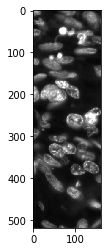

/home/biswajit/Documents/bima/unet/data/test/44afae184c89e6ba55985b4d341acc1ae1e8b6ef96312064e0e6e630e022b078/images/44afae184c89e6ba55985b4d341acc1ae1e8b6ef96312064e0e6e630e022b078.png


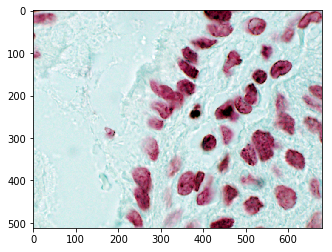

/home/biswajit/Documents/bima/unet/data/test/1879f4f4f05e2bada0ffeb46c128b8df7a79b14c84f38c3e216a69653495153b/images/1879f4f4f05e2bada0ffeb46c128b8df7a79b14c84f38c3e216a69653495153b.png


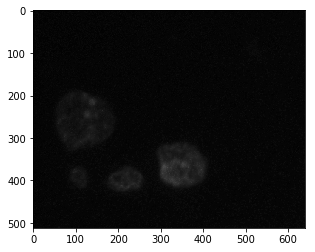

/home/biswajit/Documents/bima/unet/data/test/1cdbfee1951356e7b0a215073828695fe1ead5f8b1add119b6645d2fdc8d844e/images/1cdbfee1951356e7b0a215073828695fe1ead5f8b1add119b6645d2fdc8d844e.png


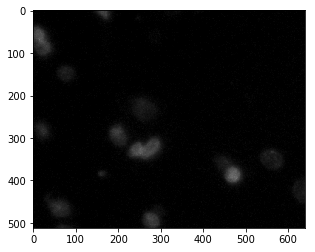

/home/biswajit/Documents/bima/unet/data/test/a4816cc1fb76cb3c5e481186833fc0ae9cf426a1406a2607e974e65e9cddba4f/images/a4816cc1fb76cb3c5e481186833fc0ae9cf426a1406a2607e974e65e9cddba4f.png


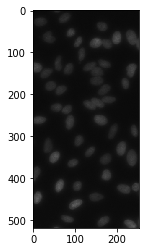

/home/biswajit/Documents/bima/unet/data/test/c8e79ff4ac55f4b772057de28e539727b7f4f2a3de73bf7a082a0ace86d609eb/images/c8e79ff4ac55f4b772057de28e539727b7f4f2a3de73bf7a082a0ace86d609eb.png


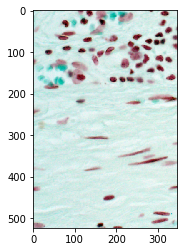

/home/biswajit/Documents/bima/unet/data/test/699f2992cd71e2e28cf45f81347ff22e76b37541ce88087742884cd0e9aadc68/images/699f2992cd71e2e28cf45f81347ff22e76b37541ce88087742884cd0e9aadc68.png


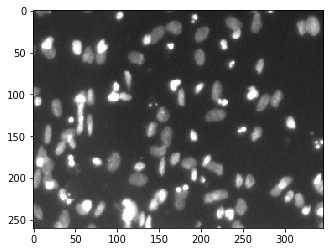

/home/biswajit/Documents/bima/unet/data/test/bdc789019cee8ddfae20d5f769299993b4b330b2d38d1218646cf89e77fbbd4d/images/bdc789019cee8ddfae20d5f769299993b4b330b2d38d1218646cf89e77fbbd4d.png


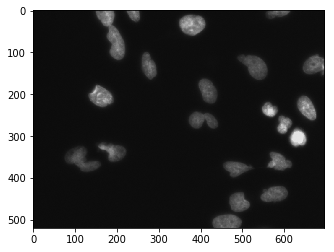

/home/biswajit/Documents/bima/unet/data/test/191b2b2205f2f5cc9da04702c5d422bc249faf8bca1107af792da63cccfba829/images/191b2b2205f2f5cc9da04702c5d422bc249faf8bca1107af792da63cccfba829.png


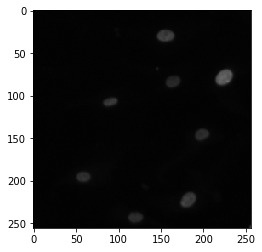

/home/biswajit/Documents/bima/unet/data/test/8b59819fbc92eefe45b1db95c0cc3a467ddcfc755684c7f2ba2f6ccb9ad740ab/images/8b59819fbc92eefe45b1db95c0cc3a467ddcfc755684c7f2ba2f6ccb9ad740ab.png


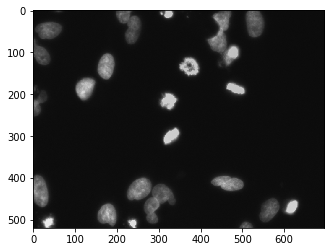

/home/biswajit/Documents/bima/unet/data/test/295682d9eb5acb5c1976a460c085734bfaf38482b0a3f02591c2bfdcd4128549/images/295682d9eb5acb5c1976a460c085734bfaf38482b0a3f02591c2bfdcd4128549.png


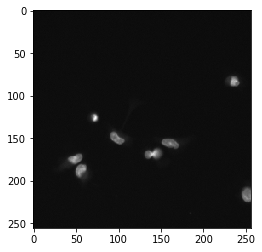

/home/biswajit/Documents/bima/unet/data/test/0ed3555a4bd48046d3b63d8baf03a5aa97e523aa483aaa07459e7afa39fb96c6/images/0ed3555a4bd48046d3b63d8baf03a5aa97e523aa483aaa07459e7afa39fb96c6.png


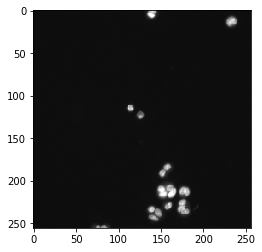

/home/biswajit/Documents/bima/unet/data/test/d8d4bf68a76e4e4c5f21de7ac613451f7115a04db686151e78b8ec0b6a22022b/images/d8d4bf68a76e4e4c5f21de7ac613451f7115a04db686151e78b8ec0b6a22022b.png


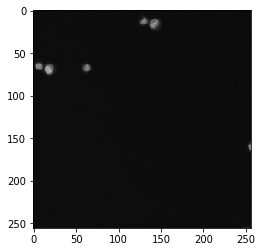

/home/biswajit/Documents/bima/unet/data/test/7bdb668e6127b7eafc837a883f0648002bd063c736f55a4f673e787250a3fb04/images/7bdb668e6127b7eafc837a883f0648002bd063c736f55a4f673e787250a3fb04.png


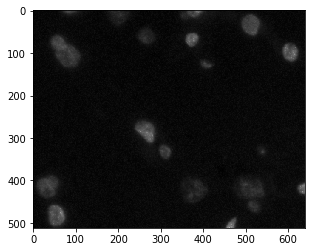

/home/biswajit/Documents/bima/unet/data/test/697a05c6fe4a07c601d46da80885645ad574ea19b47ee795ccff216c9f1f1808/images/697a05c6fe4a07c601d46da80885645ad574ea19b47ee795ccff216c9f1f1808.png


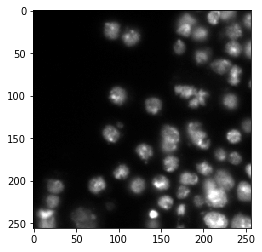

/home/biswajit/Documents/bima/unet/data/test/78a981bd27ba0c65a9169548665a17bda9f49050d0d3893a6567d1eb92cd003d/images/78a981bd27ba0c65a9169548665a17bda9f49050d0d3893a6567d1eb92cd003d.png


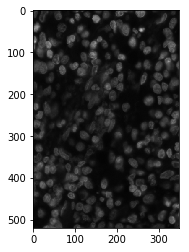

/home/biswajit/Documents/bima/unet/data/test/dab46d798d29aff2e99c23f47ed3064f5cafb1644629b015c95a2dd2ee593bb4/images/dab46d798d29aff2e99c23f47ed3064f5cafb1644629b015c95a2dd2ee593bb4.png


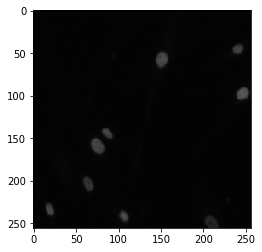

/home/biswajit/Documents/bima/unet/data/test/da6c593410340b19bb212b9f6d274f95b08c0fc8f2570cd66bc5ed42c560acab/images/da6c593410340b19bb212b9f6d274f95b08c0fc8f2570cd66bc5ed42c560acab.png


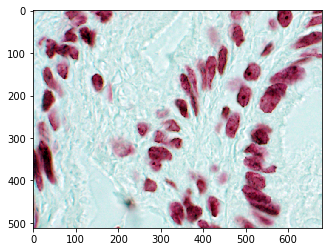

/home/biswajit/Documents/bima/unet/data/test/3c4c675825f7509877bc10497f498c9a2e3433bf922bd870914a2eb21a54fd26/images/3c4c675825f7509877bc10497f498c9a2e3433bf922bd870914a2eb21a54fd26.png


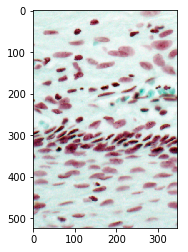

/home/biswajit/Documents/bima/unet/data/test/505bc0a3928d8aef5ce441c5a611fdd32e1e8eccdc15cc3a52b88030acb50f81/images/505bc0a3928d8aef5ce441c5a611fdd32e1e8eccdc15cc3a52b88030acb50f81.png


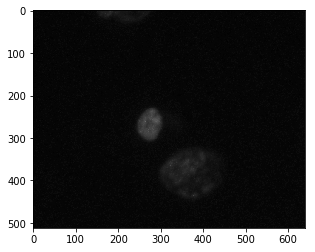

/home/biswajit/Documents/bima/unet/data/test/df40099c6306ca1f47fcc8a62e2fa39486d4e223177afdc51b2ad189691802d8/images/df40099c6306ca1f47fcc8a62e2fa39486d4e223177afdc51b2ad189691802d8.png


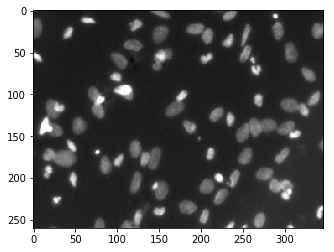

/home/biswajit/Documents/bima/unet/data/test/912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea7e460241a23535a406/images/912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea7e460241a23535a406.png


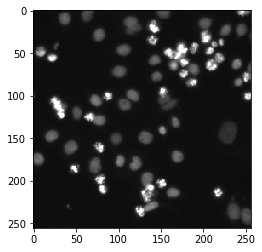

/home/biswajit/Documents/bima/unet/data/test/38f5cfb55fc8b048e82a5c895b25fefae7a70c71ab9990c535d1030637bf6a1f/images/38f5cfb55fc8b048e82a5c895b25fefae7a70c71ab9990c535d1030637bf6a1f.png


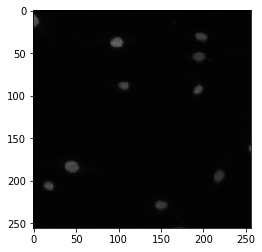

/home/biswajit/Documents/bima/unet/data/test/8922a6ac8fd0258ec27738ca101867169b20d90a60fc84f93df77acd5bf7c80b/images/8922a6ac8fd0258ec27738ca101867169b20d90a60fc84f93df77acd5bf7c80b.png


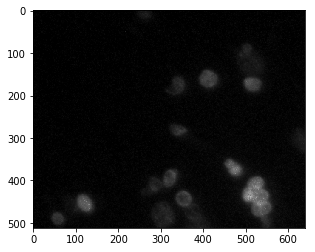

/home/biswajit/Documents/bima/unet/data/test/5cee644e5ffbef1ba021c7f389b33bafd3b1841f04d3edd7922d5084c2c4e0c7/images/5cee644e5ffbef1ba021c7f389b33bafd3b1841f04d3edd7922d5084c2c4e0c7.png


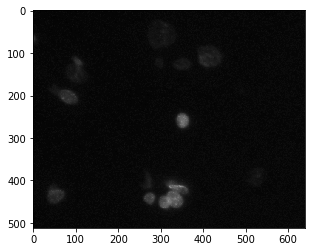

/home/biswajit/Documents/bima/unet/data/test/0114f484a16c152baa2d82fdd43740880a762c93f436c8988ac461c5c9dbe7d5/images/0114f484a16c152baa2d82fdd43740880a762c93f436c8988ac461c5c9dbe7d5.png


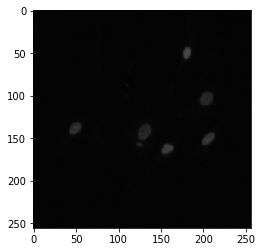

/home/biswajit/Documents/bima/unet/data/test/ab298b962a63e4be9582513aaa84a5e270adba5fd2b16a50e59540524f63c3b8/images/ab298b962a63e4be9582513aaa84a5e270adba5fd2b16a50e59540524f63c3b8.png


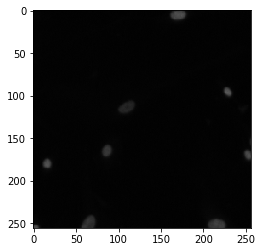

/home/biswajit/Documents/bima/unet/data/test/432f367a4c5b5674de2e2977744d10289a064e5704b21af6607b4975be47c580/images/432f367a4c5b5674de2e2977744d10289a064e5704b21af6607b4975be47c580.png


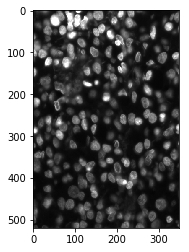

/home/biswajit/Documents/bima/unet/data/test/1d9eacb3161f1e2b45550389ecf7c535c7199c6b44b1c6a46303f7b965e508f1/images/1d9eacb3161f1e2b45550389ecf7c535c7199c6b44b1c6a46303f7b965e508f1.png


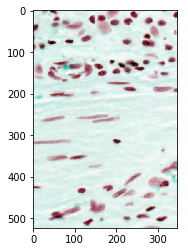

/home/biswajit/Documents/bima/unet/data/test/f5effed21f671bbf4551ecebb7fe95f3be1cf09c16a60afe64d2f0b95be9d1eb/images/f5effed21f671bbf4551ecebb7fe95f3be1cf09c16a60afe64d2f0b95be9d1eb.png


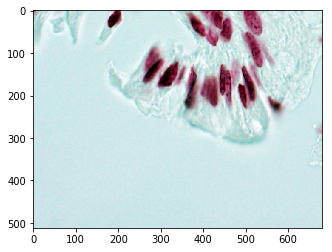

/home/biswajit/Documents/bima/unet/data/test/ca20076870e8fb604e61802605a9ac45419c82dd3e23404c56c4869f9502a5ef/images/ca20076870e8fb604e61802605a9ac45419c82dd3e23404c56c4869f9502a5ef.png


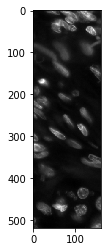

In [9]:
for img_p in image_onemask_paths_test:
    print(img_p)
    plots.show_img_msk_frompath(img_p)

Some tests images have cyan background and white nuclei in the foreground. These type of examples are not seen in train set

### Image sizes of train and test images

In [10]:
from collections import defaultdict

train_image_size_dict = defaultdict(int)

tr_image_dirs, tr_masks, tr_image_ids = utils.image_mask_paths(TRAIN_DIR)

for item in tr_image_dirs:
    img = utils.read3D(item)
    train_image_size_dict[(img.shape[0], img.shape[1])] += 1

In [11]:
train_image_size_dict

defaultdict(int,
            {(256, 256): 334,
             (256, 320): 112,
             (360, 360): 91,
             (260, 347): 5,
             (520, 696): 92,
             (1024, 1024): 16,
             (512, 640): 13,
             (603, 1272): 6,
             (1040, 1388): 1})

In [12]:
test_image_size_dict = defaultdict(int)

tr_image_dirs, tr_masks, tr_image_ids = utils.image_mask_paths(TEST_DIR)

for item in tr_image_dirs:
    img = utils.read3D(item)
    test_image_size_dict[(img.shape[0], img.shape[1])] += 1

In [13]:
test_image_size_dict

defaultdict(int,
            {(256, 256): 24,
             (519, 253): 4,
             (512, 680): 8,
             (512, 640): 8,
             (519, 162): 2,
             (524, 348): 4,
             (520, 348): 4,
             (260, 347): 4,
             (390, 239): 1,
             (520, 696): 4,
             (519, 161): 2})

### Applying transforms

In [14]:
image_p, mask_p = ("/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/images/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c.png",
                   "/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/one_mask.png")

In [15]:
def transform_and_plot(image_p, mask_p, transformation, *args):
    image = cv2.imread(image_p, cv2.IMREAD_COLOR)
    mask = cv2.imread(mask_p, cv2.IMREAD_COLOR)
    image, mask = transformation(image, mask, *args)
    fig=plt.figure(figsize=(7, 7))
    fig.add_subplot(1, 2, 1)
    plt.imshow(image)
    fig.add_subplot(1, 2, 2)
    plt.imshow(mask)
    plt.show()
    plt.close()

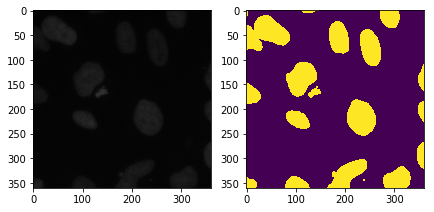

In [16]:
image = cv2.imread(image_p, cv2.IMREAD_COLOR)
mask = cv2.imread(mask_p, cv2.IMREAD_GRAYSCALE)
fig=plt.figure(figsize=(7, 7))
fig.add_subplot(1, 2, 1)
plt.imshow(image)
fig.add_subplot(1, 2, 2)
plt.imshow(mask)
plt.show()
plt.close()

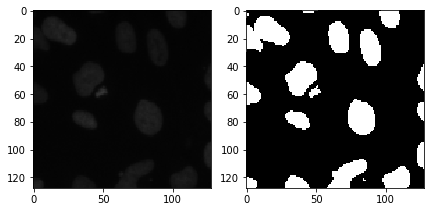

In [17]:
transform_and_plot(image_p, mask_p, transforms.fix_resize_transform2, 128, 128)

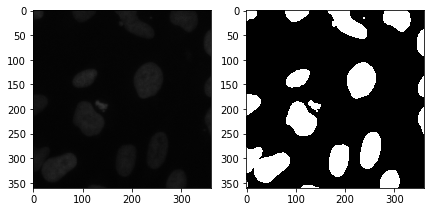

In [18]:
transform_and_plot(image_p, mask_p, transforms.random_horizontal_flip_transform2, 1.0)

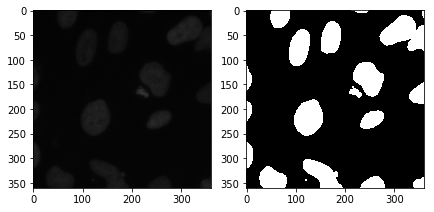

In [19]:
transform_and_plot(image_p, mask_p, transforms.random_vertical_flip_transform2, 1.0)

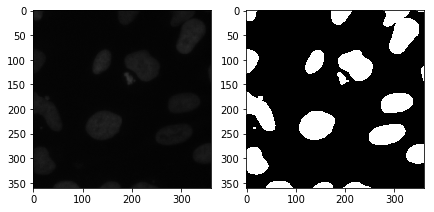

In [20]:
transform_and_plot(image_p, mask_p, transforms.random_rotate_transform2, 1.0)

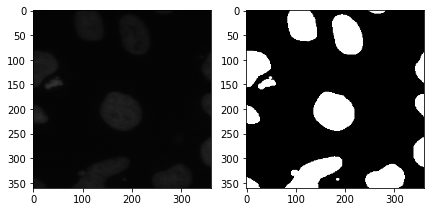

In [21]:
transform_and_plot(image_p, mask_p, transforms.random_crop_transform2, 1.0)

In [22]:
def multiclass_mask(msk_p):    
    mask = utils.open_image(mask_p)
    assert all([g==r==b for g,b,r in mask.reshape(-1,3)])

    gray = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY)

    (t, binary) = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)

    (_, contours, _) = cv2.findContours(binary.astype(np.uint8), 
                               cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)

    contoured_mask = cv2.drawContours(mask, contours, -1, (0, 255, 0), 2)

    # contoured_mask and mask are equivalent to each other
    (contoured_mask == mask).all()
    
    # red and green but blue channels of mask array are equivalent
    assert not all([g==r!=b for g,b,r in mask.reshape(-1,3)])

    # generate 1 channel target array 0: background, 1: inside, 2: contour 
    out = np.clip(np.max(contoured_mask, 2), 0, 2)
    return out

In [23]:
import random
def foo(mask_p):
    #dummy_msk = "/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/masks/"
    #all_mask_p = glob.glob(dummy_msk + "/*")
    #mask_p = random.choice(all_mask_p)

    mask = utils.open_image(mask_p)
    #plt.imshow(mask)
    #plt.show()

    gray = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY)

    (t, binary) = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)

    (_, contours, _) = cv2.findContours(binary.astype(np.uint8), 
                               cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)

    contoured_mask = cv2.drawContours(mask, contours, -1, (0, 0, 255), 2)

    # contoured_mask and mask are equivalent to each other
    (contoured_mask == mask).all()

    contoured_mask2d = ((contoured_mask[:, :, 0]==1)*1) + ((contoured_mask[:, :, 2]==255)*2)
    return contoured_mask2d

In [24]:
print(np.unique(contoured_mask2d))
plt.imshow(contoured_mask2d)
plt.show()

NameError: name 'contoured_mask2d' is not defined

In [25]:
dummy_msk = "/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c"
mc_msk = []
for item in glob.glob(dummy_msk + "/masks/*"):
    mc_msk.append(foo(item))

In [26]:
mc_one_mask = np.sum(np.array(mc_msk), 0)

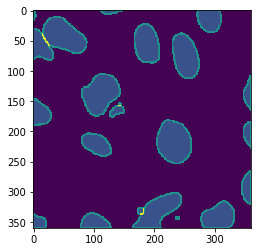

In [27]:
plt.imshow(mc_one_mask)
plt.show()

In [28]:
image_p, mask_p, mc_mask = ("/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/images/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c.png",
                            "/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/one_mask.png",
                            "/home/biswajit/Documents/bima/unet/data/train/2869fad54664677e81bacbf00c2256e89a7b90b69d9688c9342e2c736ff5421c/multiclass_mask.png")

In [29]:
mclass_mask = cv2.imread(mc_mask, cv2.IMREAD_GRAYSCALE)

In [30]:
mclass_mask.shape

(360, 360)

In [31]:
np.unique(mclass_mask)

array([ 30, 102, 215], dtype=uint8)

In [32]:
bc = (mclass_mask == 30)*1
fc = (mclass_mask == 110)*1
cc = (mclass_mask == 215)*1
mc_out = np.dstack([bc, fc, cc])
mc_out = mc_out.astype(np.uint8) 

In [33]:
print(mc_out.shape)

(360, 360, 3)


(3, 256, 256)


TypeError: Invalid dimensions for image data

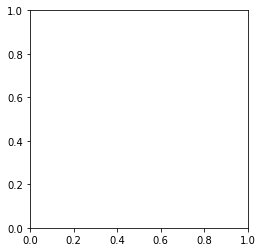

In [34]:
#img = plt.imread(img_contours, cv2.IMREAD_GRAYSCALE)
mask3d = transforms.fix_resize_transform(mc_out, 256, 256) 
mask3d = (mask3d.transpose((2,0,1)))
print(mask3d.shape)
plt.imshow(mask3d)
plt.show()

In [91]:
def elastic_transform(image, alpha, sigma, alpha_affine, random_state=None):
    """Elastic deformation of images as described in [Simard2003]_ (with modifications).
    .. [Simard2003] Simard, Steinkraus and Platt, "Best Practices for
         Convolutional Neural Networks applied to Visual Document Analysis", in
         Proc. of the International Conference on Document Analysis and
         Recognition, 2003.

     Based on https://gist.github.com/erniejunior/601cdf56d2b424757de5
    """
    if random_state is None:
        random_state = np.random.RandomState(None)

    print(image.shape)
    shape = image.shape
    shape_size = shape[:2]
    
    # Random affine
    center_square = np.float32(shape_size) // 2
    square_size = min(shape_size) // 3
    pts1 = np.float32([center_square + square_size, [center_square[0]+square_size, center_square[1]-square_size],
                       center_square - square_size])
    pts2 = pts1 + random_state.uniform(-alpha_affine, alpha_affine, size=pts1.shape).astype(np.float32)
    M = cv2.getAffineTransform(pts1, pts2)
    image = cv2.warpAffine(image, M, shape_size[::-1], borderMode=cv2.BORDER_REFLECT_101)

    dx = gaussian_filter((random_state.rand(*shape) * 2 - 1), sigma) * alpha
    dy = gaussian_filter((random_state.rand(*shape) * 2 - 1), sigma) * alpha
    dz = np.zeros_like(dx)

    x, y, z = np.meshgrid(np.arange(shape[1]), np.arange(shape[0]), np.arange(shape[2]))
    indices = np.reshape(y+dy, (-1, 1)), np.reshape(x+dx, (-1, 1)), np.reshape(z, (-1, 1))

    return map_coordinates(image, indices, order=1, mode='reflect').reshape(shape)

In [92]:
# Define function to draw a grid
def draw_grid(im, grid_size):
    # Draw grid lines
    for i in range(0, im.shape[1], grid_size):
        cv2.line(im, (i, 0), (i, im.shape[0]), color=(255,))
    for j in range(0, im.shape[0], grid_size):
        cv2.line(im, (0, j), (im.shape[1], j), color=(255,))

# Load images
im = cv2.imread(image_p)
im_mask = cv2.imread(mask_p)

# Draw grid lines
draw_grid(im, 50)
draw_grid(im_mask, 50)

# Merge images into separete channels (shape will be (cols, rols, 2))
#im_merge = np.concatenate((im[...,None], im_mask[...,None]), axis=2)

In [93]:
# Apply transformation on image
im_merge_t = elastic_transform(im_merge, im_merge.shape[1] * 2, im_merge.shape[1] * 0.08, im_merge.shape[1] * 0.08)

# Display result
plt.figure(figsize = (16,14))
plt.imshow(im_merge_t, cmap='gray')

(360, 360, 6, 1)


error: OpenCV(3.4.2) /io/opencv/modules/imgproc/src/imgwarp.cpp:2610: error: (-215:Assertion failed) src.cols > 0 && src.rows > 0 in function 'warpAffine'
